# Obligatorio - Taller de Deep Learning

**Fecha de entrega:** 3/12/2025  
**Puntaje máximo:** 50 puntos

**Alumno(s):** Natialia Campiglia - Maria Jose Carbajal

## Obligatorio

El objetivo de este obligatorio es evaluar su conocimiento en Deep Learning mediante la implementación completa de un modelo de segmentación de imágenes basado en el paper [**"U-Net: Convolutional Networks for Biomedical Image Segmentation"**](https://arxiv.org/pdf/1505.04597). Toda la implementación debe realizarse desde cero utilizando PyTorch, y los estudiantes tendrán la libertad de ajustar ciertos hiperparámetros y configuraciones mientras mantengan la esencia del paper original.

### **Competencia en Kaggle**

Además, como parte de este obligatorio, participarán en una competencia privada en Kaggle donde se les proporcionará un dataset de test oculto (sin target). Deberán subir sus predicciones a Kaggle y se evaluarán en función de la métrica **Dice Coefficient (Coeficiente de Dice)**. Esta competencia les permitirá comparar sus resultados con los de sus compañeros en un entorno real de evaluación.

### **¿Qué es el Dice Coefficient?**
El **Dice Coefficient**, también conocido como F1-score para segmentación, es una métrica utilizada para evaluar la similitud entre la predicción y la verdad del terreno en tareas de segmentación. Se define de la siguiente manera:

$$
\text{Dice} = \frac{2 \cdot |A \cap B|}{|A| + |B|}
$$

Donde:
- $A$ es el conjunto de píxeles predichos como pertenecientes a la clase positiva.
- $B$ es el conjunto de píxeles verdaderos pertenecientes a la clase positiva.
- $|A \cap B|$ es la intersección de $A$ y $B$, es decir, los píxeles correctamente predichos como positivos.

Un valor de Dice de **1** indica una predicción perfecta, mientras que un valor de **0** indica que no hay coincidencia entre la predicción y el valor verdadero. Durante la competencia de Kaggle, deberán obtener un puntaje de al menos **0.75** en la métrica Dice para considerarse aprobados.

### **Criterios a Evaluar**

1. **Análisis del Dataset (5 puntos):**
   - Exploración y visualización del dataset para comprender su estructura y características.
   - Justificación de las decisiones tomadas en la preprocesamiento de datos, como normalización, aumento de datos (data augmentation), y partición del dataset en conjuntos de entrenamiento, validación y prueba.

2. **Implementación Correcta del Modelo U-Net (20 puntos):**
   - Construcción de la arquitectura U-Net siguiendo la estructura descrita en el paper, permitiendo ajustes como el número de filtros, funciones de activación y métodos de inicialización de pesos.
   - Se aceptan mejoras como el uso de técnicas adicionales como batch normalization, otras funciones de activación, etc.

3. **Entrenamiento del Modelo (10 puntos):**
   - Configuración adecuada del ciclo de entrenamiento, incluyendo la elección de la función de pérdida y del optimizador (Adam, SGD, etc.).
   - Uso de técnicas de regularización para mejorar la generalización del modelo, como el dropout, normalización de batch y data augmentation.
   - Gráficas y análisis de la evolución del entrenamiento, mostrando las curvas de pérdida y métricas relevantes tanto en el conjunto de entrenamiento como en el de validación.
   - Puede utilizarse experimentación con hiperparámetros con Weights & Biases (W&B) para optimizar el rendimiento del modelo. Este punto no es obligatorio, pero se valorará positivamente si se justifica su uso y se presentan resultados claros.

4. **Evaluación de Resultados (10 puntos):**
   - Evaluación exhaustiva del modelo utilizando métricas de segmentación como **Dice Coefficient**.
   - Análisis detallado de los resultados, incluyendo un análisis de errores para identificar y discutir casos difíciles.
   - Visualización de ejemplos representativos de segmentaciones correctas e incorrectas, comparando con las etiquetas manuales proporcionadas en el dataset.

5. **Participación y Resultados en la Competencia Kaggle (5 puntos):**
   - Participación activa en la competencia de Kaggle, con al menos una (1) subida de predicción.
   - Puntaje obtenido en la tabla de posiciones de Kaggle, evaluado en base al **Dice Coefficient** en el conjunto de test oculto. Es necesario obtener al menos un valor de **0.75** para esta métrica.

   Notas:
   - **Cualquier decisión debe ser justificada en el notebook.**
   - El **Dice Coefficient** es la métrica utilizada para evaluar la precisión de los modelos de segmentación de imágenes en esta competencia.

### **Run-Length Encoding (RLE)**

Dado que no se suben las imágenes segmentadas directamente a Kaggle, se requiere usar **Run-Length Encoding (RLE)** para comprimir las máscaras de predicción en una cadena de texto que será evaluada. El **RLE** es una técnica de compresión donde se representan secuencias consecutivas de píxeles en formato `start length`, indicando la posición de inicio y la longitud de cada secuencia de píxeles positivos.

Para calcular el **RLE**, se sigue el siguiente proceso:

1. Se aplanan las máscaras predichas en un solo vector
2. Se identifican los píxeles con valor positivo (1) y se calculan las secuencias consecutivas.
3. Se registra la posición de inicio de cada secuencia y su longitud en formato `start length`.

Este formato comprimido se sube a Kaggle en lugar de las imágenes segmentadas.

#### **Ejemplo de RLE**

```python
import numpy as np

def rle_encode(mask):
    pixels = np.array(mask).flatten(order='F')  # Aplanar la máscara en orden Fortran
    pixels = np.concatenate([[0], pixels, [0]])  # Añadir ceros al principio y final
    runs = np.where(pixels[1:] != pixels[:-1])[0] + 1  # Encontrar transiciones
    runs[1::2] = runs[1::2] - runs[::2]  # Calcular longitudes
    return ' '.join(str(x) for x in runs)

mask = np.array([[0, 0, 1, 0, 0],
                 [0, 1, 1, 1, 0],
                 [1, 1, 1, 0, 0],
                 [0, 0, 0, 1, 1]])

print(rle_encode(mask))
```

> **Salida:** 3 1 6 2 9 3 14 1 16 1 20 1


### **Sobre el Dataset**

El dataset proporcionado para esta tarea incluirá imágenes y máscaras para la segmentación de un conjunto específico de clases. El conjunto de entrenamiento estará disponible para su uso durante todo el proceso de desarrollo y pruebas, mientras que el conjunto de validación se mantendrá oculto para la evaluación final en Kaggle.

### **Instrucciones de Entrega**

- Deberán entregar un Jupyter Notebook (.ipynb) que contenga todo el código y las explicaciones necesarias para ejecutar la implementación, el entrenamiento y la evaluación del modelo.
- El notebook debe incluir secciones bien documentadas explicando las decisiones de diseño del modelo, los experimentos realizados, y los resultados obtenidos.
- El código debe estar escrito de manera clara.
- La entrega debe realizarse a través de la plataforma de gestión de ORT (gestion.ort.edu.uy) antes de la fecha límite.

### **Materiales Adicionales**

Para facilitar su trabajo, pueden consultar los siguientes recursos:

- [U-Net: Convolutional Networks for Biomedical Image Segmentation (paper original)](https://arxiv.org/abs/1505.04597)
- [Documentación de PyTorch](https://pytorch.org/docs/stable/index.html)
- [Tutoriales y recursos adicionales en Kaggle](https://www.kaggle.com/)
- [Convolución Transpuesta](https://d2l.ai/chapter_computer-vision/transposed-conv.html)

### **Competencia Kaggle**

[Link a la competencia Kaggle](https://www.kaggle.com/competitions/tdl-obligatorio-2025)

---

# Integrantes del grupo

Natalia Campiglia - 349251

Maria Jose Carbajal - 241319

# Imports e inicializaciones

In [1]:
!pip install kaggle
!pip install torchinfo

In [67]:
import os, json, random
import hashlib

import matplotlib.pyplot as plt
import numpy as np
import math

from PIL import Image
from pathlib import Path

from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

import torch
import torch.nn as nn
import torch.nn.functional as F

from torchinfo import summary

import torchvision.transforms.v2 as T
from torchvision import tv_tensors
from torchvision.transforms import InterpolationMode


from torch.utils.data import random_split, DataLoader, Dataset, Subset


from utils import (
    train,
    plot_training,
    plot_confusion_matrix,
    print_metrics_report,
    predict_and_build_submission,
    match_output_to_dim,
    restaurar_modelo,
    dice_on_val_with_postproc,

    predict_and_build_submission_tta
)

### Reload imports sin necesidad de restart la notebook

In [65]:
import importlib
import sys
if 'utils' in sys.modules:
    importlib.reload(sys.modules['utils'])

In [4]:
# Fijamos la semilla para que los resultados sean reproducibles
SEED = 23

torch.manual_seed(SEED)
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False


In [5]:
import sys

# definimos el dispositivo que vamos a usar
DEVICE = "cpu"  # por defecto, usamos la CPU
if torch.cuda.is_available():
    DEVICE = "cuda"  # si hay GPU, usamos la GPU
elif torch.backends.mps.is_available():
    DEVICE = "mps"  # si no hay GPU, pero hay MPS, usamos MPS
elif torch.xpu.is_available():
    DEVICE = "xpu"  # si no hay GPU, pero hay XPU, usamos XPU

print(f"Usando {DEVICE}")

NUM_WORKERS = 0 # Win y MacOS pueden tener problemas con múltiples workers
if sys.platform == 'linux':
    NUM_WORKERS = 4  # numero de workers para cargar los datos (depende de cada caso)

print(f"Usando {NUM_WORKERS}")

Usando cuda
Usando 4


## Constantes

In [6]:
BATCH_SIZE = 8  # tamaño del batch
IMG_SIZE = 256 # paper original: 572
NUM_CLASES = 1

IMG_FOLDER = "data/train/images"
MASK_FOLDER = "data/train/masks"
TEST_FOLDER = "data/test/images"

# Dataset

In [7]:
with open("config/kaggle.json") as f:
    creds = json.load(f)

os.environ["KAGGLE_USERNAME"] = creds["username"]
os.environ["KAGGLE_KEY"] = creds["key"]

In [8]:
!kaggle competitions download -c tdl-obligatorio-2025

tdl-obligatorio-2025.zip: Skipping, found more recently modified local copy (use --force to force download)


In [9]:
!unzip -o -qq tdl-obligatorio-2025.zip -d data/

# Exploración de datos

## Ver selección random de imágenes y sus máscaras

3 (800, 800, 3)
3 (800, 800, 3)
3 (800, 800, 3)
3 (800, 800, 3)
3 (800, 800, 3)
3 (800, 800, 3)
3 (800, 800, 3)
3 (800, 800, 3)


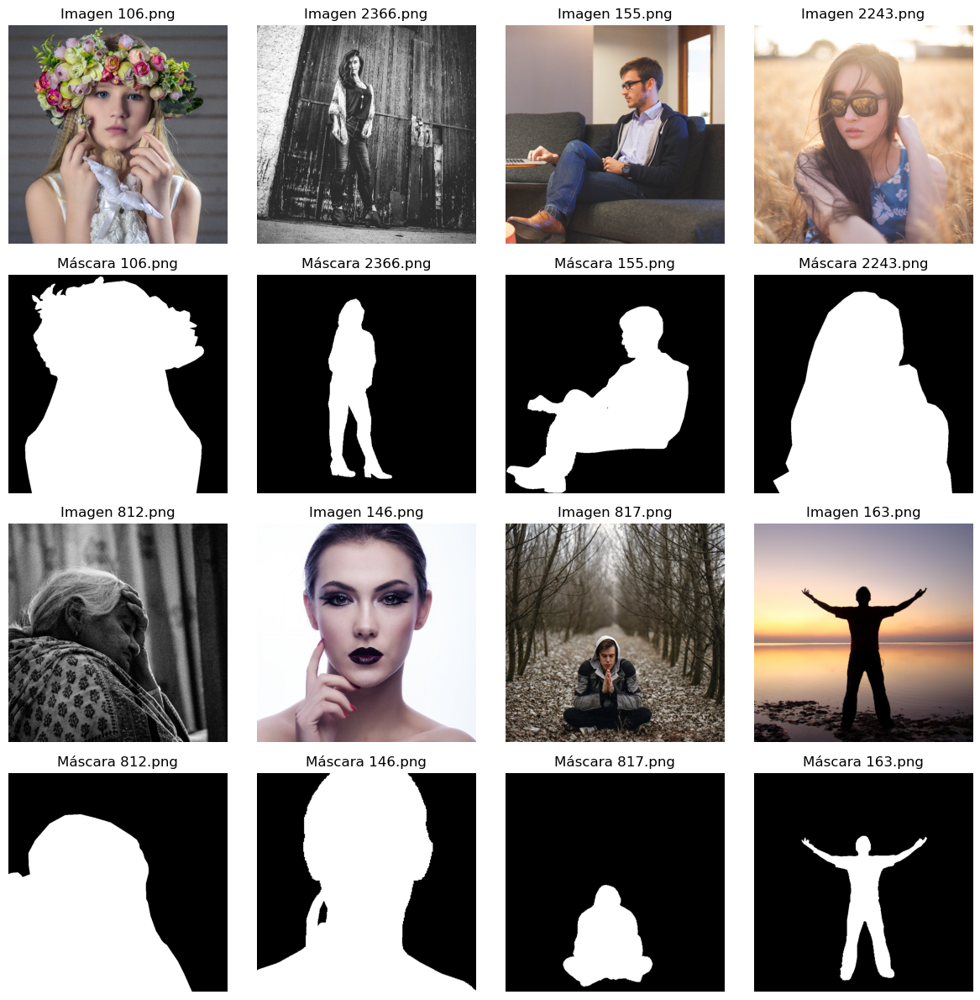

In [ ]:
files = random.sample(os.listdir(IMG_FOLDER), 8)  # 8 imágenes → 4 filas de pares

MASK = None

plt.figure(figsize=(12, 12))
for i, f in enumerate(files):
    img = Image.open(os.path.join(IMG_FOLDER, f))
    mask_path = os.path.join(MASK_FOLDER, f)
    mask = np.array(Image.open(mask_path))
    print(mask.ndim,mask.shape)
    if mask.ndim == 3:
        mask = mask.max(axis=2)

    MASK = mask

    # Fila 1 y 3: imágenes (i=0..3 e i=4..7)
    if i < 4:
        plt.subplot(4, 4, i + 1)
        plt.imshow(img)
        plt.axis("off")
        plt.title(f"Imagen {f}")
        plt.subplot(4, 4, i + 1 + 4)
        plt.imshow(mask, cmap="gray", vmin=0, vmax=1)
        plt.axis("off")
        plt.title(f"Máscara {f}")
    else:
        j = i - 4
        plt.subplot(4, 4, j + 1 + 8)
        plt.imshow(img)
        plt.axis("off")
        plt.title(f"Imagen {f}")
        plt.subplot(4, 4, j + 1 + 12)
        plt.imshow(mask, cmap="gray", vmin=0, vmax=1)
        plt.axis("off")
        plt.title(f"Máscara {f}")

plt.tight_layout()
plt.show()


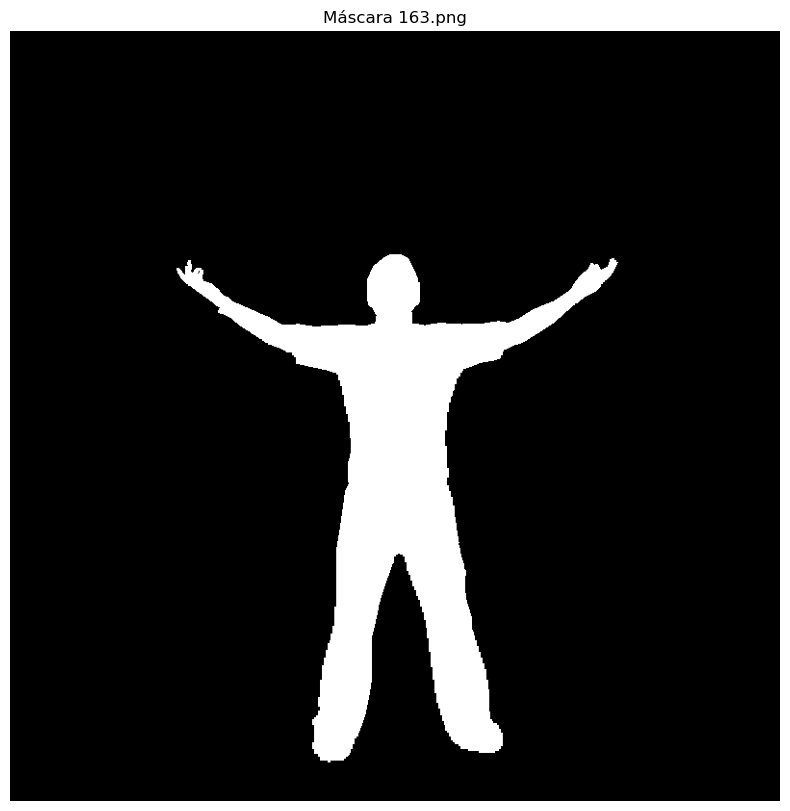

INFORMACIÓN DE LA MATRIZ DE PÍXELES
Forma de la matriz (shape): (800, 800)
Dimensiones de la matriz: 2
Tipo de datos (dtype): uint8
Valor mínimo: 0
Valor máximo: 1
Valor promedio: 0.0959
Valores únicos: [0 1]

Primeros 20x20 píxeles de la matriz:
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]

Últimos 20x20 píxeles de la matriz:
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]


In [ ]:
# quiero mostrar una mascara y su matriz de pixeles
plt.figure(figsize=(10, 10))
plt.imshow(MASK, cmap="gray", vmin=0, vmax=1)
plt.axis("off")
plt.title(f"Máscara {f}")
plt.show()

# Mostrar información sobre la matriz de píxeles
print("=" * 60)
print("INFORMACIÓN DE LA MATRIZ DE PÍXELES")
print("=" * 60)
print(f"Forma de la matriz (shape): {MASK.shape}")
# dim
print(f"Dimensiones de la matriz: {MASK.ndim}")
print(f"Tipo de datos (dtype): {MASK.dtype}")
print(f"Valor mínimo: {MASK.min()}")
print(f"Valor máximo: {MASK.max()}")
print(f"Valor promedio: {MASK.mean():.4f}")
print(f"Valores únicos: {np.unique(MASK)}")
print(f"\nPrimeros 20x20 píxeles de la matriz:")
print(MASK[:50, :50])
print(f"\nÚltimos 20x20 píxeles de la matriz:")
print(MASK[-50:, -50:])


## Ver tamaños de imágenes y máscaras

In [ ]:
sizes = set()
for fname in os.listdir(IMG_FOLDER):
    if 'png' in fname:
        path = os.path.join(IMG_FOLDER, fname)
        with Image.open(path) as img:
            sizes.add(img.size)

print("Tamaño de imagenes:")
for size in sizes:
    print(size)

sizes = set()
for fname in os.listdir(MASK_FOLDER):
    if 'png' in fname:
        path = os.path.join(MASK_FOLDER, fname)
        with Image.open(path) as img:
            sizes.add(img.size)

print("Tamaño de máscaras:")
for size in sizes:
    print(size)

Tamaño de imagenes:
(800, 800)
Tamaño de máscaras:
(800, 800)


Confirmamos que todas las imágenes y las máscaras tienen el mismo tamaño.

## Buscar duplicados

In [ ]:
def md5_file(path: Path):
    with path.open("rb") as f:
        return hashlib.md5(f.read()).hexdigest()

hashes = {}
duplicates = []

folder = Path(IMG_FOLDER)

for path in folder.iterdir():
    if path.is_file():
        h = md5_file(path)
        if h in hashes:
            duplicates.append((str(path), str(hashes[h])))
        else:
            hashes[h] = path

print(f"Encontradas {len(duplicates)} imágenes duplicadas.")

Encontradas 0 imágenes duplicadas.


## Formato y canales

In [ ]:
img_dir = Path(IMG_FOLDER)
mask_dir = Path(MASK_FOLDER)

img_channel_counts = set()
mask_channel_counts = set()
mask_unique_values = set()

for img_path, mask_path in zip(sorted(img_dir.iterdir()), sorted(mask_dir.iterdir())):
    if img_path.suffix.lower() not in [".jpg", ".png", ".jpeg"]:
        continue

    # Imagen
    # escala de grises: (hight, width) -> 1 canal
    # RGB: (hight, width, channels) = (height, width, 3) -> 3 canales
    # RGBA: (hight, width, 4)
    try:
        img = np.array(Image.open(img_path))
        img_channels = 1 if img.ndim == 2 else img.shape[2]
        img_channel_counts.add(img_channels)

        # Máscara
        mask = np.array(Image.open(mask_path))
        mask_channels = 1 if mask.ndim == 2 else mask.shape[2]
        mask_channel_counts.add(mask_channels)

        # Valores únicos de cada máscara (agrega como tupla)
        mask_unique_values.add(tuple(np.unique(mask)))
    except:
        pass

print(f"Canales únicos en imágenes: {img_channel_counts}")
print(f"Canales únicos en máscaras: {mask_channel_counts}")
print(f"Conjuntos de valores únicos en máscaras: {mask_unique_values}")

Canales únicos en imágenes: {1, 3, 4}
Canales únicos en máscaras: {3}
Conjuntos de valores únicos en máscaras: {(np.uint8(0), np.uint8(1)), (np.uint8(1),)}


Las máscaras son todas RGB pero para para las imágenes tenemos en formato blanco y negro, RGB y RGBA.

EL RGBA es como RGB más informacion de transparencia de la imagen; este 4to canal no nos aporta información util para este problema.

Para que las imagenes tengan todas la misma cantidad de canales a la entrada de la red, decidimos pasarlas todas a RGB porque RGBA no aporta más información y pasarlo a blanco y negro nos hace perder colores e intensidad que podrian ayudar al modelo a distinguir la persona del fondo.

## Mean y STD

In [10]:
paths = [os.path.join(IMG_FOLDER, f) for f in os.listdir(IMG_FOLDER) if f.lower().endswith(('.png','.jpg','.jpeg','.bmp','.tif','.tiff'))]

# Función de carga forzada a RGB porque algunas estan en RGBA o blanco y negro (L)
def load_rgb(path):
    im = Image.open(path)
    if im.mode != 'RGB':
        im = im.convert('RGB')
    return im

# Media/STD por canal con acumulacion
sum_c = torch.zeros(3, dtype=torch.float64)
sum_sq_c = torch.zeros(3, dtype=torch.float64)
pix_count_c = torch.zeros(3, dtype=torch.float64)

for p in paths:
    try:
        im = load_rgb(p)
        arr = torch.from_numpy(np.asarray(im))  # H x W x 3, uint8
        t = arr.permute(2,0,1).to(torch.float64) / 255.0  # 3 x H x W , [0,1]

        # acumula por canal suma y suma de los cuadrados
        csum = t.view(3, -1).sum(dim=1)
        csum_sq = (t**2).view(3, -1).sum(dim=1)
        n_pix = torch.tensor([t.shape[1]*t.shape[2]]*3, dtype=torch.float64)

        sum_c += csum
        sum_sq_c += csum_sq
        pix_count_c += n_pix
    except Exception as e:
        pass

MEAN_RGB = (sum_c / pix_count_c).to(torch.float32)
STD_RGB = torch.sqrt((sum_sq_c / pix_count_c) - MEAN_RGB.double()**2).to(torch.float32)

print("mean =", MEAN_RGB.tolist(), "std =", STD_RGB.tolist())

mean = [0.5149781107902527, 0.4839880168437958, 0.4597202241420746] std = [0.31370314955711365, 0.3028314411640167, 0.30339837074279785]


**MEAN:**

Los tres canales tienen valores similares por lo que no hay un color que sea mas dominante que otro.

Los valores estan al rededor del 50% lo que indica que las imagenes tienen una exposicion a la luz pareja.

El rojo aparece un poco mas intenso que los demás.

**STD:**

El STD en este caso mide cuánto varía la intensidad de los pixeles en cada canal.

Por lo que vemos, la variacion para los 3 canales es similar. Un valor de 0.3 nos indica que hay bastante variedad de tonos e intensidades; esto probablemente se deba a que las imagenes tienen zonas claras y oscuras, sombras, piel, ropa, y diversos fondos.

## Histograma de colores en las imágenes

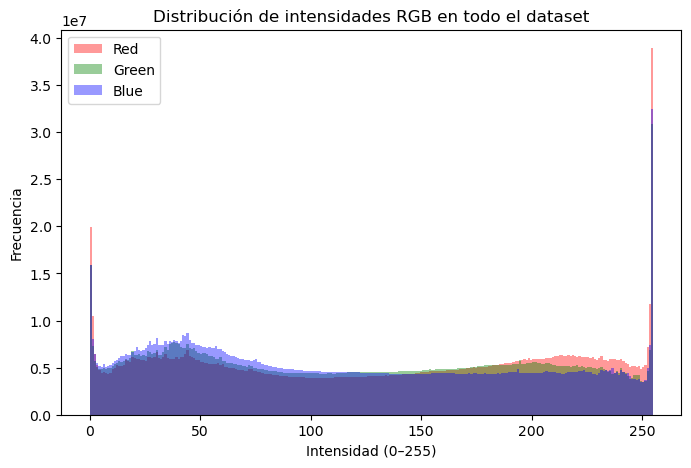

In [ ]:
folder = Path(IMG_FOLDER)

# Acumuladores de cada canal
r_vals, g_vals, b_vals = [], [], []

for p in folder.iterdir():
    if p.suffix.lower() not in [".jpg", ".jpeg", ".png"]:
        continue
    img = np.array(Image.open(p).convert("RGB"))
    # achatar para juntar todos los píxeles
    r, g, b = img[..., 0].ravel(), img[..., 1].ravel(), img[..., 2].ravel()
    r_vals.append(r)
    g_vals.append(g)
    b_vals.append(b)

# concatenar todos los valores
r_vals = np.concatenate(r_vals)
g_vals = np.concatenate(g_vals)
b_vals = np.concatenate(b_vals)

# histograma combinado
plt.figure(figsize=(8,5))
plt.hist(r_vals, bins=256, color='r', alpha=0.4, label='Red')
plt.hist(g_vals, bins=256, color='g', alpha=0.4, label='Green')
plt.hist(b_vals, bins=256, color='b', alpha=0.4, label='Blue')
plt.legend()
plt.title("Distribución de intensidades RGB en todo el dataset")
plt.xlabel("Intensidad (0–255)")
plt.ylabel("Frecuencia")
plt.show()


Los picos en 0 y 255 indican que hay muchos píxeles completamente negros o completamente blancos.

Entre los extremos, vemos que la densidad es relativamente plana, lo que indica amplia variación en los colores.

Las curvas roja, verde y azul son muy similares por lo que vemos que los colores están bastante balanceados en las imagenes del dataset.

## Analizar qué porcentaje de la imagen es ocupado por la persona

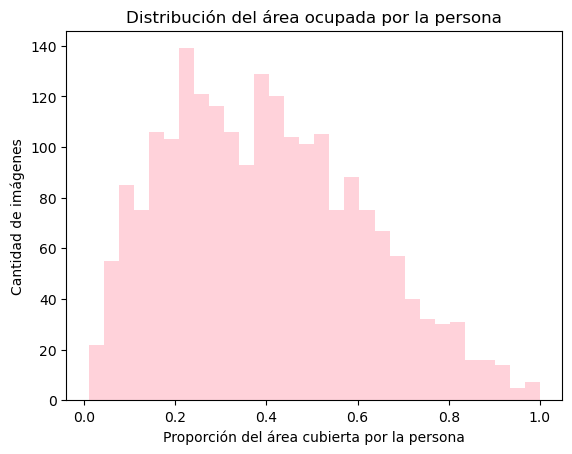

Cobertura promedio: 0.399
Rango: 0.010 – 1.000


In [ ]:
mask_dir = Path(MASK_FOLDER)

coverages = [] # cantidad de pixeles identificados como persona

for p in mask_dir.glob("*.png"):
    mask = np.array(Image.open(p))[:, :, 0]   # un canal, valores {0,1}
    h, w = mask.shape
    coverage = mask.sum() / (h * w)
    coverages.append(coverage)

coverages = np.array(coverages)

plt.hist(coverages, bins=30, color='pink', alpha=0.7)
plt.xlabel("Proporción del área cubierta por la persona") # 0 nada , 1 toda la imagen
plt.ylabel("Cantidad de imágenes")
plt.title("Distribución del área ocupada por la persona")
plt.show()

print(f"Cobertura promedio: {coverages.mean():.3f}")
print(f"Rango: {coverages.min():.3f} – {coverages.max():.3f}")


Podemos ver que en la mayoría de los casos, la persona ocupa el 40% de la imagen, es decir, el 60% de la imagen es el fondo.

Encontradas: 31 imágenes con cobertura <= 0.050


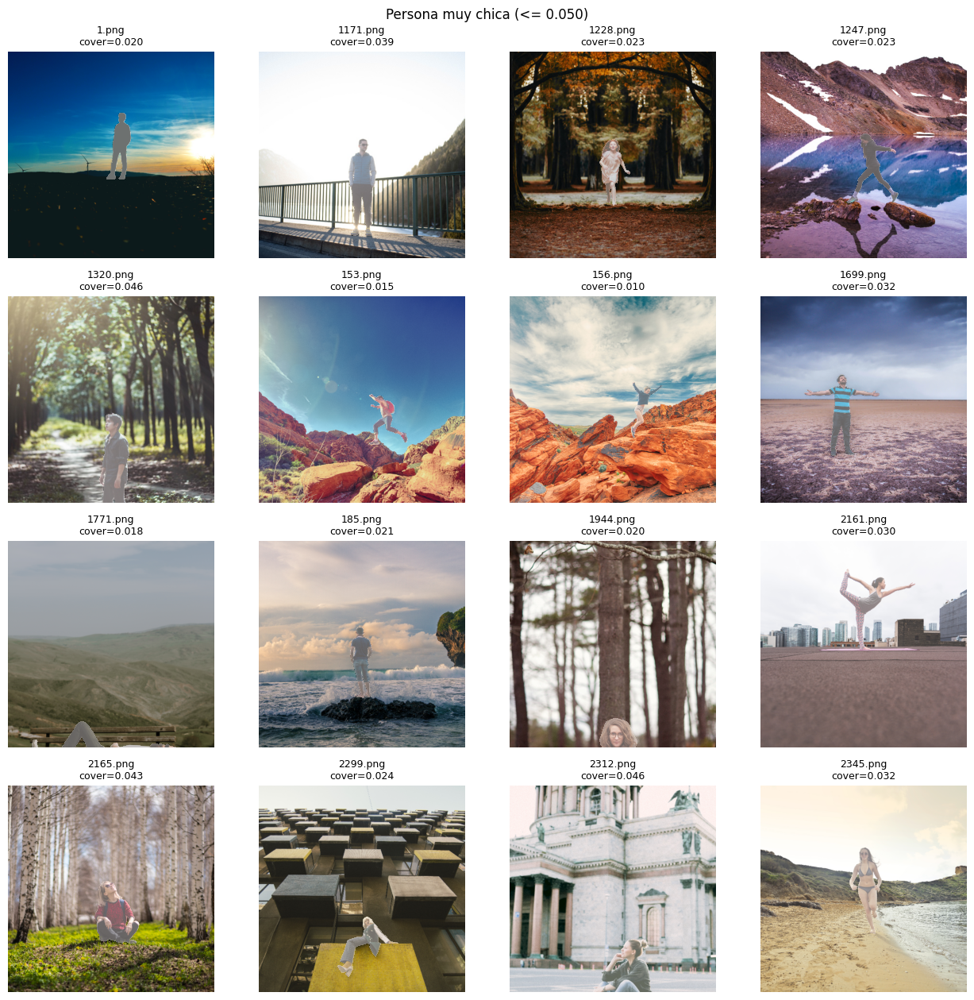

Encontradas: 51 imágenes con cobertura >= 0.850


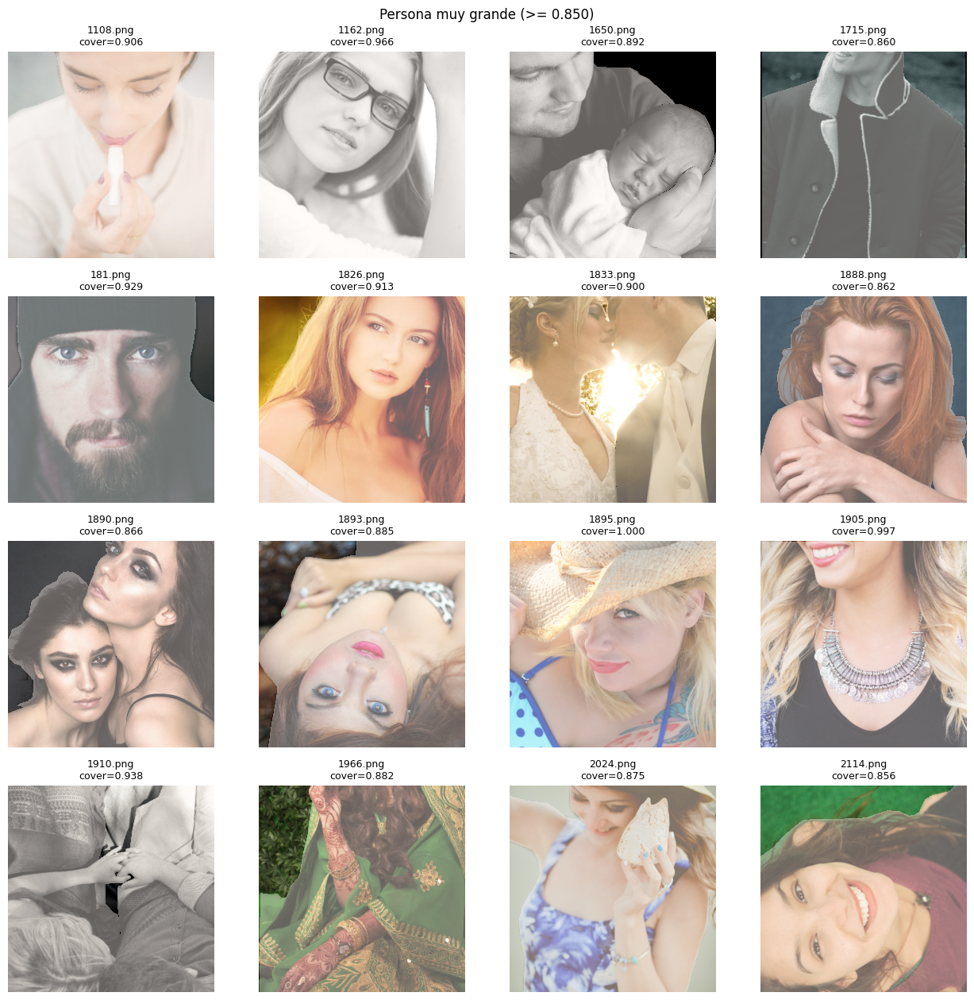

In [14]:
def _read_mask(path):
    m = np.array(Image.open(path))
    if m.ndim == 3:
        m = m[:, :, 0]
    m = (m > 0).astype(np.uint8)
    return m  # HxW en {0,1}

def _read_rgb(path):
    im = Image.open(path)
    if im.mode != "RGB":
        im = im.convert("RGB")
    return np.array(im)      # HxWx3 uint8

def _coverage(mask):
    h, w = mask.shape
    return float(mask.sum()) / float(h * w + 1e-9)

def _build_image_index(image_dir):
    image_dir = Path(image_dir)
    idx = {}
    for p in image_dir.rglob("*"):
        if p.suffix.lower() in {".png",".jpg",".jpeg",".tif",".tiff",".bmp"}:
            idx[p.stem] = p
    return idx

def _overlay(ax, img, mask, alpha=0.35):
    ax.imshow(img)
    ax.imshow(np.where(mask>0, 1.0, np.nan), cmap="Reds", alpha=alpha, interpolation="nearest")
    ax.axis("off")

# persona muy chica (cobertura <= max_frac)

def find_small_person_with_overlay(mask_dir, image_dir, max_frac=0.10, sample_show=12, cols=4, alpha=0.35):
    mask_dir = Path(mask_dir)
    image_idx = _build_image_index(image_dir)

    matches, fracs = [], []
    paths = sorted([p for p in mask_dir.rglob("*") if p.suffix.lower() in {".png",".jpg",".jpeg",".tif",".tiff",".bmp"}])

    for mp in paths:
        m = _read_mask(mp)
        f = _coverage(m)
        if f <= max_frac:
            if mp.stem in image_idx:
                matches.append((image_idx[mp.stem], mp))
                fracs.append(f)

    print(f"Encontradas: {len(matches)} imágenes con cobertura <= {max_frac:.3f}")

    if matches:
        k = min(sample_show, len(matches))
        rows = math.ceil(k / cols)
        plt.figure(figsize=(3.2*cols, 3.2*rows))
        for i, (ip, mp) in enumerate(matches[:k]):
            img = _read_rgb(ip); m = _read_mask(mp)
            ax = plt.subplot(rows, cols, i+1)
            _overlay(ax, img, m, alpha=alpha)
            ax.set_title(f"{ip.name}\ncover={_coverage(m):.3f}", fontsize=9)
        plt.suptitle(f"Persona muy chica (<= {max_frac:.3f})")
        plt.tight_layout()
        plt.show()

    return matches, fracs  # lista de (image_path, mask_path), y coberturas


# persona muy grande (cobertura >= min_frac)

def find_large_person_with_overlay(mask_dir, image_dir, min_frac=0.80, sample_show=12, cols=4, alpha=0.35):
    mask_dir = Path(mask_dir)
    image_idx = _build_image_index(image_dir)

    matches, fracs = [], []
    paths = sorted([p for p in mask_dir.rglob("*") if p.suffix.lower() in {".png",".jpg",".jpeg",".tif",".tiff",".bmp"}])

    for mp in paths:
        m = _read_mask(mp)
        f = _coverage(m)
        if f >= min_frac:
            if mp.stem in image_idx:
                matches.append((image_idx[mp.stem], mp))
                fracs.append(f)

    print(f"Encontradas: {len(matches)} imágenes con cobertura >= {min_frac:.3f}")

    if matches:
        k = min(sample_show, len(matches))
        rows = math.ceil(k / cols)
        plt.figure(figsize=(3.2*cols, 3.2*rows))
        for i, (ip, mp) in enumerate(matches[:k]):
            img = _read_rgb(ip); m = _read_mask(mp)
            ax = plt.subplot(rows, cols, i+1)
            _overlay(ax, img, m, alpha=alpha)
            ax.set_title(f"{ip.name}\ncover={_coverage(m):.3f}", fontsize=9)
        plt.suptitle(f"Persona muy grande (>= {min_frac:.3f})")
        plt.tight_layout()
        plt.show()

    return matches, fracs

# alpha transparencia con la que se superpone imagen y mascara

small, small_fracs = find_small_person_with_overlay(
    mask_dir=MASK_FOLDER, image_dir=IMG_FOLDER,
    max_frac=0.05, sample_show=16, cols=4, alpha=0.4
)

large, large_fracs = find_large_person_with_overlay(
    mask_dir=MASK_FOLDER, image_dir=IMG_FOLDER,
    min_frac=0.85, sample_show=16, cols=4, alpha=0.4
)


## Conclusión de la exploración de datos

El conjunto de datos presenta imagenes y máscaras del mismo tamaño (800×800 px) y sin duplicados.

Las máscaras son todas RGB, mientras que las imágenes originales poseen entre 1, 3 y 4 canales. El canal adicional de las imágenes RGBA corresponde a transparencia, que no aporta información útil para la segmentación; por lo tanto, se decidió convertir todas las imágenes a RGB para unificar la entrada de la red y conservar la información de color relevante. De todas maneras, se probará primero con imagenes de entrada en blanco y negro para ser fieles al paper.

Los valores de MEAN y STD por canal son similares entre sí, confirmando buen balance de colores y bastante variabilidad en intensidades. El histograma de intensidades refuerza estas observaciones, demostrando que el dataset no tiene sesgos de color.

El análisis del espacio ocupado por la persona en la imagen demuestra una ocupación promedio del 40%, con un rango de 0.01 a 1. Esto significa que hay gran variación de escala de personas en las imágenes, donde encontramos tanto primeros planos como imagenes donde la persona está muy chica y es casi todo fondo.

En conclusión, el dataset está balanceado en términos de color y es diverso, lo que es adecuado para entrenar un modelo de segmentación.
Antes del entrenamiento, se deben normalizar las imágenes con los valores calculados de MEAN y STD.

Vamos a probar entrenar con un mínimo de transformaciones para empezar.

Luego veremos si el resultado mejora al aplicar data augmentation, ya que la variabilidad que hay en nuestro dataset ayuda a generalizar pero también hace que sea dificil de aprender.

# Data loaders

El dataset contiene una carpeta train, con imagenes y máscaras, y una carpeta test, solamente con imagenes.

Para poder entrenar y generar métricas, dividiremos la carpeta de train en train/val/test_local con una proporción de 80%/10%/10%.

Definimos la clase SegDataset para generar train/val/test_local manteniendo los pares (imagen, mascara).

Aplicar las transforms aleatorias a mascara e imagen por separado da PROBLEMAS. Por eso definimos un joint transform par aplicar data augmentation, y a los data loaders solo les pasamos la transform base que seria img_rgb o img_simple segun el caso.

In [ ]:
def load_image(path, rgb):
    #  "L" convierte a escala de grises
    img = Image.open(path).convert("RGB" if rgb else "L")
    arr = np.array(img, dtype=np.float32) / 255.0  # (H, W, 3) o (H, W)

    if rgb:
        # pasar de (H, W, 3) → (3, H, W)
        arr = np.transpose(arr, (2, 0, 1))
    else:
        # pasar de (H, W) → (1, H, W)
        arr = np.expand_dims(arr, axis=0)

    tensor = torch.from_numpy(arr)
    return tensor

In [ ]:
class SegDataset(Dataset):
    """
    Lee pares (imagen, máscara) desde:
      root/images/*.png|jpg...
      root/masks/  con el mismo nombre de archivo
    Devuelve tensores: img -> float32 [0,1], (C,H,W); mask -> long (H,W)
    """

    def __init__(self, transform_img=None, transform_mask=None, joint_transform=None, rgb=False):
        self.images_path = Path(IMG_FOLDER)
        self.masks_path = Path(MASK_FOLDER)
        self.transform_img = transform_img  # post (dtype, normalize, etc.)
        self.transform_mask = transform_mask  # post (dtype)
        self.joint_transform = joint_transform  # geom/augment compartida
        self.rgb = rgb

        # Emparejar por nombre
        img_files = sorted([p for p in self.images_path.iterdir() if p.is_file()])
        names = []
        for p in img_files:
            mask_p = self.masks_path / p.name
            if mask_p.exists():
                names.append(p.name)
        if not names:
            raise RuntimeError(f"No se encontraron pares imagen-máscara en {self.images_path} y {self.masks_path}")

        self.names = names  # lista de nombres emparejados

    def __len__(self):
        return len(self.names)

    def _load_mask(self, path):
        # Máscara como enteros de clase. Si es binaria 0/255, la pasamos a 0/1.
        m = Image.open(path)
        if not self.rgb:
            m = m.convert("L")

        arr = np.array(m)
        if arr.dtype != np.uint8:
            arr = arr.astype(np.uint8)
        # binarizar si viene 0/255
        if arr.max() == 255 and arr.min() in (0, 255):
            arr = (arr > 0).astype(np.uint8)

        tensor = torch.from_numpy(arr.astype(np.int64))  # (H,W) long
        return tensor

    def __getitem__(self, idx):
        name = self.names[idx]
        img_path = self.images_path / name
        mask_path = self.masks_path / name

        # Carga básica (lo que ya tengas definido)
        img = load_image(img_path, self.rgb)  # puede ser PIL o tensor
        mask = self._load_mask(mask_path)  # tensor (H,W)

        # Envolver en tv_tensors para transforms v2 conjuntas
        img = tv_tensors.Image(img)
        mask = tv_tensors.Mask(mask)

        # 1) Transforms conjuntas (geométricas / augment)
        if self.joint_transform is not None:
            img, mask = self.joint_transform(img, mask)

        # 2) Transforms específicas (dtype, normalize, etc.)
        if self.transform_img is not None:
            img = self.transform_img(img)
        if self.transform_mask is not None:
            mask = self.transform_mask(mask)

        return img, mask


In [13]:
class SegDatasetRGB(Dataset):
    """
    Lee pares (imagen, máscara) desde:
      root/images/*.png|jpg...
      root/masks/  con el mismo nombre de archivo

    Soporta:
      - Imágenes RGB (rgb=True) o escala de grises (rgb=False).
      - Binario con BCE (mask -> float (1,H,W) en {0,1}) si bce=True.
      - Multiclase con CE (mask -> long (H,W)) si bce=False.

    Transforms:
      - joint_transform: se aplica a (img, mask) a la vez (v2, geom/augment).
      - transform_img: se aplica SOLO a la imagen después (dtype, normalize).
      - transform_mask: se aplica SOLO a la máscara después (dtype).
    """
    def __init__(self, root, image_dir="images", mask_dir="masks",
                 transform_img=None, transform_mask=None, joint_transform=None,
                 rgb=True, bce=True):
        self.root = Path(root)
        self.images_path = self.root / image_dir
        self.masks_path  = self.root / mask_dir

        self.transform_img = transform_img      # post
        self.transform_mask = transform_mask    # post
        self.joint_transform = joint_transform  # geom/augment conjunta

        self.rgb = rgb          # True -> RGB (3 canales), False -> L (1 canal)
        self.bce = bce          # True -> binario+BCE, False -> multiclase+CE

        img_files = sorted([p for p in self.images_path.iterdir() if p.is_file()])
        names = []
        for p in img_files:
            if (self.masks_path / p.name).exists():
                names.append(p.name)
        if not names:
            raise RuntimeError(
                f"No se encontraron pares imagen-máscara en {self.images_path} y {self.masks_path}"
            )
        self.names = names

    def __len__(self):
        return len(self.names)

    def _load_image(self, path):
        im = Image.open(path)
        im = im.convert("RGB") if self.rgb else im.convert("L")
        # Devolvemos PIL; T.ToImage() o joint_transform se encarga
        return im

    def _load_mask(self, path):
        # En tu dataset las máscaras vienen RGB
        m = Image.open(path).convert("RGB")
        arr = np.array(m)  # (H,W,3) uint8

        if self.bce:
            # Binario: cualquier pixel != fondo es 1
            bin_hw = (arr.max(axis=2) > 0).astype(np.float32)  # (H,W) {0,1}
            t = torch.from_numpy(bin_hw).unsqueeze(0)          # (1,H,W) float
            return t
        else:
            # Multiclase (aquí placeholder 0/1: adapta si tienes varias clases)
            cls_hw = (arr.max(axis=2) > 0).astype(np.int64)  # (H,W)
            t = torch.from_numpy(cls_hw)
            return t  # (H,W) long

    def __getitem__(self, idx):
        name = self.names[idx]
        img_path  = self.images_path / name
        mask_path = self.masks_path  / name

        # Carga cruda
        img  = self._load_image(img_path)   # PIL
        mask = self._load_mask(mask_path)   # tensor

        # Envolver en tv_tensors para transforms v2 conjuntas
        img = tv_tensors.Image(img)
        mask = tv_tensors.Mask(mask)

        # 1) Transforms conjuntas (geométricas / augment)
        if self.joint_transform is not None:
            img, mask = self.joint_transform(img, mask)

        # 2) Transforms específicas (dtype, normalize, etc.)
        if self.transform_img is not None:
            img = self.transform_img(img)

        if self.transform_mask is not None:
            mask = self.transform_mask(mask)

        # Aseguramos tipos finales esperados
        if self.bce:
            # BCE: máscara float (1,H,W)
            if mask.dtype != torch.float32:
                mask = mask.float()
            if mask.dim() == 2:
                mask = mask.unsqueeze(0)
        else:
            # CE: máscara long (H,W)
            if mask.dim() == 3 and mask.shape[0] == 1:
                mask = mask.squeeze(0)
            mask = mask.long()

        return img, mask


In [14]:
class TestSegmentationDataset(Dataset):
    """
    Lee solo imágenes desde root/images y devuelve (tensor_imagen, nombre_archivo).
    No busca máscaras.
    """
    def __init__(self, image_dir=TEST_FOLDER, transform=None, rgb=False):
        self.images_path = Path(image_dir)
        self.transform = transform
        self.rgb = rgb

        self.names = sorted([p.name for p in self.images_path.iterdir() if p.is_file()])

    def __len__(self):
        return len(self.names)

    def __getitem__(self, idx):
        name = self.names[idx]
        img_path = self.images_path / name

        x = load_image(img_path, self.rgb)

        if self.transform:
            x = self.transform(x)

        return x, name


In [15]:
def get_seg_dataloaders(
    root,
    batch_size=BATCH_SIZE,
    num_workers=NUM_WORKERS,
    seed=SEED,
    rgb=False,
    train_transform_img=None,   # post (dtype+norm) train
    train_transform_mask=None,  # post (dtype) train
    val_transform_img=None,     # post (dtype+norm) val/test
    val_transform_mask=None,    # post (dtype) val/test
    joint_transform_train=None, # geom/augment conjunta train
    joint_transform_val=None    # geom conjunta val/test (típicamente solo resize)
):
    """
    Genera tres DataLoaders (train, val, test) a partir de un dataset generado
    con la clase SegDataset / SegDatasetRGB.
    """
    # dataset completo solo para sacar longitud/splits (sin transforms)
    full_ds = SegDataset(root=root, rgb=rgb, transform_img=None, transform_mask=None)

    n = len(full_ds)
    n_train = int(0.8 * n)
    n_val   = int(0.1 * n)
    n_test  = n - n_train - n_val

    # sacamos los indices de los (image,mask) que van a ir a cada dataloader
    g = torch.Generator().manual_seed(seed)
    train_idxs, val_idxs, test_idxs = random_split(full_ds, [n_train, n_val, n_test], generator=g)

    # Datasets con transforms
    if rgb:
        # TRAIN
        train_ds = SegDatasetRGB(
            root=root,
            rgb=rgb,
            bce=True,
            transform_img=train_transform_img,      # post (dtype+norm)
            transform_mask=train_transform_mask,    # post (dtype)
            joint_transform=joint_transform_train,  # geom/augment conjunta
        )

        # VAL
        val_ds = SegDatasetRGB(
            root=root,
            rgb=rgb,
            bce=True,
            transform_img=val_transform_img,        # post
            transform_mask=val_transform_mask,      # post
            joint_transform=joint_transform_val,    # geom conjunta (p.ej. resize)
        )

        # TEST: mismo pipeline que val
        test_ds = SegDatasetRGB(
            root=root,
            rgb=rgb,
            bce=True,
            transform_img=val_transform_img,
            transform_mask=val_transform_mask,
            joint_transform=joint_transform_val,
        )

    else:
        # TRAIN (BYN)
        train_ds = SegDataset(
            root=root,
            rgb=rgb,
            transform_img=train_transform_img,
            transform_mask=train_transform_mask,
            joint_transform=joint_transform_train,
        )

        # VAL
        val_ds = SegDataset(
            root=root,
            rgb=rgb,
            transform_img=val_transform_img,
            transform_mask=val_transform_mask,
            joint_transform=joint_transform_val,
        )

        # TEST: igual que val
        test_ds = SegDataset(
            root=root,
            rgb=rgb,
            transform_img=val_transform_img,
            transform_mask=val_transform_mask,
            joint_transform=joint_transform_val,
        )

    # Transform para el dataset de Kaggle (solo imágenes, sin máscaras)
    # Queremos que las imágenes pasen por:
    #   1) mismas geom/resize que val/test (joint_transform_val)
    #   2) mismos post-procesos de imagen (val_transform_img)
    if joint_transform_val is not None and val_transform_img is not None:
        kaggle_transform = T.Compose([
            joint_transform_val,
            val_transform_img,
        ])
    elif joint_transform_val is not None:
        kaggle_transform = joint_transform_val
    else:
        kaggle_transform = val_transform_img  # puede ser None

    test_ds_kaggle = TestSegmentationDataset(transform=kaggle_transform, rgb=rgb)

    # Subset usando los índices del split original
    train_ds = Subset(train_ds, train_idxs.indices)
    val_ds   = Subset(val_ds,   val_idxs.indices)
    test_ds  = Subset(test_ds,  test_idxs.indices)

    train_loader  = DataLoader(train_ds, batch_size=batch_size, shuffle=True,  num_workers=num_workers)
    val_loader    = DataLoader(val_ds,   batch_size=batch_size, shuffle=False, num_workers=num_workers)
    test_loader   = DataLoader(test_ds,  batch_size=batch_size, shuffle=False, num_workers=num_workers)
    kaggle_loader = DataLoader(test_ds_kaggle, batch_size=batch_size, shuffle=False, num_workers=num_workers)

    return train_loader, val_loader, test_loader, kaggle_loader


# Transforms

In [16]:
# Re calculamos MEAN y STD para imagenes en blanco y negro.
imgs = []
for p in Path(IMG_FOLDER).iterdir():
    img = Image.open(p).convert("L")
    arr = np.array(img, dtype=np.float32) / 255.0
    imgs.append(arr)

arr = np.stack(imgs)
MEAN_BYN = arr.mean()
STD_BYN = arr.std()

print(f"Mean: {MEAN_BYN} ; STD: {STD_BYN}")

Mean: 0.4904860854148865 ; STD: 0.2986582815647125


In [17]:
###### TRANSFORMS BASICAS PARA APLICAR A TODOS COMO BASE
base_img_tf_byn = T.Compose(
    [
        T.ToImage(), 
        T.Resize((IMG_SIZE, IMG_SIZE), interpolation=T.InterpolationMode.BILINEAR),
        T.ToDtype(torch.float32, scale=True), 
        T.Normalize(mean=(float(MEAN_BYN),), std=(float(STD_BYN),)),
    ]
)
base_mask_tf_byn = T.Compose(
    [
        T.ToImage(), 
        T.Resize((IMG_SIZE, IMG_SIZE)),
        T.ToDtype(torch.int64, scale=False), # importante que sea int, la mascara tiene que ser 0 o 1.
    ]
)

base_img_tf = T.Compose(
    [
        T.ToImage(),
        T.Resize((IMG_SIZE, IMG_SIZE), interpolation=T.InterpolationMode.BILINEAR),
        T.ToDtype(torch.float32, scale=True),
        T.Normalize(mean=MEAN_RGB, std=STD_RGB),
    ]
)

base_mask_tf = T.Compose(
    [
        T.ToImage(),
        T.Resize((IMG_SIZE, IMG_SIZE), interpolation=T.InterpolationMode.NEAREST),
        T.ToDtype(torch.int64, scale=False),
    ]
)

##################################################################


################################################################## 
############ TRANSFORMS CON AUGMENTATION #########################
##### Geométricas + aleatorias, COMPARTIDAS imagen y máscara

joint_transform_train_byn = T.Compose([
    T.ToImage(),                      # convierte ambos a tensor
    T.Resize((IMG_SIZE, IMG_SIZE)),   # bilinear en Image, nearest en Mask
    T.RandomHorizontalFlip(p=0.5),
    T.RandomAffine(
        degrees=10,                             # rotación [-10, 10]
        translate=(0.05, 0.05),                 # hasta 5% de traslación
        scale=(0.9, 1.1),                       # pequeña variación de escala
        interpolation=InterpolationMode.BILINEAR,
    ),
])

joint_transform_train_rgb = T.Compose([
    T.ToImage(),
    T.Resize((IMG_SIZE, IMG_SIZE)),
    T.RandomHorizontalFlip(p=0.5),
    T.RandomAffine(
        degrees=10,
        translate=(0.05, 0.05),
        scale=(0.9, 1.1),
        interpolation=InterpolationMode.BILINEAR,
    ),
])

joint_transform_val_byn = T.Compose([
    T.ToImage(),
    T.Resize((IMG_SIZE, IMG_SIZE)),
])

joint_transform_val_rgb = T.Compose([
    T.ToImage(),
    T.Resize((IMG_SIZE, IMG_SIZE)),
])

# Estas transforms tienen que aplicarse luego de las joint:
# BYN
train_img_post_tf_byn = T.Compose([
    T.ColorJitter(                              # para BYN solo brillo/contraste
        brightness=0.2,
        contrast=0.2,
    ),    
    T.ToDtype(torch.float32, scale=True),
    T.Normalize(mean=(float(MEAN_BYN),), std=(float(STD_BYN),)),
])

val_img_post_tf_byn = T.Compose([
    T.ToDtype(torch.float32, scale=True),
    T.Normalize(mean=(float(MEAN_BYN),), std=(float(STD_BYN),)),
])

train_mask_post_tf_byn = T.Compose([
    T.ToDtype(torch.int64, scale=False),
])

val_mask_post_tf_byn = T.Compose([
    T.ToDtype(torch.int64, scale=False),
])

# RGB
train_img_post_tf_rgb = T.Compose([
    T.ColorJitter(                              # color jitter moderado
        brightness=0.2,
        contrast=0.2,
        saturation=0.2,
        hue=0.02,
    ),    
    T.ToDtype(torch.float32, scale=True),
    T.Normalize(mean=MEAN_RGB, std=STD_RGB),
])

val_img_post_tf_rgb = T.Compose([
    T.ToDtype(torch.float32, scale=True),
    T.Normalize(mean=MEAN_RGB, std=STD_RGB),
])

train_mask_post_tf_rgb = T.Compose([
    T.ToDtype(torch.int64, scale=False),
])

val_mask_post_tf_rgb = T.Compose([
    T.ToDtype(torch.int64, scale=False),
])

##################################################################

# Arquitectura UNet

En el [paper de UNet](https://arxiv.org/pdf/1505.04597) se define la arquitectura de la red como se muestra en la imagen:


![https://arxiv.org/pdf/1505.04597](assets/UNet_arquitecture.png)

Como entrada a la red tenemos "recortes" de las imagenes originales. Esto se hace asi en el paper porque las imagenes con las que querian entrenar eran demasiado grandes. Estos recortes se ensamblan de nuevo al pasar por el camino de salida.

Las imágenes de entrada son de 1 canal, es decir, en blanco y negro.

Tenemos 4 niveles del lado izquierdo, un cuello de botella al final y luego 4 niveles mas del lado derecho. Éstos se componen de la siguiente manera:

**CONTRACTING PATH (LEFT)**

Conv 3x3 sin padding -> ReLU -> Conv 3x3 sin padding -> ReLU -> Guardar feature map -> MaxPool 2x2 stride 2 -> Aumentar cantidad de canales

Repetir bloque 4 veces.

**BOTTLE NECK**

Conv 3x3 sin padding -> ReLU -> Conv 3x3 sin padding -> ReLU

**EXPANSIVE PATH (RIGHT)**

UpConv 2x2 (reduce a la mitad los canales) -> Recortar feature map del encoder para igualar tamaños y concatenar con el recortado (skip connection) -> Conv 3x3 sin padding -> ReLU -> Conv 3x3 sin padding -> ReLU

Repetir bloque 4 veces.

**SALIDA**

Conv 1x1 (mapear cada pixel del feature map al numero de clases)

<u>Tener en cuenta:</u>

* Si se hace N veces un Max Pool 2x2 => el size de la imagen de entrada debe ser divisible entre 2^N.
* Como se hacen convoluciones sin padding, el size de la imagen de entrada tiene que ser mayor al size de salida deseado.
* Para que al recomponer los "recortes" no aparezcan bordes o espacios, hay que elegir tamaños que respeten tambien el ser divisibles entre 2^N.


# Models

## Modelo UNet 

Implementaremos la UNet tal y como se la presenta en el paper pero con algunas mejoras. Si se instancia la clase UNet con valores por defecto, obtenemos la arquitectura del paper.

In [18]:
def center_crop(x, th, tw):
    if x.dim() == 3:  # por torchinfo
        _, h, w = x.shape
        dy = (h - th) // 2
        dx = (w - tw) // 2
        return x[:, dy:dy+th, dx:dx+tw]
    elif x.dim() == 4:
        _, _, h, w = x.shape # tamaño del mapa del encoder
        dy = (h - th) // 2   # recorte superior e inferior
        dx = (w - tw) // 2   # recorte izquierdo y derecho
        return x[:, :, dy:dy+th, dx:dx+tw]


def make_block(in_ch, out_ch, padding=0, use_bn=False, dropout=0.0):
    layers = [nn.Conv2d(in_ch, out_ch, kernel_size=3, padding=padding)]
    if use_bn:
        layers.append(nn.BatchNorm2d(out_ch))
    layers.append(nn.ReLU(inplace=True))
    if dropout > 0.0:
        layers.append(nn.Dropout2d(dropout))
    return nn.Sequential(*layers)


class UNet(nn.Module):
    def __init__(self, n_class, n_channels=1, padding=0, use_bn=False, dropout=0.0):
        super().__init__()

        self.padding = padding

        # ================ ENCODER ================
        self.conv1  = make_block(n_channels, 64,  padding, use_bn, dropout)
        self.conv2  = make_block(64,        64,  padding, use_bn, dropout)
        self.conv3  = make_block(64,        128, padding, use_bn, dropout)
        self.conv4  = make_block(128,       128, padding, use_bn, dropout)
        self.conv5  = make_block(128,       256, padding, use_bn, dropout)
        self.conv6  = make_block(256,       256, padding, use_bn, dropout)
        self.conv7  = make_block(256,       512, padding, use_bn, dropout)
        self.conv8  = make_block(512,       512, padding, use_bn, dropout)

        # ================ BOTTLENECK ================
        self.conv9  = make_block(512,       1024, padding, use_bn, dropout)
        self.conv10 = make_block(1024,      1024, padding, use_bn, dropout)

        # ================ DECODER CONVS ================
        self.conv11 = make_block(1024, 512, padding, use_bn, dropout)  # d4
        self.conv12 = make_block(512,  512, padding, use_bn, dropout)

        self.conv13 = make_block(512,  256, padding, use_bn, dropout)  # d3
        self.conv14 = make_block(256,  256, padding, use_bn, dropout)

        self.conv15 = make_block(256,  128, padding, use_bn, dropout)  # d2
        self.conv16 = make_block(128,  128, padding, use_bn, dropout)

        self.conv17 = make_block(128,   64, padding, use_bn, dropout)  # d1
        self.conv18 = make_block(64,    64, padding, use_bn, dropout)

        # ================ UPCONVS ================
        self.upconv1 = nn.ConvTranspose2d(1024, 512, kernel_size=2, stride=2)
        self.upconv2 = nn.ConvTranspose2d(512,  256, kernel_size=2, stride=2)
        self.upconv3 = nn.ConvTranspose2d(256,  128, kernel_size=2, stride=2)
        self.upconv4 = nn.ConvTranspose2d(128,   64, kernel_size=2, stride=2)

        self.maxPool = nn.MaxPool2d(2)
        self.outconv = nn.Conv2d(64, n_class, kernel_size=1)

    def forward(self, x):
        # ================ ENCODER ================
        e1 = self.conv1(x)
        e1 = self.conv2(e1)
        p1 = self.maxPool(e1)

        e2 = self.conv3(p1)
        e2 = self.conv4(e2)
        p2 = self.maxPool(e2)

        e3 = self.conv5(p2)
        e3 = self.conv6(e3)
        p3 = self.maxPool(e3)

        e4 = self.conv7(p3)
        e4 = self.conv8(e4)
        p4 = self.maxPool(e4)

        # ================ BOTTLENECK ================
        b = self.conv9(p4)
        b = self.conv10(b)

        # ================ DECODER ================
        d4 = self.upconv1(b)
        # recorto siempre que sea necesario
        if e4.shape[2:] != d4.shape[2:]:
            e4_ = center_crop(e4, d4.shape[2], d4.shape[3])
        else:
            e4_ = e4
        d4 = torch.cat([e4_, d4], dim=1)
        d4 = self.conv11(d4)
        d4 = self.conv12(d4)

        d3 = self.upconv2(d4)
        if e3.shape[2:] != d3.shape[2:]:
            e3_ = center_crop(e3, d3.shape[2], d3.shape[3])
        else:
            e3_ = e3
        d3 = torch.cat([e3_, d3], dim=1)
        d3 = self.conv13(d3)
        d3 = self.conv14(d3)

        d2 = self.upconv3(d3)
        if e2.shape[2:] != d2.shape[2:]:
            e2_ = center_crop(e2, d2.shape[2], d2.shape[3])
        else:
            e2_ = e2
        d2 = torch.cat([e2_, d2], dim=1)
        d2 = self.conv15(d2)
        d2 = self.conv16(d2)

        d1 = self.upconv4(d2)
        if e1.shape[2:] != d1.shape[2:]:
            e1_ = center_crop(e1, d1.shape[2], d1.shape[3])
        else:
            e1_ = e1
        d1 = torch.cat([e1_, d1], dim=1)
        d1 = self.conv17(d1)
        d1 = self.conv18(d1)

        # ================ OUTPUT ================
        return self.outconv(d1)


In [19]:
model_2 = UNet(n_class=1, n_channels=3, padding=1, use_bn=True)  # por ejemplo
summary(model_2, input_size=(1, 3, 572, 572)) # input size = batch_size, channels, h, w)

Layer (type:depth-idx)                   Output Shape              Param #
UNet                                     [1, 1, 560, 560]          --
├─Sequential: 1-1                        [1, 64, 572, 572]         --
│    └─Conv2d: 2-1                       [1, 64, 572, 572]         1,792
│    └─BatchNorm2d: 2-2                  [1, 64, 572, 572]         128
│    └─ReLU: 2-3                         [1, 64, 572, 572]         --
├─Sequential: 1-2                        [1, 64, 572, 572]         --
│    └─Conv2d: 2-4                       [1, 64, 572, 572]         36,928
│    └─BatchNorm2d: 2-5                  [1, 64, 572, 572]         128
│    └─ReLU: 2-6                         [1, 64, 572, 572]         --
├─MaxPool2d: 1-3                         [1, 64, 286, 286]         --
├─Sequential: 1-4                        [1, 128, 286, 286]        --
│    └─Conv2d: 2-7                       [1, 128, 286, 286]        73,856
│    └─BatchNorm2d: 2-8                  [1, 128, 286, 286]        256
│

## Modelo UNet + Attention

Referencia: https://arxiv.org/pdf/1804.03999

In [20]:
class AttentionGate(nn.Module):
    """
    Attention gate.

    g: feature del decoder (gating signal)
    x: feature del encoder (skip connection)
    """
    def __init__(self, in_g, in_x, inter_ch):
        super().__init__()
        # Proyecciones a espacio intermedio
        self.Wg = nn.Conv2d(in_g, inter_ch, kernel_size=1, stride=1, padding=0, bias=True)
        self.Wx = nn.Conv2d(in_x, inter_ch, kernel_size=1, stride=1, padding=0, bias=True)
        # Conv para producir mapa de atención
        self.psi = nn.Conv2d(inter_ch, 1, kernel_size=1, stride=1, padding=0, bias=True)

        self.relu = nn.ReLU(inplace=True)
        self.sigmoid = nn.Sigmoid()

    def forward(self, g, x):
        # Se asume que g y x ya tienen mismas H,W
        g1 = self.Wg(g)
        x1 = self.Wx(x)
        psi = self.relu(g1 + x1)
        psi = self.sigmoid(self.psi(psi))     # (B,1,H,W)
        return x * psi                        # atenúa/amplifica canales de x por píxel


class UNetAttention(nn.Module):
    def __init__(self, n_class, n_channels=1, padding=0,
                 use_bn=False, dropout=0.0, use_attention=True):
        super().__init__()

        self.padding = padding
        self.use_attention = use_attention

        # ================ ENCODER ================
        self.conv1  = make_block(n_channels, 64,  padding, use_bn, dropout)
        self.conv2  = make_block(64,        64,  padding, use_bn, dropout)
        self.conv3  = make_block(64,        128, padding, use_bn, dropout)
        self.conv4  = make_block(128,       128, padding, use_bn, dropout)
        self.conv5  = make_block(128,       256, padding, use_bn, dropout)
        self.conv6  = make_block(256,       256, padding, use_bn, dropout)
        self.conv7  = make_block(256,       512, padding, use_bn, dropout)
        self.conv8  = make_block(512,       512, padding, use_bn, dropout)

        # ================ BOTTLENECK ================
        self.conv9  = make_block(512,       1024, padding, use_bn, dropout)
        self.conv10 = make_block(1024,      1024, padding, use_bn, dropout)

        # ================ DECODER CONVS ================
        self.conv11 = make_block(1024, 512, padding, use_bn, dropout)  # d4
        self.conv12 = make_block(512,  512, padding, use_bn, dropout)

        self.conv13 = make_block(512,  256, padding, use_bn, dropout)  # d3
        self.conv14 = make_block(256,  256, padding, use_bn, dropout)

        self.conv15 = make_block(256,  128, padding, use_bn, dropout)  # d2
        self.conv16 = make_block(128,  128, padding, use_bn, dropout)

        self.conv17 = make_block(128,   64, padding, use_bn, dropout)  # d1
        self.conv18 = make_block(64,    64, padding, use_bn, dropout)

        # ================ UPCONVS ================
        self.upconv1 = nn.ConvTranspose2d(1024, 512, kernel_size=2, stride=2)
        self.upconv2 = nn.ConvTranspose2d(512,  256, kernel_size=2, stride=2)
        self.upconv3 = nn.ConvTranspose2d(256,  128, kernel_size=2, stride=2)
        self.upconv4 = nn.ConvTranspose2d(128,   64, kernel_size=2, stride=2)

        self.maxPool = nn.MaxPool2d(2)
        self.outconv = nn.Conv2d(64, n_class, kernel_size=1)

        # ================ ATTENTION GATES ================
        if self.use_attention:
            # Para cada nivel, g = feature del decoder, x = feature del encoder
            self.att4 = AttentionGate(in_g=512, in_x=512, inter_ch=256)  # nivel e4-d4
            self.att3 = AttentionGate(in_g=256, in_x=256, inter_ch=128)  # nivel e3-d3
            self.att2 = AttentionGate(in_g=128, in_x=128, inter_ch=64)   # nivel e2-d2
            self.att1 = AttentionGate(in_g=64,  in_x=64,  inter_ch=32)   # nivel e1-d1

    def forward(self, x):
        # ================ ENCODER ================
        e1 = self.conv1(x)
        e1 = self.conv2(e1)
        p1 = self.maxPool(e1)

        e2 = self.conv3(p1)
        e2 = self.conv4(e2)
        p2 = self.maxPool(e2)

        e3 = self.conv5(p2)
        e3 = self.conv6(e3)
        p3 = self.maxPool(e3)

        e4 = self.conv7(p3)
        e4 = self.conv8(e4)
        p4 = self.maxPool(e4)

        # ================ BOTTLENECK ================
        b = self.conv9(p4)
        b = self.conv10(b)

        # ================ DECODER ================
        # ---- Nivel 4 (más profundo) ----
        d4 = self.upconv1(b)  # (B,512,H',W')

        # Alinear tamaños encoder/decoder
        if e4.shape[2:] != d4.shape[2:]:
            e4_ = center_crop(e4, d4.shape[2], d4.shape[3])
        else:
            e4_ = e4

        if self.use_attention:
            e4_ = self.att4(d4, e4_)  # filtra skip con atención

        d4 = torch.cat([e4_, d4], dim=1)
        d4 = self.conv11(d4)
        d4 = self.conv12(d4)

        # ---- Nivel 3 ----
        d3 = self.upconv2(d4)  # (B,256,H',W')

        if e3.shape[2:] != d3.shape[2:]:
            e3_ = center_crop(e3, d3.shape[2], d3.shape[3])
        else:
            e3_ = e3

        if self.use_attention:
            e3_ = self.att3(d3, e3_)

        d3 = torch.cat([e3_, d3], dim=1)
        d3 = self.conv13(d3)
        d3 = self.conv14(d3)

        # ---- Nivel 2 ----
        d2 = self.upconv3(d3)  # (B,128,H',W')

        if e2.shape[2:] != d2.shape[2:]:
            e2_ = center_crop(e2, d2.shape[2], d2.shape[3])
        else:
            e2_ = e2

        if self.use_attention:
            e2_ = self.att2(d2, e2_)

        d2 = torch.cat([e2_, d2], dim=1)
        d2 = self.conv15(d2)
        d2 = self.conv16(d2)

        # ---- Nivel 1 (más superficial) ----
        d1 = self.upconv4(d2)  # (B,64,H',W')

        if e1.shape[2:] != d1.shape[2:]:
            e1_ = center_crop(e1, d1.shape[2], d1.shape[3])
        else:
            e1_ = e1

        if self.use_attention:
            e1_ = self.att1(d1, e1_)

        d1 = torch.cat([e1_, d1], dim=1)
        d1 = self.conv17(d1)
        d1 = self.conv18(d1)

        # ================ OUTPUT ================
        return self.outconv(d1)      

In [21]:
model_test = UNetAttention(
    n_class=1,
    n_channels=3,    
    padding=1,
    use_bn=False,    
    dropout=0.1,
    use_attention=True
) 
summary(model_test, input_size=(1, 3, 572, 572)) # input size = batch_size, channels, h, w)

Layer (type:depth-idx)                   Output Shape              Param #
UNetAttention                            [1, 1, 560, 560]          --
├─Sequential: 1-1                        [1, 64, 572, 572]         --
│    └─Conv2d: 2-1                       [1, 64, 572, 572]         1,792
│    └─ReLU: 2-2                         [1, 64, 572, 572]         --
│    └─Dropout2d: 2-3                    [1, 64, 572, 572]         --
├─Sequential: 1-2                        [1, 64, 572, 572]         --
│    └─Conv2d: 2-4                       [1, 64, 572, 572]         36,928
│    └─ReLU: 2-5                         [1, 64, 572, 572]         --
│    └─Dropout2d: 2-6                    [1, 64, 572, 572]         --
├─MaxPool2d: 1-3                         [1, 64, 286, 286]         --
├─Sequential: 1-4                        [1, 128, 286, 286]        --
│    └─Conv2d: 2-7                       [1, 128, 286, 286]        73,856
│    └─ReLU: 2-8                         [1, 128, 286, 286]        --
│   

## Unet++

![https://arxiv.org/pdf/1807.10165](assets/unet_plus_plus.png)

In [48]:
import torch
import torch.nn as nn
import torch.nn.functional as F


class ConvBlock(nn.Module):
    """
    Bloque básico de U-Net++:
    Conv -> BN (opcional) -> ReLU -> Conv -> BN (opcional) -> ReLU
    """
    def __init__(self, in_ch, out_ch, use_bn=True, dropout=0.3):
        super().__init__()
        layers = [
            nn.Conv2d(in_ch, out_ch, kernel_size=3, padding=1, bias=not use_bn)
        ]
        if use_bn:
            layers.append(nn.BatchNorm2d(out_ch))
        layers.append(nn.ReLU(inplace=True))

        if dropout > 0.0:
          layers.append(nn.Dropout2d(dropout))

        layers.append(
            nn.Conv2d(out_ch, out_ch, kernel_size=3, padding=1, bias=not use_bn)
        )
        if use_bn:
            layers.append(nn.BatchNorm2d(out_ch))
        layers.append(nn.ReLU(inplace=True))

        if dropout > 0.0:
          layers.append(nn.Dropout2d(dropout))

        self.block = nn.Sequential(*layers)

    def forward(self, x):
        return self.block(x)


class UNetPlusPlus(nn.Module):
    """
    U-Net++ (Nested U-Net) para segmentación 2D.

    - n_channels: canales de entrada (3 para RGB)
    - n_classes: canales de salida (1 para segmentación binaria)
    - deep_supervision: si True, devuelve promedio de varias salidas intermedias
    - use_bn: usa BatchNorm en los ConvBlocks
    - base_ch: número de filtros en el primer nivel (por defecto 64)
    """
    def __init__(
        self,
        n_channels: int = 3,
        n_classes: int = 1,
        deep_supervision: bool = False,
        use_bn: bool = True,
        base_ch: int = 64,
        dropout=0.0
    ):
        super().__init__()

        self.n_channels = n_channels
        self.n_classes = n_classes
        self.deep_supervision = deep_supervision

        # Canales en cada nivel del encoder
        nb_filter = [
            base_ch,
            base_ch * 2,
            base_ch * 4,
            base_ch * 8,
            base_ch * 16,
        ]

        # ---------------- ENCODER (X_{i,0}) ----------------
        self.conv0_0 = ConvBlock(n_channels, nb_filter[0], use_bn, dropout)
        self.conv1_0 = ConvBlock(nb_filter[0], nb_filter[1], use_bn, dropout)
        self.conv2_0 = ConvBlock(nb_filter[1], nb_filter[2], use_bn, dropout)
        self.conv3_0 = ConvBlock(nb_filter[2], nb_filter[3], use_bn, dropout)
        self.conv4_0 = ConvBlock(nb_filter[3], nb_filter[4], use_bn, dropout)

        self.pool = nn.MaxPool2d(2)

        # -------------- BLOQUES NESTED (decoder) -----------
        # X_{0,1}, X_{1,1}, X_{2,1}, X_{3,1}
        self.conv0_1 = ConvBlock(nb_filter[0] + nb_filter[1], nb_filter[0], use_bn, dropout)
        self.conv1_1 = ConvBlock(nb_filter[1] + nb_filter[2], nb_filter[1], use_bn, dropout)
        self.conv2_1 = ConvBlock(nb_filter[2] + nb_filter[3], nb_filter[2], use_bn, dropout)
        self.conv3_1 = ConvBlock(nb_filter[3] + nb_filter[4], nb_filter[3], use_bn, dropout)

        # X_{0,2}, X_{1,2}, X_{2,2}
        self.conv0_2 = ConvBlock(nb_filter[0] * 2 + nb_filter[1], nb_filter[0], use_bn, dropout)
        self.conv1_2 = ConvBlock(nb_filter[1] * 2 + nb_filter[2], nb_filter[1], use_bn, dropout)
        self.conv2_2 = ConvBlock(nb_filter[2] * 2 + nb_filter[3], nb_filter[2], use_bn, dropout)

        # X_{0,3}, X_{1,3}
        self.conv0_3 = ConvBlock(nb_filter[0] * 3 + nb_filter[1], nb_filter[0], use_bn, dropout)
        self.conv1_3 = ConvBlock(nb_filter[1] * 3 + nb_filter[2], nb_filter[1], use_bn, dropout)

        # X_{0,4}
        self.conv0_4 = ConvBlock(nb_filter[0] * 4 + nb_filter[1], nb_filter[0], use_bn, dropout)

        # Upsample (siempre x2)
        self.up = nn.Upsample(scale_factor=2, mode="bilinear", align_corners=False)

        # Convs de salida para deep supervision
        if self.deep_supervision:
            self.final1 = nn.Conv2d(nb_filter[0], n_classes, kernel_size=1)
            self.final2 = nn.Conv2d(nb_filter[0], n_classes, kernel_size=1)
            self.final3 = nn.Conv2d(nb_filter[0], n_classes, kernel_size=1)
            self.final4 = nn.Conv2d(nb_filter[0], n_classes, kernel_size=1)
        else:
            self.final = nn.Conv2d(nb_filter[0], n_classes, kernel_size=1)

    def forward(self, x):
        # ---------------- ENCODER ----------------
        x0_0 = self.conv0_0(x)              # (B, f0, H,   W)
        x1_0 = self.conv1_0(self.pool(x0_0))# (B, f1, H/2, W/2)
        x2_0 = self.conv2_0(self.pool(x1_0))# (B, f2, H/4, W/4)
        x3_0 = self.conv3_0(self.pool(x2_0))# (B, f3, H/8, W/8)
        x4_0 = self.conv4_0(self.pool(x3_0))# (B, f4, H/16,W/16)

        # ---------------- DECODER NESTED ----------------
        # Nivel j = 1
        x0_1 = self.conv0_1(torch.cat([x0_0, self.up(x1_0)], dim=1))
        x1_1 = self.conv1_1(torch.cat([x1_0, self.up(x2_0)], dim=1))
        x2_1 = self.conv2_1(torch.cat([x2_0, self.up(x3_0)], dim=1))
        x3_1 = self.conv3_1(torch.cat([x3_0, self.up(x4_0)], dim=1))

        # Nivel j = 2
        x0_2 = self.conv0_2(
            torch.cat([x0_0, x0_1, self.up(x1_1)], dim=1)
        )
        x1_2 = self.conv1_2(
            torch.cat([x1_0, x1_1, self.up(x2_1)], dim=1)
        )
        x2_2 = self.conv2_2(
            torch.cat([x2_0, x2_1, self.up(x3_1)], dim=1)
        )

        # Nivel j = 3
        x0_3 = self.conv0_3(
            torch.cat([x0_0, x0_1, x0_2, self.up(x1_2)], dim=1)
        )
        x1_3 = self.conv1_3(
            torch.cat([x1_0, x1_1, x1_2, self.up(x2_2)], dim=1)
        )

        # Nivel j = 4
        x0_4 = self.conv0_4(
            torch.cat([x0_0, x0_1, x0_2, x0_3, self.up(x1_3)], dim=1)
        )

        # ---------------- SALIDAS ----------------
        if self.deep_supervision:
            output1 = self.final1(x0_1)
            output2 = self.final2(x0_2)
            output3 = self.final3(x0_3)
            output4 = self.final4(x0_4)
            # Podés devolver la lista o el promedio
            return (output1 + output2 + output3 + output4) / 4.0
        else:
            logits = self.final(x0_4)
            return logits   # (B, n_classes, H, W) logits (sin sigmoid)


## Deep Unet

DeepUNet es una versión ampliada de la arquitectura U-Net clásica que incorpora un quinto nivel de profundidad en el encoder–decoder. Esta extensión permite que la red capture información a escala más fina y más global, mejorando su capacidad para detectar patrones complejos y objetos difíciles en la imagen.

A diferencia de la U-Net original, que baja y sube resolución cuatro veces, DeepUNet agrega un nivel adicional de downsampling y upsampling, aumentando la representación jerárquica y la potencia de abstracción sin modificar la filosofía del modelo:

* convoluciones dobles por bloque,

* skip connections entre encoder y decoder,

* simetría completa entre ramas,

* y un bottleneck más profundo.

DeepUNet es útil cuando la tarea requiere mayor capacidad representacional, como en segmentación de objetos pequeños, estructuras complejas o imágenes con alto nivel de detalle.

In [78]:
class DeepUNet(UNet):
    """
    U-Net más profunda (5 niveles) que extiende tu UNet original.

    Cambios vs UNet:
    - conv9 / conv10 pasan a ser el nivel encoder e5 (igual que antes, pero ahora NO son el bottleneck final).
    - Agregamos un bottleneck NUEVO (conv_bottleneck1/2) sobre p5.
    - Agregamos un decoder extra (d5) con upconv0 + convD5a/b.
    - El resto del decoder (d4..d1) se reutiliza casi igual, pero empieza desde d5 en lugar de b.
    """

    def __init__(self, n_class, n_channels=1, padding=0, use_bn=False, dropout=0.0):
        super().__init__(n_class, n_channels, padding, use_bn, dropout)

        # ---------- NUEVO BOTTLENECK (más profundo) ----------
        # p5 tiene canales 1024 (salida de conv10), vamos a 2048 en el bottleneck
        self.conv_bottleneck1 = make_block(1024, 2048, padding, use_bn, dropout)
        self.conv_bottleneck2 = make_block(2048, 2048, padding, use_bn, dropout)

        # ---------- NUEVO DECODER EN EL NIVEL MÁS PROFUNDO (d5) ----------
        # upconv0: sube de 2048 -> 1024 (misma resolución que e5 recortado)
        self.upconv0 = nn.ConvTranspose2d(2048, 1024, kernel_size=2, stride=2)

        # Después del concat de [e5_, d5] tenemos 1024 + 1024 = 2048 canales
        self.convD5a = make_block(2048, 1024, padding, use_bn, dropout)
        self.convD5b = make_block(1024, 1024, padding, use_bn, dropout)

        # No tocamos upconv1..upconv4 ni conv11..conv18: se reutilizan

    def forward(self, x):
        # ===== ENCODER ORIGINAL (e1..e4) =====
        e1 = self.conv1(x)
        e1 = self.conv2(e1)
        p1 = self.maxPool(e1)

        e2 = self.conv3(p1)
        e2 = self.conv4(e2)
        p2 = self.maxPool(e2)

        e3 = self.conv5(p2)
        e3 = self.conv6(e3)
        p3 = self.maxPool(e3)

        e4 = self.conv7(p3)
        e4 = self.conv8(e4)
        p4 = self.maxPool(e4)

        # ===== NUEVO NIVEL ENCODER (e5) usando conv9/conv10 =====
        e5 = self.conv9(p4)
        e5 = self.conv10(e5)
        p5 = self.maxPool(e5)  # 5ta vez que reducimos resolución

        # ===== NUEVO BOTTLENECK PROFUNDO =====
        b = self.conv_bottleneck1(p5)
        b = self.conv_bottleneck2(b)

        # ===== NUEVO DECODER d5 (con skip de e5) =====
        d5 = self.upconv0(b)
        # e5 es un poco más grande que d5: lo recortamos al centro
        if e5.shape[2:] != d5.shape[2:]:
            e5_ = center_crop(e5, d5.shape[2], d5.shape[3])
        else:
            e5_ = e5
        d5 = torch.cat([e5_, d5], dim=1)
        d5 = self.convD5a(d5)
        d5 = self.convD5b(d5)

        # ===== DECODER ORIGINAL, arrancando desde d5 =====
        # d4
        d4 = self.upconv1(d5)
        if e4.shape[2:] != d4.shape[2:]:
            e4_ = center_crop(e4, d4.shape[2], d4.shape[3])
        else:
            e4_ = e4
        d4 = torch.cat([e4_, d4], dim=1)
        d4 = self.conv11(d4)
        d4 = self.conv12(d4)

        # d3
        d3 = self.upconv2(d4)
        if e3.shape[2:] != d3.shape[2:]:
            e3_ = center_crop(e3, d3.shape[2], d3.shape[3])
        else:
            e3_ = e3
        d3 = torch.cat([e3_, d3], dim=1)
        d3 = self.conv13(d3)
        d3 = self.conv14(d3)

        # d2
        d2 = self.upconv3(d3)
        if e2.shape[2:] != d2.shape[2:]:
            e2_ = center_crop(e2, d2.shape[2], d2.shape[3])
        else:
            e2_ = e2
        d2 = torch.cat([e2_, d2], dim=1)
        d2 = self.conv15(d2)
        d2 = self.conv16(d2)

        # d1
        d1 = self.upconv4(d2)
        if e1.shape[2:] != d1.shape[2:]:
            e1_ = center_crop(e1, d1.shape[2], d1.shape[3])
        else:
            e1_ = e1
        d1 = torch.cat([e1_, d1], dim=1)
        d1 = self.conv17(d1)
        d1 = self.conv18(d1)

        # ===== OUTPUT =====
        return self.outconv(d1)


In [74]:
model_4 = DeepUNet(n_class=1, n_channels=3, padding=1, use_bn=True)  # por ejemplo
summary(model_4, input_size=(1, 3, 572, 572)) # input size = batch_size, channels, h, w)

Layer (type:depth-idx)                   Output Shape              Param #
DeepUNet                                 [1, 1, 544, 544]          --
├─Sequential: 1-1                        [1, 64, 572, 572]         --
│    └─Conv2d: 2-1                       [1, 64, 572, 572]         1,792
│    └─BatchNorm2d: 2-2                  [1, 64, 572, 572]         128
│    └─ReLU: 2-3                         [1, 64, 572, 572]         --
├─Sequential: 1-2                        [1, 64, 572, 572]         --
│    └─Conv2d: 2-4                       [1, 64, 572, 572]         36,928
│    └─BatchNorm2d: 2-5                  [1, 64, 572, 572]         128
│    └─ReLU: 2-6                         [1, 64, 572, 572]         --
├─MaxPool2d: 1-3                         [1, 64, 286, 286]         --
├─Sequential: 1-4                        [1, 128, 286, 286]        --
│    └─Conv2d: 2-7                       [1, 128, 286, 286]        73,856
│    └─BatchNorm2d: 2-8                  [1, 128, 286, 286]        256
│

# Entrenamiento

## Funciones Auxiliares

### Dice Loss

$$
\text{Dice} = \frac{2 \cdot |A \cap B|}{|A| + |B|}
$$

In [22]:
@torch.no_grad()
def dice_binaria(logits, target, threshold=0.5, eps=1e-7):
    if logits.dim()==3: logits = logits.unsqueeze(1)
    if target.dim()==3: target = target.unsqueeze(1)
    probs = torch.sigmoid(logits)
    preds = (probs >= threshold).float()
    target = (target > 0).float()
    inter = (preds * target).sum(dim=(1,2,3))
    denom = preds.sum(dim=(1,2,3)) + target.sum(dim=(1,2,3))
    dice = torch.where(denom>0, (2*inter+eps)/(denom+eps), torch.ones_like(denom))
    return dice.mean()


In [23]:
class DiceLoss(nn.Module):
    def __init__(self, smooth=0.0):
        super().__init__()
        self.smooth = smooth

    def forward(self, logits, targets):
        probs = torch.sigmoid(logits)
        preds = (probs >= 0.5).float()

        if target.dim() == 3:
            target = target.unsqueeze(1)
        target = target.float()

        dice = get_dice(probs, targets, self.smooth)
        diceLoss = 1 - dice
        return diceLoss


In [24]:
############# NUEVA LOSS: Dice + BCEWithLogits #######################################

# Suponiendo que 'targets' y 'logits' tienen forma (Batch, 1, H, W)

# Opcional: Calcula pesos para balancear (e.g., usando la frecuencia inversa)
# Si background es 60% y foreground 40%, podrías usar pos_weight=1.5
# (0.6 / 0.4 = 1.5)
# pos_weight penaliza los Falsos Negativos (importante para foreground).
#pos_weight = torch.tensor(1.5) # Ejemplo de peso
#bce_criterion = nn.BCEWithLogitsLoss(pos_weight=pos_weight)

#bce_loss = bce_criterion(logits, targets)


def dice_loss(pred_logits, target, smooth=1e-6):
    # 1. Aplicar Sigmoide para obtener probabilidades
    pred = torch.sigmoid(pred_logits)

    # Aplanar las dimensiones espaciales para el cálculo (H*W)
    pred = pred.view(-1)
    target = target.view(-1)

    # 2. Calcular la intersección y la suma de las áreas
    # Intersección: P * G (element-wise multiplication)
    intersection = (pred * target).sum()

    # Suma: P + G
    dice_score = (2. * intersection + smooth) / (pred.sum() + target.sum() + smooth)

    # 3. Dice Loss
    return 1 - dice_score

def combined_loss(logits, targets, lambda_dice=0.7, pos_weight=1.5, ponderada=False):
    if ponderada:
        # Aseguramos tipo correcto para BCE
        if targets.dtype != torch.float32:
            targets = targets.float()
    
        dice_l = dice_loss(logits, targets)
        bce_criterion = nn.BCEWithLogitsLoss(pos_weight=torch.tensor(pos_weight))
        bce_l  = bce_criterion(logits, targets)
    
        return lambda_dice * dice_l + (1 - lambda_dice) * bce_l
    else:
        # 1. Definir la BCE Loss (con pesos)
        bce_criterion = nn.BCEWithLogitsLoss(pos_weight=torch.tensor(pos_weight))
        bce_l = bce_criterion(logits, targets)
    
        # 2. Definir la Dice Loss
        dice_l = dice_loss(logits, targets)
    
        # 3. Combinar
        total_loss = lambda_dice * dice_l + (1 - lambda_dice) * bce_l
        return total_loss

# Uso en el loop de entrenamiento:
# loss = combined_loss(logits, targets)
# loss.backward()
###########################################################################################


Tenemos más fondo que persona. La BCE, que se fija pixel por pixel, termina dandole mas peso al fondo entonces la Dice nos da mas baja.

Definimos entonces una loss combinada ponderada para resolver esta diferencia de pesos.

In [25]:
def denormalize(img, mean=MEAN_RGB, std=STD_RGB):
    """
    img: tensor (C,H,W) normalizado
    devuelve tensor (C,H,W) en [0,1] aprox
    """
    mean = torch.tensor(mean).view(-1, 1, 1)
    std  = torch.tensor(std).view(-1, 1, 1)
    return img * std + mean
    
@torch.no_grad()
def visualizar_test(model, loader, device, n=5, threshold=0.5):
    model.eval()
    imgs, names = next(iter(loader))      # aquí el loader da (x, name)
    imgs = imgs.to(device)

    logits = model(imgs)
    logits = match_output_to_dim(logits)  # misma función que en utils.py
    probs  = torch.sigmoid(logits)
    preds  = (probs > threshold).float()

    B = imgs.size(0)
    n = min(n, B)

    for i in range(n):
        img_vis = denormalize(imgs[i].cpu()).clamp(0,1).permute(1,2,0)
        pred    = preds[i].cpu().squeeze()

        fig, axs = plt.subplots(1, 2, figsize=(8, 4))
        axs[0].imshow(img_vis)
        axs[0].set_title(f"Imagen {names[i]}")
        axs[0].axis("off")

        axs[1].imshow(pred, cmap="gray")
        axs[1].set_title("Máscara predicha")
        axs[1].axis("off")
        plt.tight_layout()
        plt.show()



### Model segmentation report
Creamos una nueva funcion para el classification report:

In [26]:
# NCLASSES = 1
@torch.no_grad()
def model_segmentation_report(model, dataloader, device, nclasses, do_confusion_matrix=True, show_dice_loss=True, threshold=0.5):

    model.eval()
    ys, ps = [], []
    dice_vals = []

    for x, y in dataloader:
        x = x.to(device)
        y = y.to(device)  # y: (N,H,W) long
        logits = model(x)                         # (N,C,h,w)
        logits = F.interpolate(logits, size=y.shape[-2:], mode='bilinear', align_corners=False)

        # Alinear tamaños
        #logits = match_output_dim(logits, y)

        if show_dice_loss and nclasses == 1:
            dice_vals.append(dice_binaria(logits, y).item())

        if nclasses == 1:
            probs = torch.sigmoid(logits)
            pred = (probs >= threshold).long().squeeze(1)  # (N,h,w)          

        # Aplanar por píxel
        ys.append(y.detach().cpu().numpy().ravel())
        ps.append(pred.detach().cpu().numpy().ravel())

    y_true = np.concatenate(ys, axis=0)
    y_pred = np.concatenate(ps, axis=0)

    labels = [0,1] if nclasses == 1 else list(range(nclasses))
    target_names = ['no-persona','persona'] if nclasses == 1 else [str(i) for i in labels]    

    acc = accuracy_score(y_true, y_pred)
    report = classification_report(
        y_true, y_pred,
        labels=labels,
        target_names=target_names,
        output_dict=True,
        zero_division=0
    )

    if report.get("accuracy") is not None and not isinstance(report["accuracy"], dict):
        report["accuracy"] = {"f1-score": report["accuracy"]}

    if show_dice_loss and nclasses == 1:
        mean_dice = float(np.mean(dice_vals)) if dice_vals else 0.0
        # por clase positiva "1"
        report.setdefault("1", {})["dice"] = mean_dice
        # promedios
        report.setdefault("macro avg", {})["dice"] = mean_dice
        report.setdefault("weighted avg", {})["dice"] = mean_dice

    print(f"Accuracy: {acc:.4f}")
    print_metrics_report(report)

    cm = None
    if do_confusion_matrix:
        cm = confusion_matrix(y_true, y_pred, labels=labels)
        plot_confusion_matrix(cm, title="Confusion matrix")

    return acc, report, cm


## Entrenando UNet original

Entrenamos la UNet con su arquitectura original, respetando padding = 0, batch size = 1 e imágenes de entrada en blanco y negro.

In [36]:
train_loader_1, val_loader_1, test_loader_1, kaggle_loader_1 = get_seg_dataloaders("data/train",
                                                            batch_size=BATCH_SIZE,
                                                            num_workers=NUM_WORKERS,
                                                            seed=SEED,
                                                            rgb=False,
                                                            train_transform_img=train_transform_img_simple,
                                                            train_transform_mask=train_transform_mask_simple,
                                                            val_transform_img=val_transform_img,
                                                            val_transform_mask=val_transform_mask)

In [19]:
model_1_2 = UNet(n_class=1).to(DEVICE)
criterion_1_2 = nn.BCEWithLogitsLoss()
optimizer_1_2  = torch.optim.Adam(model_1_2.parameters(), lr=1e-3)

In [20]:
epoch_train_errors_1_2, epoch_val_errors_1_2 = train(model_1_2, optimizer_1_2, criterion_1_2,
                                                 train_loader_1, val_loader_1, DEVICE,
                                                 do_early_stopping=False, epochs=10)

Epoch: 001 | Train Loss: 0.67089 | Val Loss: 0.65126
Epoch: 002 | Train Loss: 0.66320 | Val Loss: 0.66930
Epoch: 003 | Train Loss: 0.66267 | Val Loss: 0.65300
Epoch: 005 | Train Loss: 0.66072 | Val Loss: 0.64517
Epoch: 006 | Train Loss: 0.65963 | Val Loss: 0.65095
Epoch: 007 | Train Loss: 0.65898 | Val Loss: 0.64683
Epoch: 008 | Train Loss: 0.65713 | Val Loss: 0.64503
Epoch: 009 | Train Loss: 0.65806 | Val Loss: 0.64258
Epoch: 010 | Train Loss: 0.65662 | Val Loss: 0.64173


Accuracy: 0.6162
Dice: 0.1217


Reporte de clasificación:

              precision      recall      f1-score     support        dice    
no-persona       0.62         0.97         0.75       83232184.0             
persona          0.59         0.07         0.13       53727816.0             
accuracy                                   0.62                              
macro avg         0.6         0.52         0.44      136960000.0     0.12    
weighted avg     0.61         0.62         0.51      136960000.0     0.12    
1                                                                    0.12    



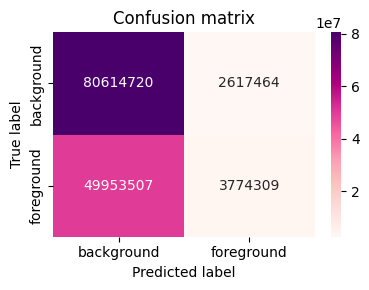

In [21]:
#report_1 = model_classification_report(model_1, test_loader_1, DEVICE, NUM_CLASES)
acc, rep, cm = model_segmentation_report(
    model_1_2, test_loader_1, DEVICE, NUM_CLASES, do_confusion_matrix=True, show_dice_loss=True
)

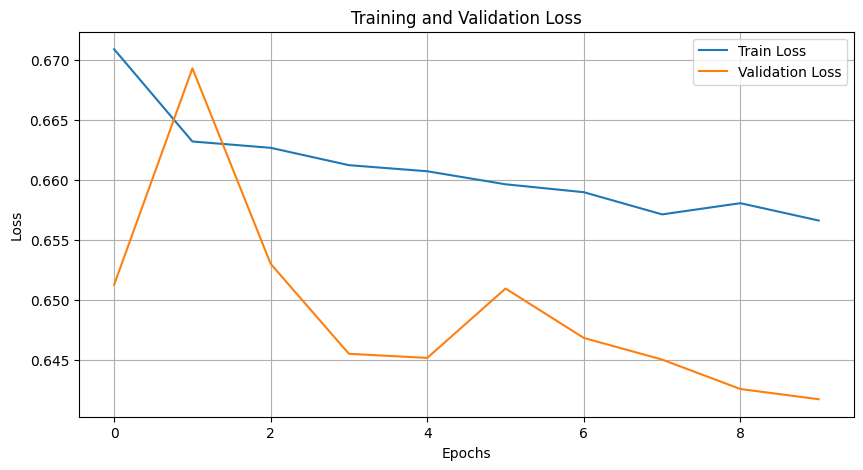

In [22]:
plot_training(epoch_train_errors_1_2, epoch_val_errors_1_2)

## Entrenando UNet con padding 1

La idea de esto es simplificar la arquitectura manteniendo el tamaño de las imagenes para mantener mas información de la imagen en cada capa y no tener que hacer un resize en la parte del decoder, pudiendo simplemente concatenar los feature maps.

In [39]:
train_loader_pad, val_loader_pad, test_loader_pad, kaggle_loader_pad = get_seg_dataloaders("data/train",
                                                            batch_size=BATCH_SIZE,
                                                            num_workers=NUM_WORKERS,
                                                            seed=SEED,
                                                            rgb=False,
                                                            train_transform_img=base_img_tf_byn,
                                                            train_transform_mask=base_mask_tf_byn,
                                                            val_transform_img=base_img_tf_byn,
                                                            val_transform_mask=base_mask_tf_byn)

In [140]:
unet_pad_1 = UNet(n_class=1, padding=1).to(DEVICE)
criterion_pad_1 = nn.BCEWithLogitsLoss()
optimizer_pad_1  = torch.optim.Adam(unet_pad_1.parameters(), lr=1e-5)

epoch_train_errors_pad_1, epoch_val_errors_pad_1 = train(unet_pad_1, optimizer_pad_1, criterion_pad_1,
                                                 train_loader_pad, val_loader_pad, DEVICE,
                                                 do_early_stopping=True, patience=15, epochs=100, log_every=10)

Epoch: 002 | Train Loss: 0.65953 | Val Loss: 0.62329
Epoch: 010 | Train Loss: 0.50128 | Val Loss: 0.45910
Epoch: 020 | Train Loss: 0.42229 | Val Loss: 0.39328
Epoch: 030 | Train Loss: 0.38674 | Val Loss: 0.36211
Epoch: 040 | Train Loss: 0.35059 | Val Loss: 0.33363
Epoch: 050 | Train Loss: 0.31471 | Val Loss: 0.32260
Epoch: 060 | Train Loss: 0.27657 | Val Loss: 0.31501
Epoch: 070 | Train Loss: 0.22550 | Val Loss: 0.32787
Detener entrenamiento en la época 73, la mejor pérdida fue 0.31364


Accuracy: 0.8695
Dice: 0.7995


Reporte de clasificación:

              precision      recall      f1-score     support        dice    
no-persona        0.9         0.89         0.89       83232184.0             
persona          0.83         0.84         0.84       53727816.0             
accuracy                                   0.87                              
macro avg        0.86         0.86         0.86      136960000.0      0.8    
weighted avg     0.87         0.87         0.87      136960000.0      0.8    
1                                                                     0.8    



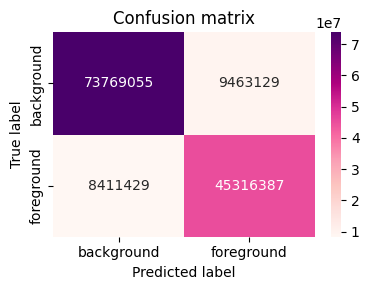

In [141]:
#report_1 = model_classification_report(model_1, test_loader_1, DEVICE, NUM_CLASES)
acc, rep, cm = model_segmentation_report(
    unet_pad_1, test_loader_pad, DEVICE, NUM_CLASES,
    do_confusion_matrix=True, show_dice_loss=True
)

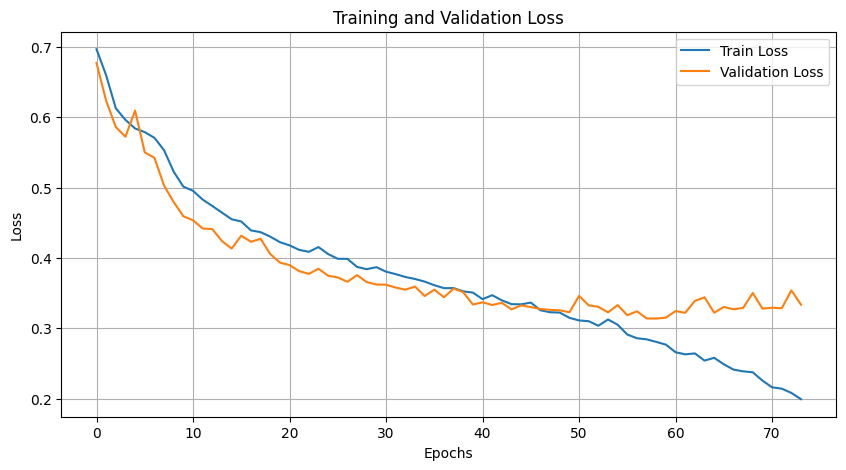

In [142]:
plot_training(epoch_train_errors_pad_1, epoch_val_errors_pad_1)

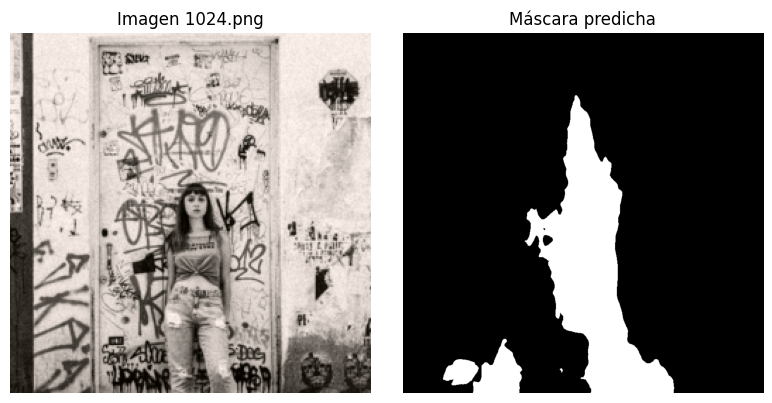

In [147]:
visualizar_test(unet_pad_1, kaggle_loader_pad, DEVICE)

In [148]:
train_loader_pad, val_loader_pad, test_loader_pad, kaggle_loader_pad = get_seg_dataloaders("data/train",
                                                            batch_size=1,
                                                            num_workers=NUM_WORKERS,
                                                            seed=SEED,
                                                            rgb=False,
                                                            train_transform_img=train_transform_img_simple,
                                                            train_transform_mask=train_transform_mask_simple,
                                                            val_transform_img=val_transform_img,
                                                            val_transform_mask=val_transform_mask)
predict_and_build_submission(unet_pad_1, DEVICE, kaggle_loader_pad, out_csv="unet_padding_1_submission")

submission guardado como: submissions/unet_padding_1_submission_16-11-2025_20:01.csv


(           id                                     encoded_pixels
 0    1024.png  71168 1 71965 7 72761 11 73559 13 74356 16 751...
 1    1025.png  672 129 1472 129 2270 131 3069 132 3868 133 46...
 2    1027.png  180714 23 181506 38 182300 50 183094 61 183888...
 3    1037.png  5747 14 6545 20 7343 25 8142 33 8209 28 8941 3...
 4    1038.png  27976 3 28774 7 29574 8 30374 9 31173 11 31973...
 ..        ...                                                ...
 529   971.png  103886 1 104682 9 105480 15 106278 20 107077 2...
 530   975.png  5032 8 5827 18 6624 23 7421 29 8218 33 8961 8 ...
 531   987.png  18879 4 19677 11 20476 15 21275 19 22076 19 22...
 532   995.png  344 143 1144 143 1942 147 2741 149 3540 151 43...
 533   999.png  190386 6 191182 13 191979 19 192776 25 193573 ...
 
 [534 rows x 2 columns],
 'submissions/unet_padding_1_submission_16-11-2025_20:01.csv')

### Otra prueba de la misma arquitectura pero con transforms corregidas, combined loss y learning rate mas grande

In [ ]:
train_loader_pad, val_loader_pad, test_loader_pad, kaggle_loader_pad = get_seg_dataloaders("data/train",
                                                            batch_size=BATCH_SIZE,
                                                            num_workers=NUM_WORKERS,
                                                            seed=SEED,
                                                            rgb=False,
                                                            train_transform_img=base_img_tf_byn,
                                                            train_transform_mask=base_mask_tf_byn,
                                                            val_transform_img=base_img_tf_byn,
                                                            val_transform_mask=base_mask_tf_byn)

In [40]:
unet_pad_1_1 = UNet(n_class=1, padding=1).to(DEVICE)
criterion_pad_1_1 = combined_loss
optimizer_pad_1_1  = torch.optim.Adam(unet_pad_1_1.parameters(), lr=1e-4)

epoch_train_errors_pad_1_1, epoch_val_errors_pad_1_1 = train(unet_pad_1_1, optimizer_pad_1_1, criterion_pad_1_1,
                                                 train_loader_pad, val_loader_pad, DEVICE,
                                                 do_early_stopping=True, patience=10, epochs=100, log_every=5,
                                                checkpoint_path="models/unet_pad_1_1.pth", loss_ponderada=True)

Epoch: 002 | Train Loss: 0.47095 | Val Loss: 0.47347
Epoch: 005 | Train Loss: 0.36873 | Val Loss: 0.39898
Epoch: 010 | Train Loss: 0.25649 | Val Loss: 0.27531
Epoch: 015 | Train Loss: 0.16081 | Val Loss: 0.24208
Epoch: 020 | Train Loss: 0.06119 | Val Loss: 0.28227
Detener entrenamiento en la época 23, la mejor pérdida fue 0.23616


Accuracy: 0.8977
Dice: 0.8423


Reporte de clasificación:

              precision      recall      f1-score     support        dice    
no-persona       0.92         0.91         0.92       8522061.0              
persona          0.86         0.88         0.87       5502643.0              
accuracy                                    0.9                              
macro avg        0.89          0.9         0.89      14024704.0      0.84    
weighted avg      0.9          0.9          0.9      14024704.0      0.84    
1                                                                    0.84    



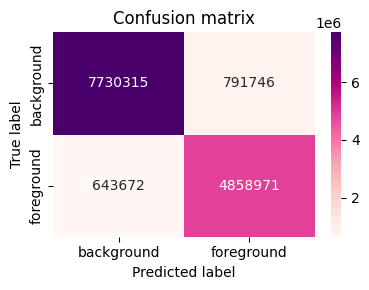

In [41]:
acc, rep, cm = model_segmentation_report(
    unet_pad_1_1, test_loader_pad, DEVICE, NUM_CLASES,
    do_confusion_matrix=True, show_dice_loss=True
)

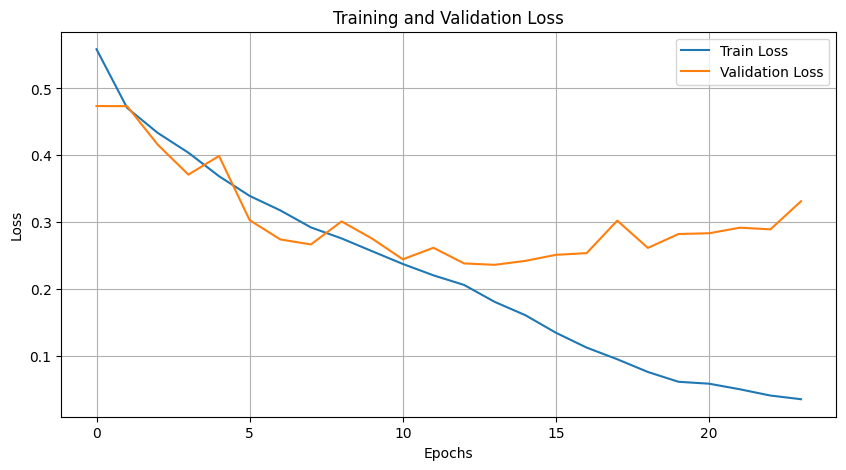

In [42]:
plot_training(epoch_train_errors_pad_1_1, epoch_val_errors_pad_1_1)

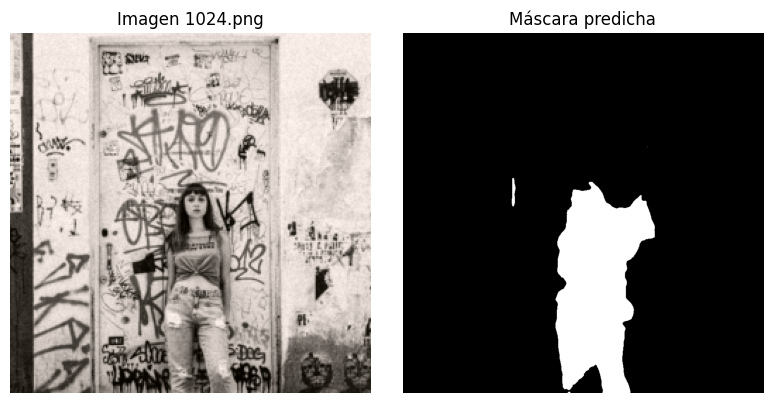

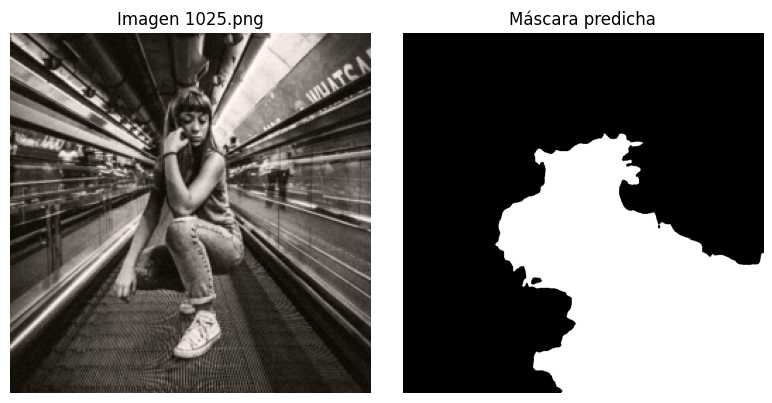

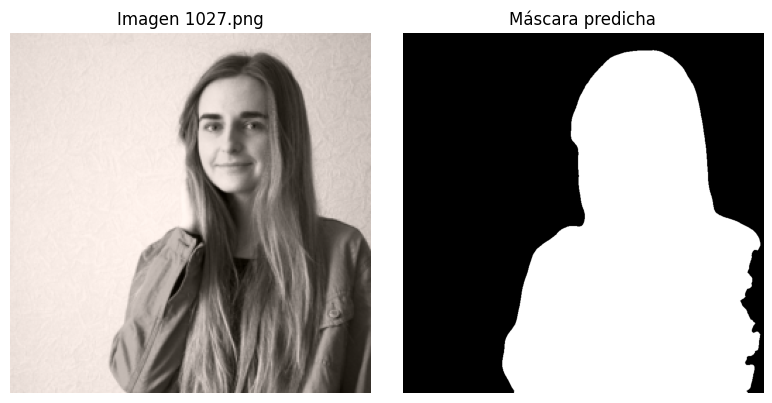

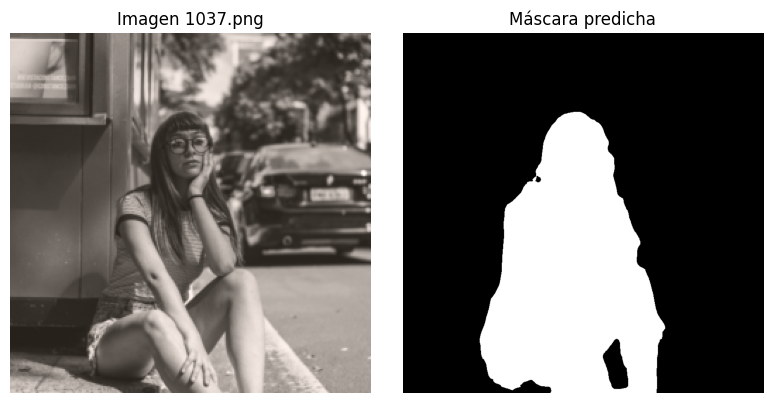

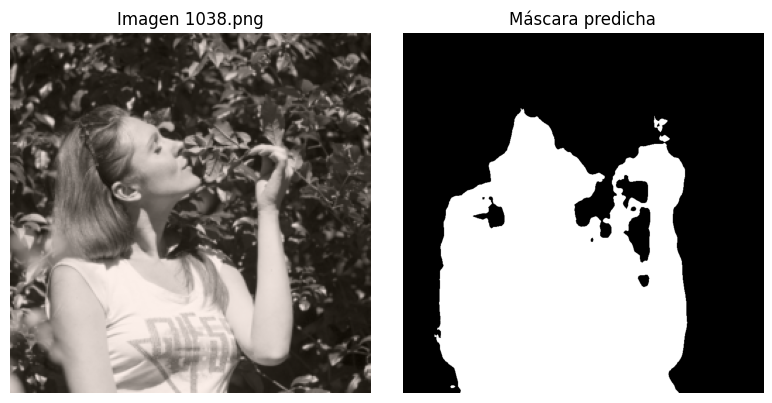

In [45]:
visualizar_test(unet_pad_1_1, kaggle_loader_pad, DEVICE)

In [47]:
_, _, _, kaggle_loader_pad = get_seg_dataloaders("data/train",
                                                            batch_size=1,
                                                            num_workers=NUM_WORKERS,
                                                            seed=SEED,
                                                            rgb=False,
                                                            train_transform_img=base_img_tf_byn,
                                                            train_transform_mask=base_mask_tf_byn,
                                                            val_transform_img=base_img_tf_byn,
                                                            val_transform_mask=base_mask_tf_byn)
predict_and_build_submission(unet_pad_1_1, DEVICE, kaggle_loader_pad, out_csv="unet_padding_1_1_submission")

submission guardado como: submissions/unet_padding_1_1_submission_19-11-2025_00:51.csv


(           id                                     encoded_pixels
 0    1024.png  193170 13 193925 62 194725 62 195524 64 196325...
 1    1025.png  163671 1 164470 3 165269 6 166068 7 166867 9 1...
 2    1027.png  176728 16 177522 26 178316 36 179112 42 179904...
 3    1037.png  136679 11 137474 20 138270 37 139067 49 139864...
 4    1038.png  55874 1 56671 6 57472 5 58273 4 59074 2 59873 ...
 ..        ...                                                ...
 529   971.png  51999 2 52799 2 53598 3 54397 4 55197 4 55997 ...
 530   975.png  593 9 1393 9 2193 10 2993 11 3793 12 4592 15 5...
 531   987.png  474 103 1274 103 2073 104 2872 106 3672 106 44...
 532   995.png  339 77 1139 77 1938 78 2737 79 3537 79 4336 80...
 533   999.png  169558 2 170354 14 171151 21 171949 26 172747 ...
 
 [534 rows x 2 columns],
 'submissions/unet_padding_1_1_submission_19-11-2025_00:51.csv')

## Entrenando UNet con padding 1 + RGB


In [48]:
train_loader_rgb, val_loader_rgb, test_loader_rgb, kaggle_loader_rgb = get_seg_dataloaders("data/train",
                                                            batch_size=BATCH_SIZE,
                                                            num_workers=NUM_WORKERS,
                                                            seed=SEED,
                                                            rgb=True,
                                                            train_transform_img=base_img_tf,
                                                            train_transform_mask=base_mask_tf,
                                                            val_transform_img=base_img_tf,
                                                            val_transform_mask=base_mask_tf)

In [49]:
unet_rgb = UNet(n_class=1, n_channels=3, padding=1).to(DEVICE)
criterion_rgb = combined_loss
optimizer_rgb  = torch.optim.Adam(unet_rgb.parameters(), lr=1e-4)
 
epoch_train_errors_rgb, epoch_val_errors_rgb = train(unet_rgb, optimizer_rgb, criterion_rgb,
                                                 train_loader_rgb, val_loader_rgb, DEVICE,
                                                 do_early_stopping=True, patience=10, epochs=100, log_every=5,
                                                checkpoint_path="models/unet_rgb.pth", loss_ponderada=True)

Epoch: 002 | Train Loss: 0.43594 | Val Loss: 0.44050
Epoch: 005 | Train Loss: 0.35370 | Val Loss: 0.37336
Epoch: 010 | Train Loss: 0.26023 | Val Loss: 0.27474
Epoch: 015 | Train Loss: 0.18822 | Val Loss: 0.25338
Epoch: 020 | Train Loss: 0.08748 | Val Loss: 0.26445
Epoch: 025 | Train Loss: 0.03734 | Val Loss: 0.33425
Detener entrenamiento en la época 27, la mejor pérdida fue 0.25157


Accuracy: 0.8873
Dice: 0.8321


Reporte de clasificación:

              precision      recall      f1-score     support        dice    
no-persona       0.92         0.89         0.91       8531764.0              
persona          0.84         0.88         0.86       5492940.0              
accuracy                                   0.89                              
macro avg        0.88         0.89         0.88      14024704.0      0.83    
weighted avg     0.89         0.89         0.89      14024704.0      0.83    
1                                                                    0.83    



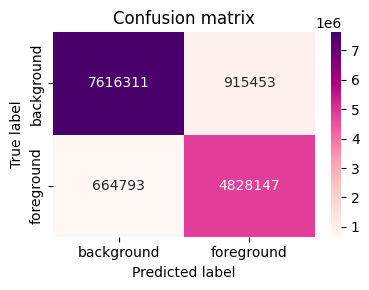

In [50]:
acc, rep, cm = model_segmentation_report(
    unet_rgb, test_loader_rgb, DEVICE, NUM_CLASES,
    do_confusion_matrix=True, show_dice_loss=True
)

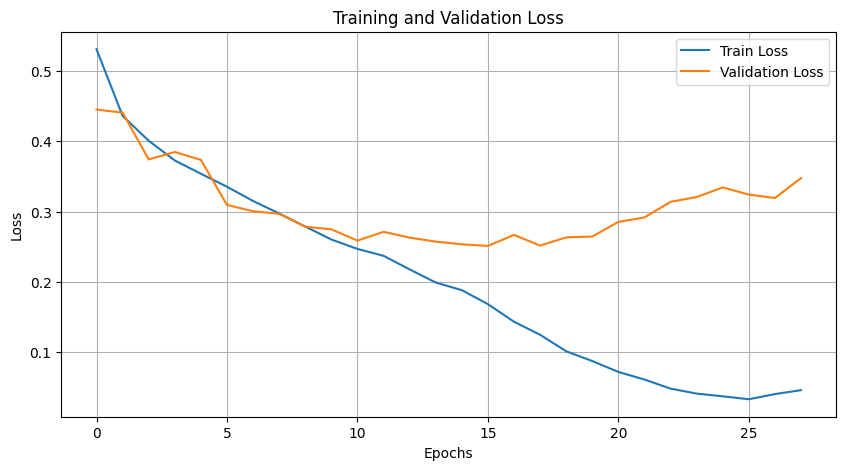

In [51]:
plot_training(epoch_train_errors_rgb, epoch_val_errors_rgb)

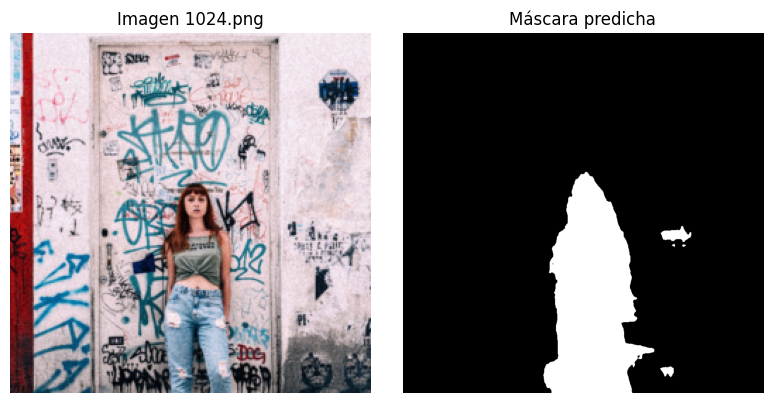

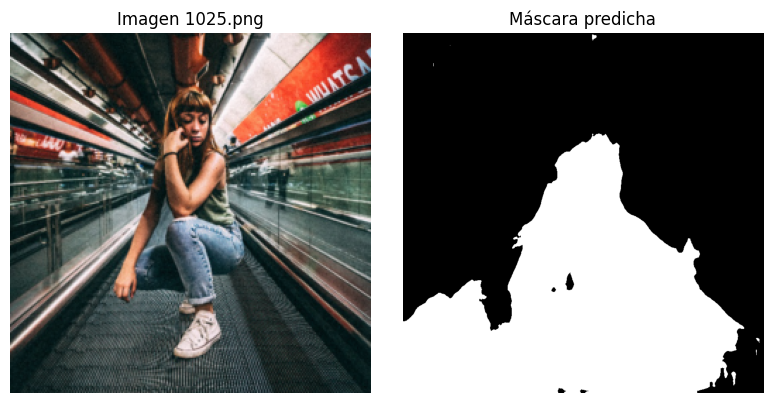

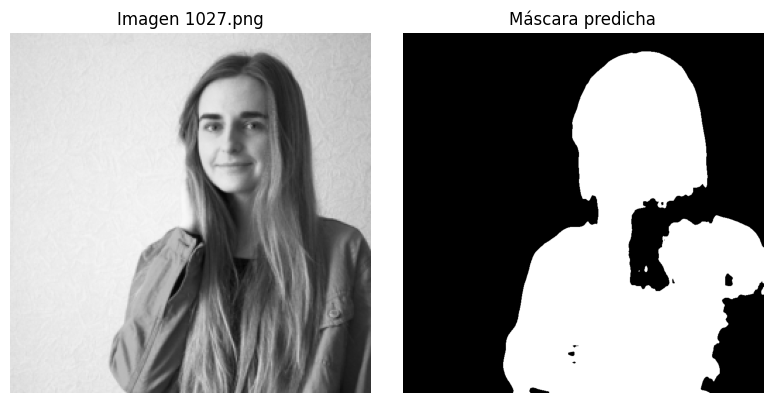

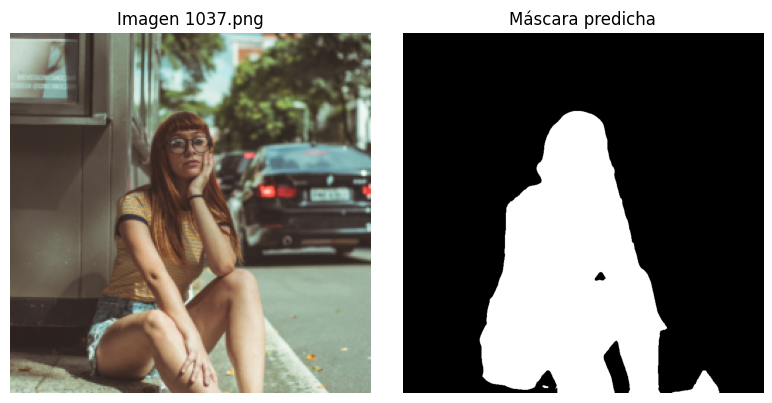

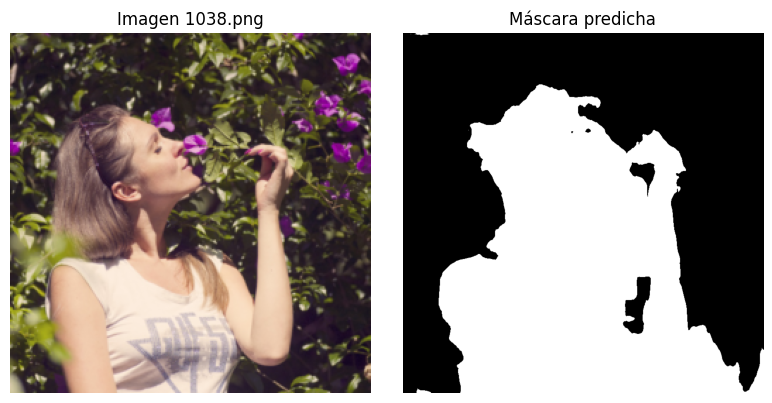

In [52]:
visualizar_test(unet_rgb, kaggle_loader_rgb, DEVICE)

###  Observaciones
No dio mejor que la de blanco y negro, pero por poco

### Ahora con batch_norm y dropout

In [55]:
train_loader_rgb_2, val_loader_rgb_2, test_loader_rgb_2, kaggle_loader_rgb_2 = get_seg_dataloaders("data/train",
                                                            batch_size=BATCH_SIZE,
                                                            num_workers=NUM_WORKERS,
                                                            seed=SEED,
                                                            rgb=True,
                                                            train_transform_img=base_img_tf,
                                                            train_transform_mask=base_mask_tf,
                                                            val_transform_img=base_img_tf,
                                                            val_transform_mask=base_mask_tf)

In [54]:
unet_rgb_2 = UNet(n_class=1, n_channels=3, padding=1, use_bn=True, dropout=0.3).to(DEVICE)
criterion_rgb_2 = combined_loss
optimizer_rgb_2 = torch.optim.Adam(unet_rgb_2.parameters(), lr=1e-4)
 
epoch_train_errors_rgb_2, epoch_val_errors_rgb_2 = train(unet_rgb_2, optimizer_rgb_2, criterion_rgb_2,
                                                 train_loader_rgb_2, val_loader_rgb_2, DEVICE,
                                                 do_early_stopping=True, patience=10, epochs=100, log_every=5,
                                                checkpoint_path="models/unet_rgb_2.pth", loss_ponderada=True)

Epoch: 002 | Train Loss: 0.46701 | Val Loss: 0.65348
Epoch: 005 | Train Loss: 0.42590 | Val Loss: 0.62397
Epoch: 010 | Train Loss: 0.37281 | Val Loss: 0.35292
Epoch: 015 | Train Loss: 0.34408 | Val Loss: 0.30161
Epoch: 020 | Train Loss: 0.31696 | Val Loss: 0.26136
Epoch: 025 | Train Loss: 0.28826 | Val Loss: 0.23998
Epoch: 030 | Train Loss: 0.27002 | Val Loss: 0.22849
Epoch: 035 | Train Loss: 0.25630 | Val Loss: 0.21406
Epoch: 040 | Train Loss: 0.24291 | Val Loss: 0.20221
Epoch: 045 | Train Loss: 0.22954 | Val Loss: 0.20433
Epoch: 050 | Train Loss: 0.21742 | Val Loss: 0.18524
Epoch: 055 | Train Loss: 0.20740 | Val Loss: 0.18525
Epoch: 060 | Train Loss: 0.19598 | Val Loss: 0.17094
Epoch: 065 | Train Loss: 0.18957 | Val Loss: 0.17060
Epoch: 070 | Train Loss: 0.18015 | Val Loss: 0.16087
Epoch: 075 | Train Loss: 0.16976 | Val Loss: 0.16053
Epoch: 080 | Train Loss: 0.16369 | Val Loss: 0.15770
Epoch: 085 | Train Loss: 0.15458 | Val Loss: 0.15459
Detener entrenamiento en la época 88, la mejor

Accuracy: 0.9296
Dice: 0.8907


Reporte de clasificación:

              precision      recall      f1-score     support        dice    
no-persona       0.96         0.92         0.94       8531764.0              
persona          0.88         0.95         0.91       5492940.0              
accuracy                                   0.93                              
macro avg        0.92         0.93         0.93      14024704.0      0.89    
weighted avg     0.93         0.93         0.93      14024704.0      0.89    
1                                                                    0.89    



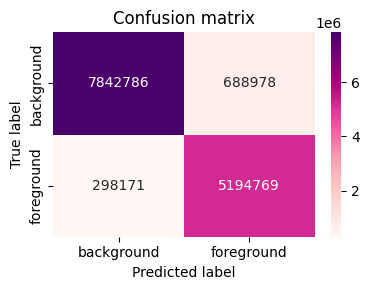

In [55]:
acc, rep, cm = model_segmentation_report(
    unet_rgb_2, test_loader_rgb_2, DEVICE, NUM_CLASES,
    do_confusion_matrix=True, show_dice_loss=True
)

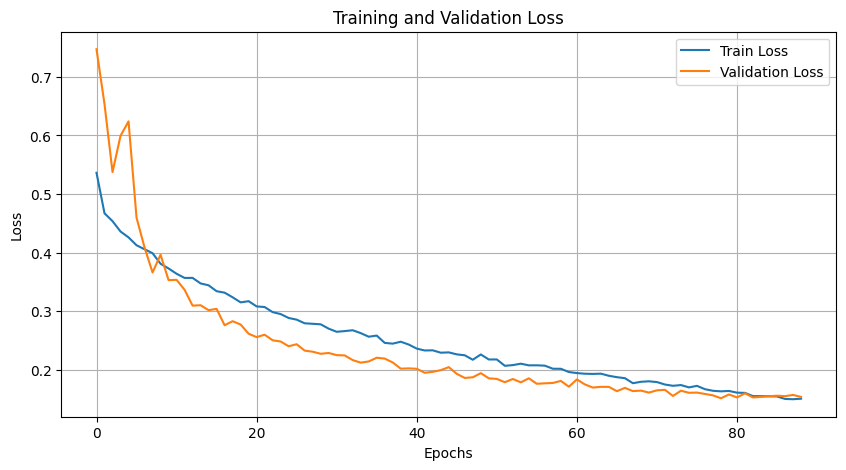

In [56]:
plot_training(epoch_train_errors_rgb_2, epoch_val_errors_rgb_2)

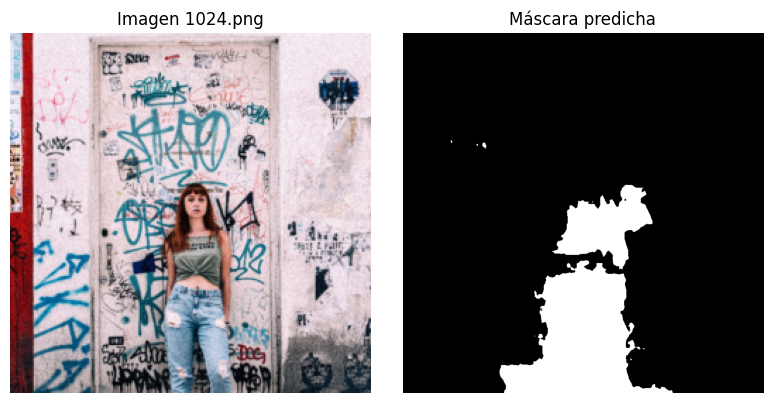

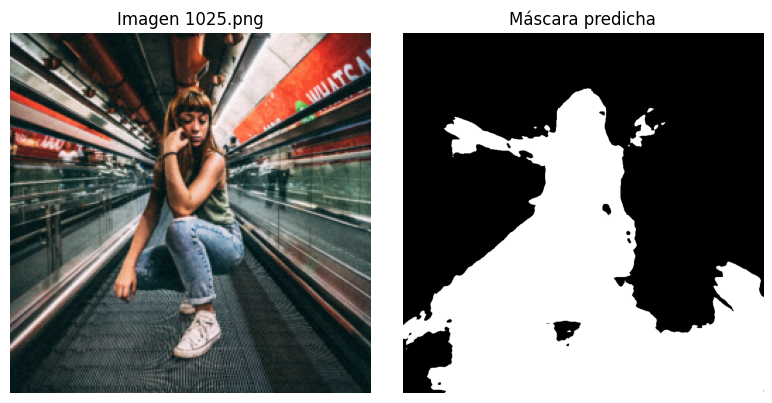

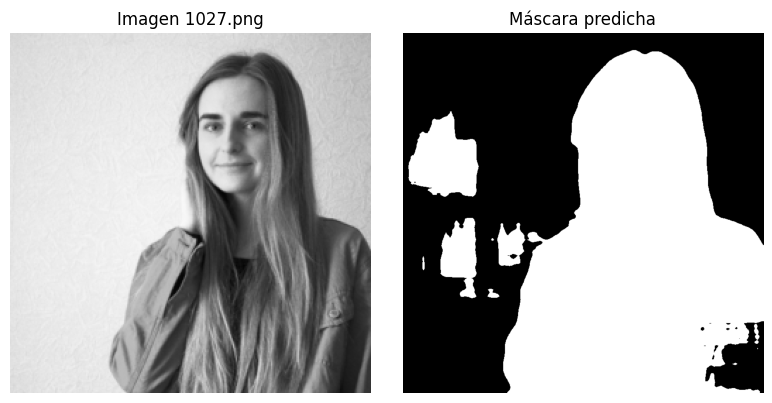

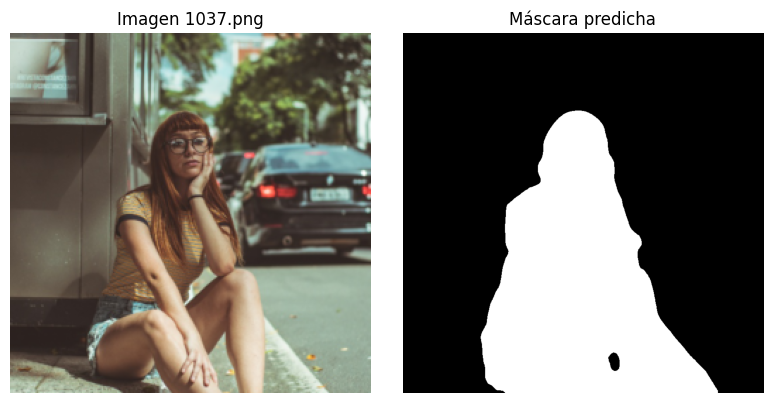

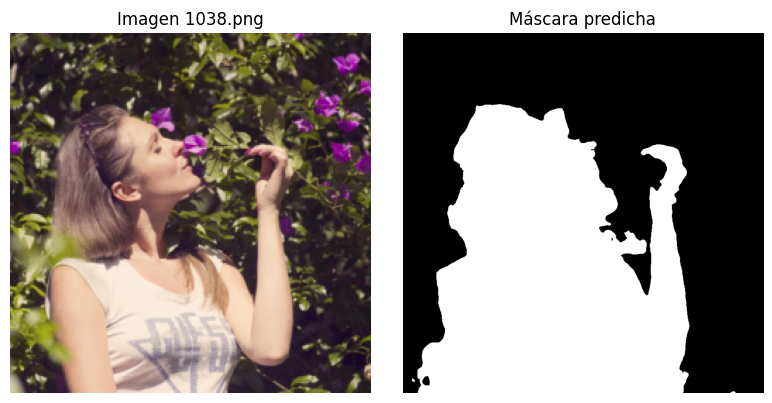

In [57]:
visualizar_test(unet_rgb_2, kaggle_loader_rgb_2, DEVICE)

In [59]:
_, _, _, kaggle_loader_rgb_2 = get_seg_dataloaders("data/train",
                                                            batch_size=1,
                                                            num_workers=NUM_WORKERS,
                                                            seed=SEED,
                                                            rgb=True,
                                                            train_transform_img=base_img_tf,
                                                            train_transform_mask=base_mask_tf,
                                                            val_transform_img=base_img_tf,
                                                            val_transform_mask=base_mask_tf)

predict_and_build_submission(unet_rgb_2, DEVICE, kaggle_loader_rgb_2, out_csv="unet_rgb_2_submission")

submission guardado como: submissions/unet_rgb_2_submission_19-11-2025_03:24.csv


(           id                                     encoded_pixels
 0    1024.png  85041 4 85841 6 86642 5 130649 3 131449 4 1322...
 1    1025.png  650 31 1450 31 2249 32 3048 33 3847 35 4646 36...
 2    1027.png  9896 9 9923 2 10690 39 11488 43 12286 46 13083...
 3    1037.png  138275 6 139071 16 139868 23 140665 36 141464 ...
 4    1038.png  16768 7 17569 6 18370 6 19170 7 19971 5 20772 ...
 ..        ...                                                ...
 529   971.png  35199 2 35997 4 36796 5 37596 5 38396 5 39196 ...
 530   975.png  590 56 1390 56 2189 58 2988 60 3788 61 4586 65...
 531   987.png  471 219 1271 219 2071 220 2870 222 3670 222 44...
 532   995.png  389 356 1189 356 1980 1 1987 359 2778 5 2786 3...
 533   999.png  49134 31 49927 46 50724 54 51520 62 51588 8 52...
 
 [534 rows x 2 columns],
 'submissions/unet_rgb_2_submission_19-11-2025_03:24.csv')

In [98]:
unet_rgb_2 = dice_on_val_with_postproc(unet_rgb_2, val_loader_rgb_2, DEVICE, threshold=0.6) # con clean mask v2
print("Dice val con postprocesado:", unet_rgb_2)

Dice val con postprocesado: 0.9098154650124299


Dice pasa de 0.89 a 0.90 al usar post procesado => Pruebo submission del mismo modelo pero con post procesado de las máscaras:

In [99]:
unet_rgb_2 = UNet(n_class=1, n_channels=3, padding=1, use_bn=True, dropout=0.3).to(DEVICE)
criterion_rgb_2 = combined_loss
optimizer_rgb_2 = torch.optim.Adam(unet_rgb_2.parameters(), lr=1e-4)

model, optimizer, checkpoint = restaurar_modelo(unet_rgb_2, optimizer_rgb_2, "models/unet_rgb_2.pth", DEVICE)

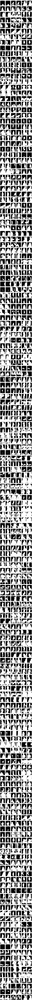

submission guardado como: submissions/unet_rgb_2_post_submission_19-11-2025_20:58.csv


(           id                                     encoded_pixels
 0    1024.png  174354 5 175153 9 175953 10 176752 13 177552 1...
 1    1025.png  646 43 1445 45 2245 45 3045 45 3845 45 4644 47...
 2    1027.png  152298 4 153096 8 153895 11 154694 14 155492 1...
 3    1037.png  139873 10 140670 18 141467 26 142265 51 143063...
 4    1038.png  38306 11 39104 23 39902 30 40701 33 41500 39 4...
 ..        ...                                                ...
 529   971.png  55199 2 55999 2 56755 3 56798 3 57552 6 57598 ...
 530   975.png  590 52 1389 54 2189 54 2989 54 3789 54 4588 56...
 531   987.png  473 221 1272 222 2072 222 2872 222 3672 222 44...
 532   995.png  424 315 1223 316 2023 316 2823 317 3623 317 44...
 533   999.png  213491 11 214287 20 215084 25 215882 30 216678...
 
 [534 rows x 2 columns],
 'submissions/unet_rgb_2_post_submission_19-11-2025_20:58.csv')

In [100]:
_, _, _, kaggle_loader_rgb_2 = get_seg_dataloaders("data/train",
                                                            batch_size=1,
                                                            num_workers=NUM_WORKERS,
                                                            seed=SEED,
                                                            rgb=True,
                                                            train_transform_img=base_img_tf,
                                                            train_transform_mask=base_mask_tf,
                                                            val_transform_img=base_img_tf,
                                                            val_transform_mask=base_mask_tf)
predict_and_build_submission(model, DEVICE, kaggle_loader_rgb_2, out_csv="unet_rgb_2_post_submission", use_post_proc=True, debug=True)

#### Misma arquitectura pero con learning rate scheduler y nuevas transfroms

In [31]:
train_loader_rgb_2, val_loader_rgb_2, test_loader_rgb_2, kaggle_loader_rgb_2 = get_seg_dataloaders(
    "data/train",
    batch_size=BATCH_SIZE, num_workers=NUM_WORKERS, seed=SEED, rgb=True,
    # Post
    train_transform_img=train_img_post_tf_rgb,
    train_transform_mask=train_mask_post_tf_rgb,
    val_transform_img=val_img_post_tf_rgb,
    val_transform_mask=val_mask_post_tf_rgb,
    # Conjuntas
    joint_transform_train=joint_transform_train_rgb,
    joint_transform_val=joint_transform_val_rgb,
)

unet_rgb_22 = UNet(n_class=1, n_channels=3, padding=1, use_bn=True, dropout=0.3).to(DEVICE)
criterion_rgb_22 = combined_loss

optimizer = torch.optim.Adam(unet_rgb_22.parameters(), lr=0.005, weight_decay=1e-5)
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer, mode="min", factor=0.5, patience=4
)
 
epoch_train_errors_rgb_22, epoch_val_errors_rgb_22 = train(
    unet_rgb_22, optimizer, criterion_rgb_22, train_loader_rgb_2, val_loader_rgb_2, DEVICE, scheduler=scheduler,
    do_early_stopping=True, patience=10, epochs=100, log_every=5, checkpoint_path="models/unet_rgb_2.0.pth", loss_ponderada=True)

Epoch: 002 | Train Loss: 0.53238 | Val Loss: 0.56396 | Current LR: 0.00500
Epoch: 005 | Train Loss: 0.49686 | Val Loss: 0.47474 | Current LR: 0.00500
Epoch: 010 | Train Loss: 0.47444 | Val Loss: 0.44272 | Current LR: 0.00500
Epoch: 015 | Train Loss: 0.45731 | Val Loss: 0.41826 | Current LR: 0.00500
Epoch: 020 | Train Loss: 0.44124 | Val Loss: 0.44166 | Current LR: 0.00500
Epoch: 025 | Train Loss: 0.40546 | Val Loss: 0.35432 | Current LR: 0.00500
Epoch: 030 | Train Loss: 0.38676 | Val Loss: 0.33480 | Current LR: 0.00500
Epoch: 035 | Train Loss: 0.37063 | Val Loss: 0.32931 | Current LR: 0.00500
Epoch: 040 | Train Loss: 0.34060 | Val Loss: 0.30195 | Current LR: 0.00250
Epoch: 045 | Train Loss: 0.33160 | Val Loss: 0.27332 | Current LR: 0.00250
Epoch: 050 | Train Loss: 0.32170 | Val Loss: 0.27582 | Current LR: 0.00250
Epoch: 055 | Train Loss: 0.30872 | Val Loss: 0.25324 | Current LR: 0.00125
Epoch: 060 | Train Loss: 0.30159 | Val Loss: 0.23824 | Current LR: 0.00125
Epoch: 065 | Train Loss: 

Accuracy: 0.9025
Dice: 0.8565


Reporte de clasificación:

              precision      recall      f1-score     support        dice    
no-persona       0.95         0.89         0.92       8531764.0              
persona          0.84         0.92         0.88       5492940.0              
accuracy                                    0.9                              
macro avg         0.9         0.91          0.9      14024704.0      0.86    
weighted avg     0.91          0.9          0.9      14024704.0      0.86    
1                                                                    0.86    



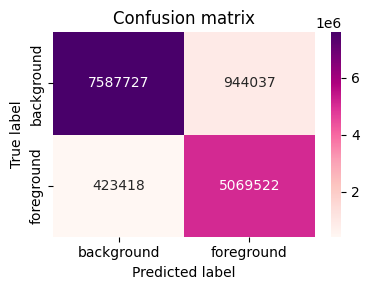

In [32]:
acc, rep, cm = model_segmentation_report(
    unet_rgb_22, test_loader_rgb_2, DEVICE, NUM_CLASES,
    do_confusion_matrix=True, show_dice_loss=True
)

### Ahora solo con dropout

In [27]:
train_loader_rgb_drop, val_loader_rgb_drop, test_loader_rgb_drop, kaggle_loader_rgb_drop = get_seg_dataloaders("data/train",
                                                            batch_size=BATCH_SIZE,
                                                            num_workers=NUM_WORKERS,
                                                            seed=SEED,
                                                            rgb=True,
                                                            train_transform_img=base_img_tf,
                                                            train_transform_mask=base_mask_tf,
                                                            val_transform_img=base_img_tf,
                                                            val_transform_mask=base_mask_tf)

In [28]:
unet_rgb_drop = UNet(n_class=1, n_channels=3, padding=1, use_bn=False, dropout=0.3).to(DEVICE)
criterion_rgb_drop = combined_loss
optimizer_rgb_drop = torch.optim.Adam(unet_rgb_drop.parameters(), lr=1e-4)
 
epoch_train_errors_rgb_drop, epoch_val_errors_rgb_drop = train(unet_rgb_drop, optimizer_rgb_drop, criterion_rgb_drop,
                                                 train_loader_rgb_drop, val_loader_rgb_drop, DEVICE,
                                                 do_early_stopping=True, patience=10, epochs=100, log_every=5,
                                                checkpoint_path="models/unet_rgb_drop.pth", loss_ponderada=True)

Epoch: 002 | Train Loss: 0.51735 | Val Loss: 0.46918
Epoch: 005 | Train Loss: 0.44306 | Val Loss: 0.39041
Epoch: 010 | Train Loss: 0.39087 | Val Loss: 0.34610
Epoch: 015 | Train Loss: 0.35098 | Val Loss: 0.31444
Epoch: 020 | Train Loss: 0.32428 | Val Loss: 0.29529
Epoch: 025 | Train Loss: 0.29543 | Val Loss: 0.26306
Epoch: 030 | Train Loss: 0.27580 | Val Loss: 0.26093
Epoch: 035 | Train Loss: 0.25459 | Val Loss: 0.24966
Epoch: 040 | Train Loss: 0.23668 | Val Loss: 0.24080
Epoch: 045 | Train Loss: 0.20996 | Val Loss: 0.24176
Epoch: 050 | Train Loss: 0.18557 | Val Loss: 0.25226
Epoch: 055 | Train Loss: 0.15760 | Val Loss: 0.26000
Detener entrenamiento en la época 55, la mejor pérdida fue 0.23508


Accuracy: 0.8815
Dice: 0.8296


Reporte de clasificación:

              precision      recall      f1-score     support        dice    
no-persona       0.93         0.87          0.9       8531764.0              
persona          0.82          0.9         0.86       5492940.0              
accuracy                                   0.88                              
macro avg        0.87         0.88         0.88      14024704.0      0.83    
weighted avg     0.89         0.88         0.88      14024704.0      0.83    
1                                                                    0.83    



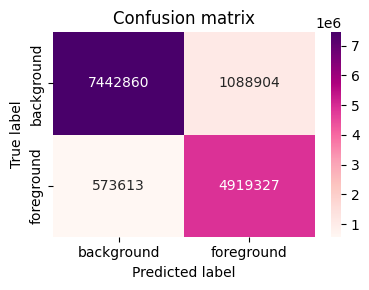

In [29]:
acc, rep, cm = model_segmentation_report(
    unet_rgb_drop, test_loader_rgb_drop, DEVICE, NUM_CLASES,
    do_confusion_matrix=True, show_dice_loss=True
)

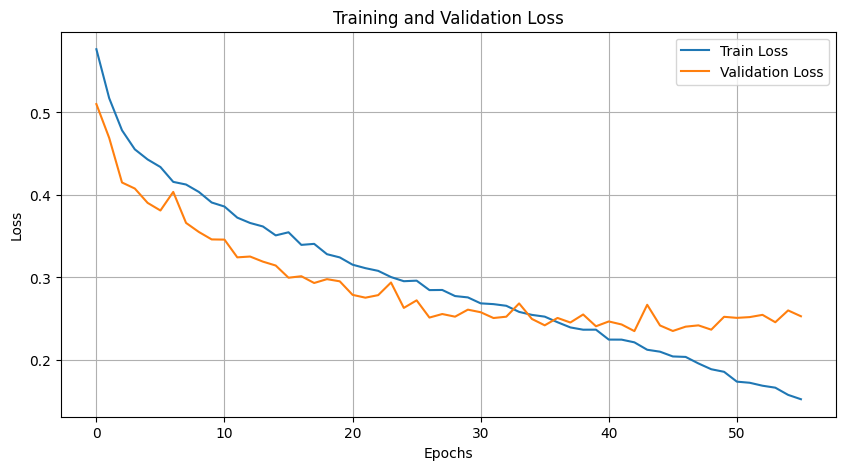

In [30]:
plot_training(epoch_train_errors_rgb_drop, epoch_val_errors_rgb_drop)

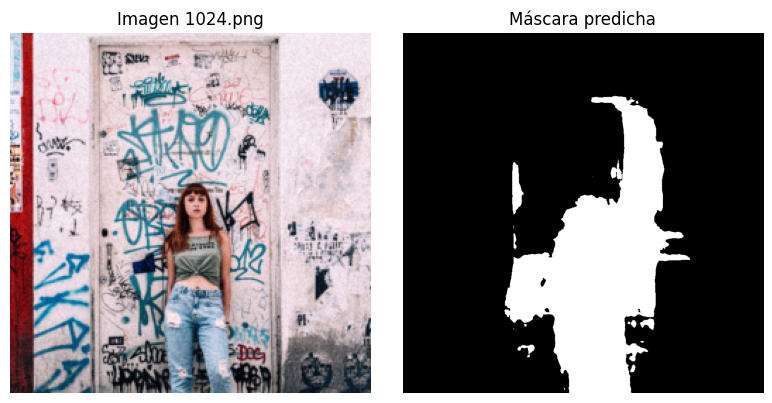

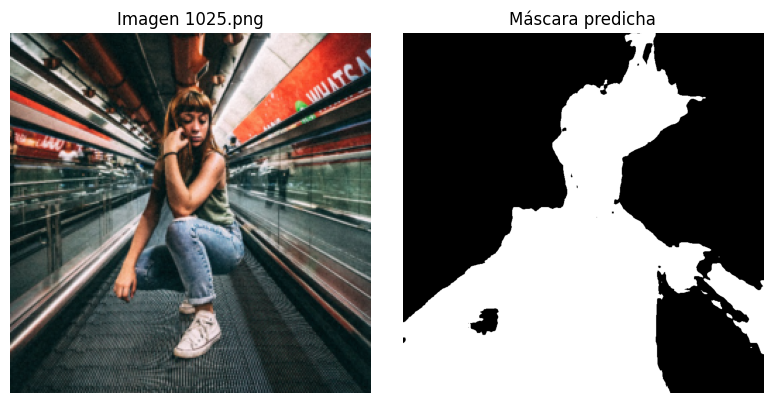

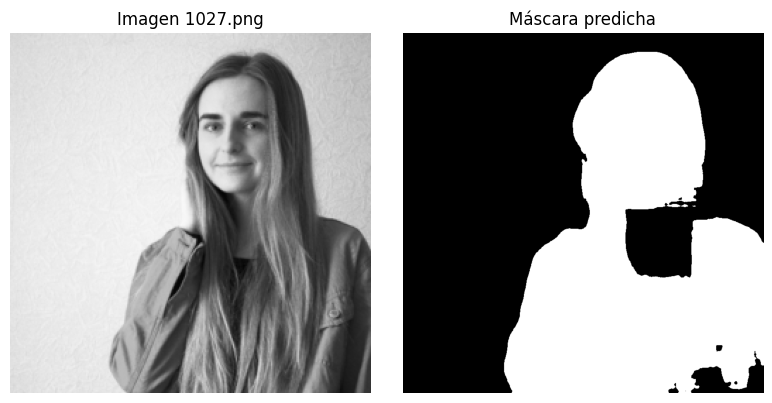

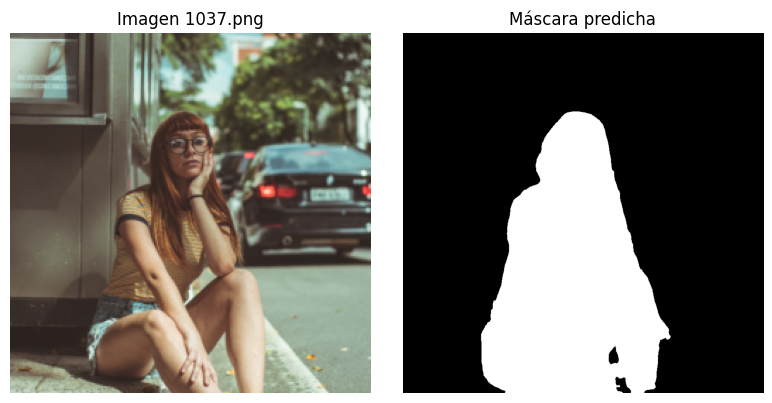

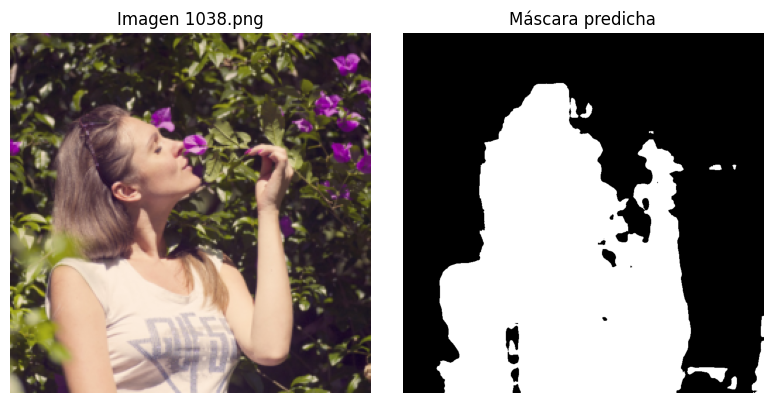

In [33]:
visualizar_test(unet_rgb_drop, kaggle_loader_rgb_drop, DEVICE)

In [ ]:
_, _, _, kaggle_loader_rgb_drop = get_seg_dataloaders("data/train",
                                                            batch_size=1,
                                                            num_workers=NUM_WORKERS,
                                                            seed=SEED,
                                                            rgb=True,
                                                            train_transform_img=train_transform_img_rgb,
                                                            train_transform_mask=train_transform_mask_rgb,
                                                            val_transform_img=val_transform_img_rgb,
                                                            val_transform_mask=val_transform_mask_rgb)

predict_and_build_submission(unet_rgb_drop, DEVICE, kaggle_loader_rgb_drop, out_csv="unet_rgb_drop_ubmission")

#### Observaciones

Dropout + BN es mejor que solo Dropout

### Ahora batch_norm + dropout y data augmentation

In [116]:
train_loader_rgb_3, val_loader_rgb_3, test_loader_rgb_3, kaggle_loader_rgb_3 = get_seg_dataloaders(
    root="data/train",
    batch_size=BATCH_SIZE,
    num_workers=NUM_WORKERS,
    seed=SEED,
    rgb=True,
    # Post
    train_transform_img=train_img_post_tf_rgb,
    train_transform_mask=train_mask_post_tf_rgb,
    val_transform_img=val_img_post_tf_rgb,
    val_transform_mask=val_mask_post_tf_rgb,
    # Conjuntas
    joint_transform_train=joint_transform_train_rgb,
    joint_transform_val=joint_transform_val_rgb,
)


In [117]:
unet_rgb_3 = UNet(n_class=1, n_channels=3, padding=1, use_bn=True, dropout=0.3).to(DEVICE)
criterion_rgb_3 = combined_loss
optimizer_rgb_3 = torch.optim.Adam(unet_rgb_3.parameters(), lr=1e-4)
 
epoch_train_errors_rgb_3, epoch_val_errors_rgb_3 = train(unet_rgb_3, optimizer_rgb_3, criterion_rgb_3,
                                                 train_loader_rgb_3, val_loader_rgb_3, DEVICE,
                                                 do_early_stopping=True, patience=10, epochs=100, log_every=5,
                                                checkpoint_path="models/unet_rgb_3.pth", loss_ponderada=True)

Epoch: 002 | Train Loss: 0.48394 | Val Loss: 0.48486
Epoch: 005 | Train Loss: 0.43320 | Val Loss: 0.41882
Epoch: 010 | Train Loss: 0.38444 | Val Loss: 0.34812
Epoch: 015 | Train Loss: 0.35127 | Val Loss: 0.31316
Epoch: 020 | Train Loss: 0.32303 | Val Loss: 0.28095
Epoch: 025 | Train Loss: 0.30153 | Val Loss: 0.25667
Epoch: 030 | Train Loss: 0.28101 | Val Loss: 0.24761
Epoch: 035 | Train Loss: 0.27160 | Val Loss: 0.22932
Epoch: 040 | Train Loss: 0.26358 | Val Loss: 0.21608
Epoch: 045 | Train Loss: 0.24744 | Val Loss: 0.21324
Epoch: 050 | Train Loss: 0.23859 | Val Loss: 0.20952
Epoch: 055 | Train Loss: 0.23080 | Val Loss: 0.18800
Epoch: 060 | Train Loss: 0.22204 | Val Loss: 0.19615
Epoch: 065 | Train Loss: 0.21550 | Val Loss: 0.17917
Epoch: 070 | Train Loss: 0.21020 | Val Loss: 0.18179
Epoch: 075 | Train Loss: 0.20127 | Val Loss: 0.16922
Epoch: 080 | Train Loss: 0.19612 | Val Loss: 0.16155
Epoch: 085 | Train Loss: 0.19247 | Val Loss: 0.16117
Epoch: 090 | Train Loss: 0.18359 | Val Loss: 0

Accuracy: 0.9261
Dice: 0.8872


Reporte de clasificación:

              precision      recall      f1-score     support        dice    
no-persona       0.97         0.91         0.94       8531764.0              
persona          0.87         0.96         0.91       5492940.0              
accuracy                                   0.93                              
macro avg        0.92         0.93         0.92      14024704.0      0.89    
weighted avg     0.93         0.93         0.93      14024704.0      0.89    
1                                                                    0.89    



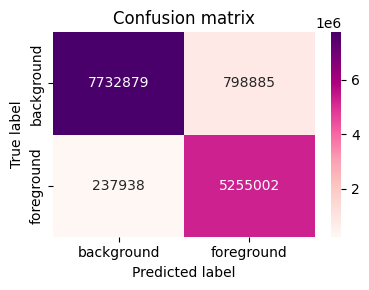

In [118]:
acc, rep, cm = model_segmentation_report(
    unet_rgb_3, test_loader_rgb_3, DEVICE, NUM_CLASES,
    do_confusion_matrix=True, show_dice_loss=True
)

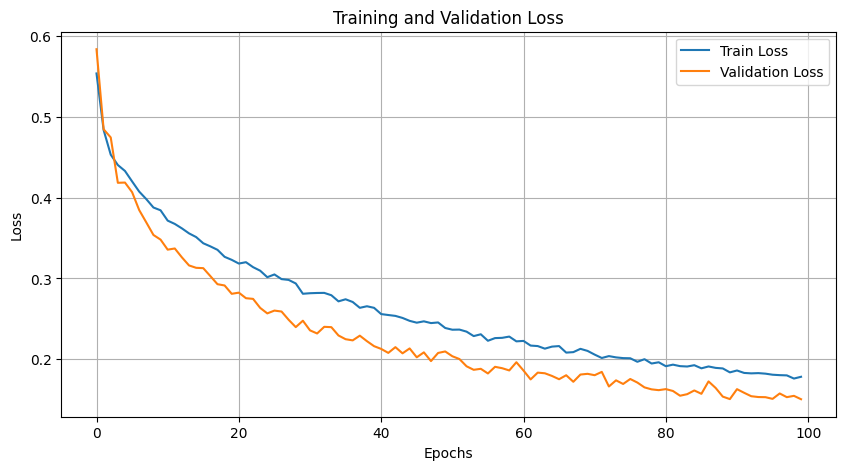

In [119]:
plot_training(epoch_train_errors_rgb_3, epoch_val_errors_rgb_3)

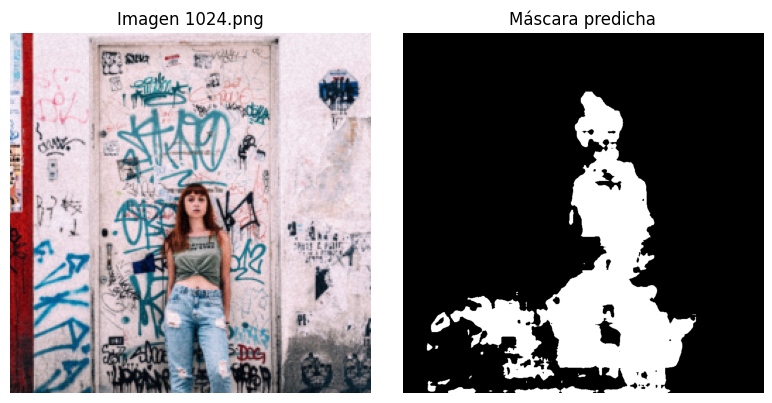

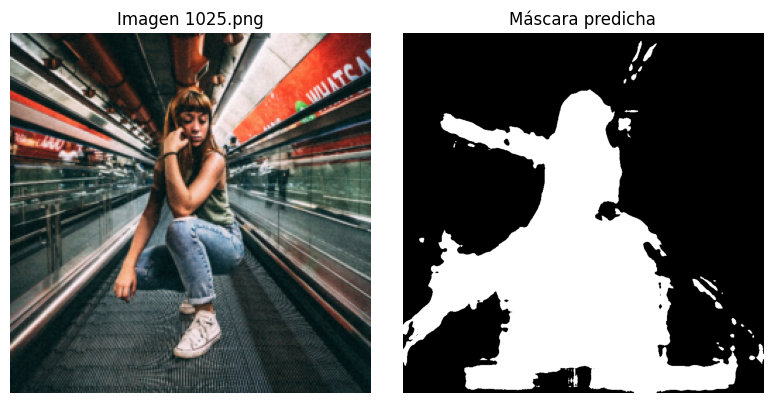

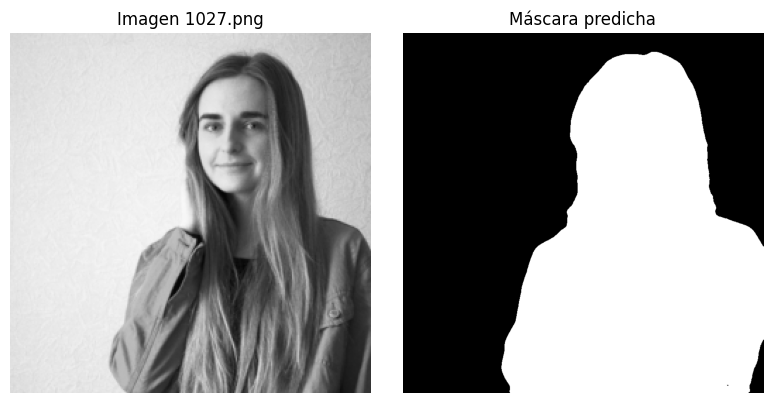

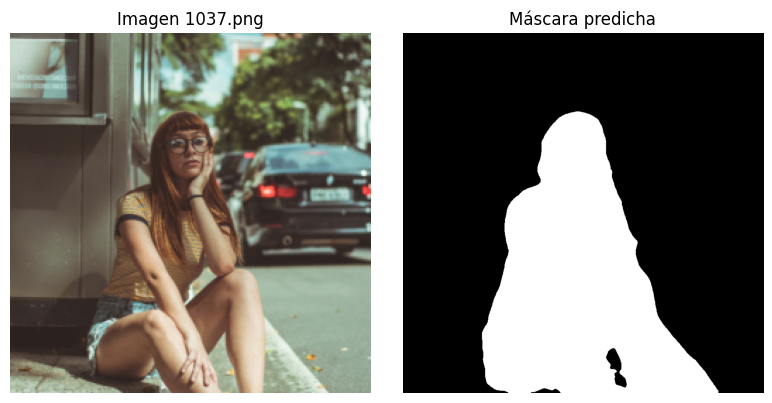

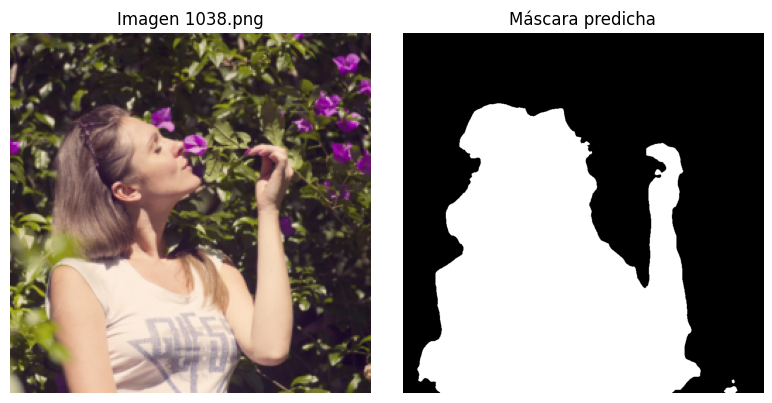

In [120]:
visualizar_test(unet_rgb_3, kaggle_loader_rgb_3, DEVICE)

In [121]:
unet_rgb_3_post = dice_on_val_with_postproc(unet_rgb_3, val_loader_rgb_3, DEVICE, threshold=0.6) # con clean mask v2
print("Dice val con postprocesado:", unet_rgb_3_post)

Dice val con postprocesado: 0.9070637734995491


In [122]:
_, _, _, kaggle_loader_rgb_3 = get_seg_dataloaders(
    root="data/train",
    batch_size=1,
    num_workers=NUM_WORKERS,
    seed=SEED,
    rgb=True,
    # Post
    train_transform_img=train_img_post_tf_rgb,
    train_transform_mask=train_mask_post_tf_rgb,
    val_transform_img=val_img_post_tf_rgb,
    val_transform_mask=val_mask_post_tf_rgb,
    # Conjuntas
    joint_transform_train=joint_transform_train_rgb,
    joint_transform_val=joint_transform_val_rgb,
)
	

predict_and_build_submission(unet_att_3, DEVICE, kaggle_loader_att_3, out_csv="unet_rgb_att_3_ubmission", use_post_proc=True)

submission guardado como: submissions/unet_rgb_att_3_ubmission_20-11-2025_04:32.csv


(           id                                     encoded_pixels
 0    1024.png  193567 15 194367 17 195166 21 195967 24 196767...
 1    1025.png  647 57 1446 59 2246 59 3046 59 3846 59 4645 61...
 2    1027.png  177536 14 178330 25 179125 33 179920 40 180715...
 3    1037.png  137478 10 138274 18 139070 25 139868 32 140665...
 4    1038.png  685 46 1485 46 2286 45 3086 46 3886 46 4686 46...
 ..        ...                                                ...
 529   971.png  63953 3 64746 11 65544 13 66341 17 67136 22 67...
 530   975.png  584 66 1383 67 2183 67 2983 68 3783 68 4582 69...
 531   987.png  471 234 1271 234 2070 235 2870 235 3670 234 44...
 532   995.png  382 386 1181 387 1981 387 2781 388 3581 387 43...
 533   999.png  213492 8 214286 20 215083 26 215880 32 216677 ...
 
 [534 rows x 2 columns],
 'submissions/unet_rgb_att_3_ubmission_20-11-2025_04:32.csv')

## Entrenando UNetAttention con padding 1 + RGB + Dropout usando Dice + BCE para el cálculo de la función de pérdida + sin data aug

In [81]:
joint_train_aug = JointSegAugment(do_flip=True, do_rotate=True, max_angle=10)
joint_val_aug   = None
train_loader_att, val_loader_dice_att, test_loader_dice_tatt, kaggle_loader_att = get_seg_dataloaders("data/train",
                                                            batch_size=BATCH_SIZE,
                                                            num_workers=NUM_WORKERS,
                                                            seed=SEED,
                                                            rgb=True,
                                                            train_transform_img=base_img_tf,
                                                            train_transform_mask=base_mask_tf,
                                                            val_transform_img=base_img_tf,
                                                            val_transform_mask=val_transform_mask_rgb,
                                                            joint_transform_train=joint_train_aug,
                                                            joint_transform_val=joint_val_aug)

In [82]:
unet_att = UNetAttention(
    n_class=1,
    n_channels=3,    
    padding=1,
    use_bn=False,    
    dropout=0.3,
    use_attention=True
).to(DEVICE)
criterion_att = combined_loss
optimizer_att = torch.optim.Adam(unet_att.parameters(), lr=1e-5)
 
epoch_train_errors_att, epoch_val_errors_att = train(unet_att, optimizer_att, criterion_att,
                                                 train_loader_att, val_loader_dice_att, DEVICE,
                                                 do_early_stopping=True, patience=10, epochs=200, log_every=5)

Epoch: 002 | Train Loss: 0.67573 | Val Loss: 0.65192
Epoch: 005 | Train Loss: 0.60133 | Val Loss: 0.57451
Epoch: 010 | Train Loss: 0.55756 | Val Loss: 0.51720
Epoch: 015 | Train Loss: 0.52057 | Val Loss: 0.48381
Epoch: 020 | Train Loss: 0.49513 | Val Loss: 0.45903
Epoch: 025 | Train Loss: 0.48300 | Val Loss: 0.44992
Epoch: 030 | Train Loss: 0.46838 | Val Loss: 0.43345
Epoch: 035 | Train Loss: 0.46048 | Val Loss: 0.41831
Epoch: 040 | Train Loss: 0.45203 | Val Loss: 0.40633
Epoch: 045 | Train Loss: 0.44163 | Val Loss: 0.40507
Epoch: 050 | Train Loss: 0.42856 | Val Loss: 0.38997
Epoch: 055 | Train Loss: 0.42171 | Val Loss: 0.38061
Epoch: 060 | Train Loss: 0.41483 | Val Loss: 0.37429
Epoch: 065 | Train Loss: 0.40928 | Val Loss: 0.36885
Epoch: 070 | Train Loss: 0.39582 | Val Loss: 0.35923
Epoch: 075 | Train Loss: 0.38660 | Val Loss: 0.36620
Epoch: 080 | Train Loss: 0.38385 | Val Loss: 0.35518
Epoch: 085 | Train Loss: 0.37687 | Val Loss: 0.34685
Epoch: 090 | Train Loss: 0.37065 | Val Loss: 0

Accuracy: 0.8742
Dice: 0.8184


Reporte de clasificación:

              precision      recall      f1-score     support        dice    
no-persona       0.93         0.86         0.89       8531764.0              
persona           0.8          0.9         0.85       5492940.0              
accuracy                                   0.87                              
macro avg        0.87         0.88         0.87      14024704.0      0.82    
weighted avg     0.88         0.87         0.88      14024704.0      0.82    
1                                                                    0.82    



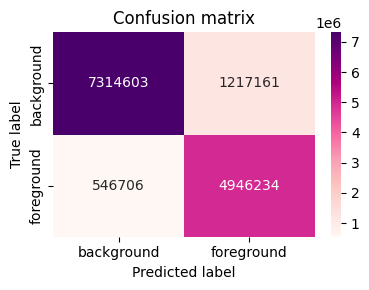

In [105]:
acc, rep, cm = model_segmentation_report(
    unet_att, test_loader_dice_tatt, DEVICE, NUM_CLASES,
    do_confusion_matrix=True, show_dice_loss=True
)

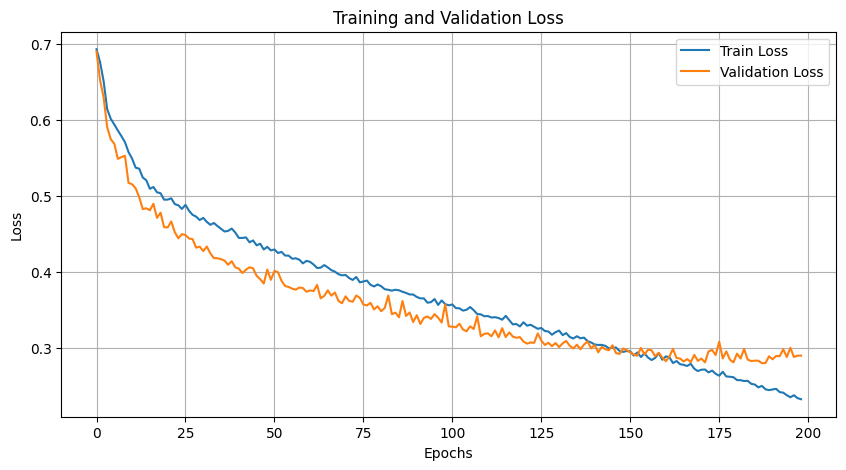

In [106]:
plot_training(epoch_train_errors_att, epoch_val_errors_att)

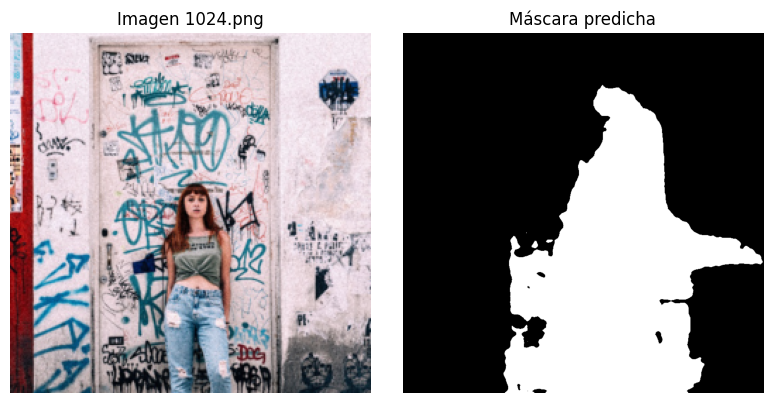

In [107]:
visualizar_test(unet_att, kaggle_loader_att, DEVICE)

In [108]:
_, _, _, kaggle_loader_att = get_seg_dataloaders("data/train",
                                                            batch_size=1,
                                                            num_workers=NUM_WORKERS,
                                                            seed=SEED,
                                                            rgb=True,
                                                            train_transform_img=base_img_tf,
                                                            train_transform_mask=base_mask_tf,
                                                            val_transform_img=base_img_tf,
                                                            val_transform_mask=val_transform_mask_rgb,
                                                            joint_transform_train=joint_train_aug,
                                                            joint_transform_val=joint_val_aug)

predict_and_build_submission(unet_att, DEVICE, kaggle_loader_att, out_csv="unet_rgb_att_submission")

submission guardado como: submissions/unet_rgb_att_submission_18-11-2025_16:19.csv


(           id                                     encoded_pixels
 0    1024.png  178358 1 179155 7 179954 10 180711 5 180752 14...
 1    1025.png  697 104 1497 104 2296 105 3096 105 3895 106 46...
 2    1027.png  179920 20 180715 30 181510 47 182307 57 183104...
 3    1037.png  21058 4 21858 5 22658 5 23458 5 24258 5 25058 ...
 4    1038.png  9511 1 10309 4 11108 6 11907 8 12707 9 13506 1...
 ..        ...                                                ...
 529   971.png  8799 2 9599 2 10398 3 11196 5 11995 6 12794 7 ...
 530   975.png  597 21 1397 21 2196 23 2996 23 3795 25 4594 26...
 531   987.png  313 62 468 49 522 58 582 7 621 25 647 28 1113 ...
 532   995.png  51560 2 51608 4 52358 5 52406 7 53157 8 53204 ...
 533   999.png  207101 12 207885 32 208681 41 209475 52 210270...
 
 [534 rows x 2 columns],
 'submissions/unet_rgb_att_submission_18-11-2025_16:19.csv')

### Pruebas luego del entrenamiento

Para ver si mejora:

1: probamos barrido de threshold porque estamos usando 0.5 para decidir si hay persona o no y tal vez no sea el mejor valor.

In [112]:
import torch
import torch.nn.functional as F
import numpy as np

def collect_probs_and_targets(model, val_loader, device):
    """
    Recorre el loader de validación y devuelve:
    - probs: tensor (N,1,H,W) con probabilidades sigmoide
    - targets: tensor (N,1,H,W) con máscaras 0/1
    """
    model.eval()
    all_probs = []
    all_targets = []

    with torch.no_grad():
        for x, y in val_loader:
            x = x.to(device)
            y = y.to(device).float()  # nos aseguramos float para operaciones

            # forward
            logits = model(x)  # (B,1,h',w')

            # redimensionar si fuera necesario
            if logits.shape[-2:] != y.shape[-2:]:
                logits = F.interpolate(
                    logits,
                    size=y.shape[-2:],
                    mode="bilinear",
                    align_corners=False,
                )

            probs = torch.sigmoid(logits)  # (B,1,H,W)

            # aseguramos que target tenga canal
            if y.ndim == 3:
                y = y.unsqueeze(1)

            all_probs.append(probs.cpu())
            all_targets.append(y.cpu())

    all_probs = torch.cat(all_probs, dim=0)
    all_targets = torch.cat(all_targets, dim=0)
    return all_probs, all_targets


def dice_from_probs(probs, targets, threshold):
    """
    Calcula Dice global sobre todo el set de validación
    para un threshold dado.
    probs, targets: (N,1,H,W)
    """
    # binarizar
    preds = (probs > threshold).float()

    # aplanar
    preds_f = preds.view(-1)
    targets_f = targets.view(-1)

    inter = (preds_f * targets_f).sum()
    union = preds_f.sum() + targets_f.sum()

    dice = (2.0 * inter + 1e-7) / (union + 1e-7)
    return dice.item()


In [113]:
# 1) juntar todas las probs y máscaras de validación una sola vez
probs_val, targets_val = collect_probs_and_targets(
    unet_att,          # tu modelo Attention U-Net
    val_loader_dice_att,
    DEVICE,
)

# 2) barrer thresholds y medir Dice
thresholds = np.linspace(0.2, 0.8, 13)  # 0.20, 0.25, ..., 0.80
best_t = None
best_dice = -1.0

for t in thresholds:
    d = dice_from_probs(probs_val, targets_val, t)
    print(f"threshold = {t:.2f} -> Dice val = {d:.4f}")
    if d > best_dice:
        best_dice = d
        best_t = t

print("\nMejor threshold en validación:")
print(f"t* = {best_t:.3f}, Dice_val = {best_dice:.4f}")


threshold = 0.20 -> Dice val = 0.8334
threshold = 0.25 -> Dice val = 0.8378
threshold = 0.30 -> Dice val = 0.8406
threshold = 0.35 -> Dice val = 0.8426
threshold = 0.40 -> Dice val = 0.8439
threshold = 0.45 -> Dice val = 0.8452
threshold = 0.50 -> Dice val = 0.8462
threshold = 0.55 -> Dice val = 0.8467
threshold = 0.60 -> Dice val = 0.8468
threshold = 0.65 -> Dice val = 0.8464
threshold = 0.70 -> Dice val = 0.8453
threshold = 0.75 -> Dice val = 0.8431
threshold = 0.80 -> Dice val = 0.8392

Mejor threshold en validación:
t* = 0.600, Dice_val = 0.8468


Accuracy: 0.8785
Dice: 0.8184


Reporte de clasificación:

              precision      recall      f1-score     support        dice    
no-persona       0.92         0.87          0.9       8531764.0              
persona          0.82         0.88         0.85       5492940.0              
accuracy                                   0.88                              
macro avg        0.87         0.88         0.87      14024704.0      0.82    
weighted avg     0.88         0.88         0.88      14024704.0      0.82    
1                                                                    0.82    



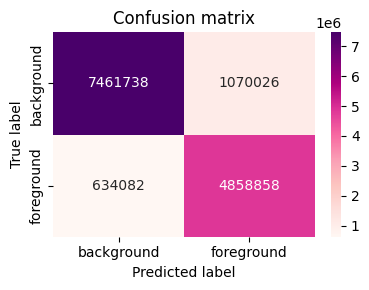

In [115]:
acc, rep, cm = model_segmentation_report(
    unet_att, test_loader_dice_tatt, DEVICE, NUM_CLASES,
    do_confusion_matrix=True, show_dice_loss=True, threshold=0.6
)

Con esta prueba confirmamos que el threshold de 0.5 no estaba mal, pero continuaremos a partir de acá con threshold 0.6.

2: Probamos postprocesado de mascaras, para verificar que el probema no sea que esten quedando con ruido o huecos sin rellenar y mejoró.

### Re entrenamos con Loss ponderada y mayor learning rate porque andaba lento

In [135]:
joint_train_aug = JointSegAugment(do_flip=True, do_rotate=True, max_angle=10)
joint_val_aug   = None
train_loader_att_2, val_loader_dice_att_2, test_loader_dice_att_2, kaggle_loader_att_2 = get_seg_dataloaders("data/train",
                                                            batch_size=BATCH_SIZE,
                                                            num_workers=NUM_WORKERS,
                                                            seed=SEED,
                                                            rgb=True,
                                                            train_transform_img=base_img_tf,
                                                            train_transform_mask=base_mask_tf,
                                                            val_transform_img=base_img_tf,
                                                            val_transform_mask=val_transform_mask_rgb,
                                                            joint_transform_train=joint_train_aug,
                                                            joint_transform_val=joint_val_aug)

In [136]:
unet_att_2 = UNetAttention(
    n_class=1,
    n_channels=3,    
    padding=1,
    use_bn=False,    
    dropout=0.3,
    use_attention=True
).to(DEVICE) # es igual a la unet_att
criterion_att_2 = combined_loss
optimizer_att_2 = torch.optim.Adam(unet_att_2.parameters(), lr=3e-5) # 
 
epoch_train_errors_att, epoch_val_errors_att = train(unet_att_2, optimizer_att_2, criterion_att_2,
                                                 train_loader_att_2, val_loader_dice_att_2, DEVICE,
                                                 do_early_stopping=True, patience=10, epochs=200, log_every=5,
                                                 checkpoint_path="models/att_2.pth", loss_ponderada=True)

Epoch: 002 | Train Loss: 0.55113 | Val Loss: 0.50139
Epoch: 005 | Train Loss: 0.45939 | Val Loss: 0.43889
Epoch: 010 | Train Loss: 0.41991 | Val Loss: 0.38713
Epoch: 015 | Train Loss: 0.39674 | Val Loss: 0.36744
Epoch: 020 | Train Loss: 0.37459 | Val Loss: 0.33363
Epoch: 025 | Train Loss: 0.34812 | Val Loss: 0.31679
Epoch: 030 | Train Loss: 0.32996 | Val Loss: 0.31672
Epoch: 035 | Train Loss: 0.32008 | Val Loss: 0.29525
Epoch: 040 | Train Loss: 0.30124 | Val Loss: 0.28682
Epoch: 045 | Train Loss: 0.29079 | Val Loss: 0.27164
Epoch: 050 | Train Loss: 0.27086 | Val Loss: 0.26614
Epoch: 055 | Train Loss: 0.25912 | Val Loss: 0.26588
Epoch: 060 | Train Loss: 0.24445 | Val Loss: 0.25680
Epoch: 065 | Train Loss: 0.22993 | Val Loss: 0.25681
Epoch: 070 | Train Loss: 0.21043 | Val Loss: 0.25655
Epoch: 075 | Train Loss: 0.19407 | Val Loss: 0.26794
Detener entrenamiento en la época 75, la mejor pérdida fue 0.25384


Accuracy: 0.8753
Dice: 0.8132


Reporte de clasificación:

              precision      recall      f1-score     support        dice    
no-persona        0.9          0.9          0.9       8531764.0              
persona          0.84         0.84         0.84       5492940.0              
accuracy                                   0.88                              
macro avg        0.87         0.87         0.87      14024704.0      0.81    
weighted avg     0.88         0.88         0.88      14024704.0      0.81    
1                                                                    0.81    



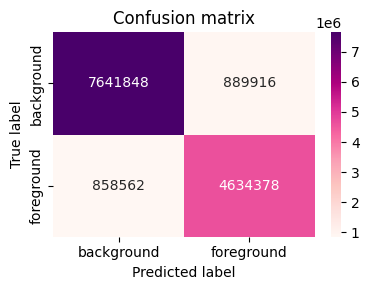

In [137]:
acc, rep, cm = model_segmentation_report(
    unet_att_2, test_loader_dice_att_2, DEVICE, NUM_CLASES,
    do_confusion_matrix=True, show_dice_loss=True
)

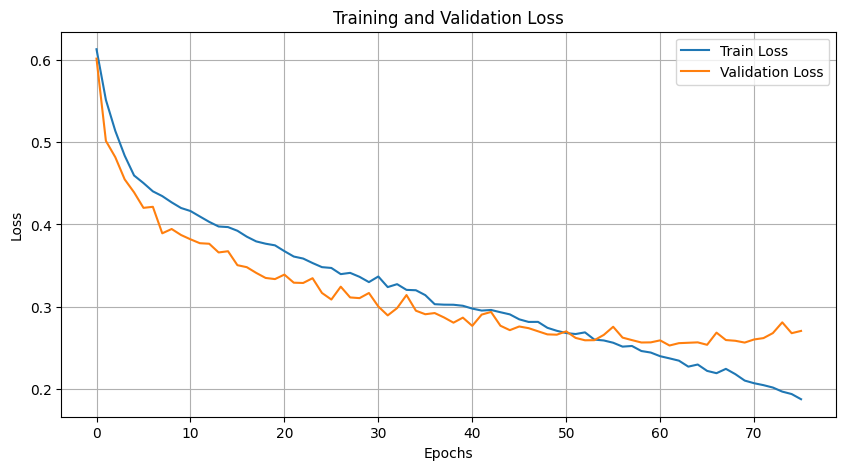

In [138]:
plot_training(epoch_train_errors_att, epoch_val_errors_att)

In [139]:
_, _, _, kaggle_loader_att_2 = get_seg_dataloaders("data/train",
                                                            batch_size=1,
                                                            num_workers=NUM_WORKERS,
                                                            seed=SEED,
                                                            rgb=True,
                                                            train_transform_img=base_img_tf,
                                                            train_transform_mask=base_mask_tf,
                                                            val_transform_img=base_img_tf,
                                                            val_transform_mask=val_transform_mask_rgb,
                                                            joint_transform_train=joint_train_aug,
                                                            joint_transform_val=joint_val_aug)

predict_and_build_submission(unet_att_2, DEVICE, kaggle_loader_att_2, out_csv="unet_rgb_att_2_submission")

submission guardado como: submissions/unet_rgb_att_2_submission_18-11-2025_19:25.csv


(           id                                     encoded_pixels
 0    1024.png  195999 2 196770 6 196797 4 197572 3 197597 4 1...
 1    1025.png  649 30 699 102 1449 30 1499 102 1836 6 2247 33...
 2    1027.png  183921 11 184712 30 185505 56 186300 69 187096...
 3    1037.png  145529 10 146324 29 147119 38 147875 7 147904 ...
 4    1038.png  702 13 1502 13 2302 14 3101 15 3901 16 4700 17...
 ..        ...                                                ...
 529   971.png  59955 2 60752 7 61549 12 62348 14 63146 16 639...
 530   975.png  589 38 1389 38 2188 40 2987 42 3787 43 4586 44...
 531   987.png  488 13 1288 13 2085 17 2883 20 3682 22 4482 22...
 532   995.png  349 16 1149 16 1948 17 2747 19 3546 20 3608 4 ...
 533   999.png  211082 19 211879 27 212677 33 213475 37 214272...
 
 [534 rows x 2 columns],
 'submissions/unet_rgb_att_2_submission_18-11-2025_19:25.csv')

In [145]:
predict_and_build_submission(unet_att_2, DEVICE, kaggle_loader_att_2, out_csv="unet_rgb_att_2_submission", threshold=0.6)

submission guardado como: submissions/unet_rgb_att_2_submission_18-11-2025_23:34.csv


(           id                                     encoded_pixels
 0    1024.png  209549 6 209566 6 210347 28 211145 30 211944 3...
 1    1025.png  703 98 1503 98 2301 100 3064 9 3100 101 3860 1...
 2    1027.png  184722 6 185510 33 186303 59 187100 68 187895 ...
 3    1037.png  147126 13 147920 32 148706 51 149475 7 149500 ...
 4    1038.png  2305 7 3104 9 3903 11 4703 11 5502 12 6302 12 ...
 ..        ...                                                ...
 529   971.png  67147 13 67911 4 67939 24 68709 8 68735 29 695...
 530   975.png  593 30 1393 30 2191 34 2990 36 3789 38 4588 39...
 531   987.png  3690 10 4488 12 5287 14 6085 17 6884 18 7683 2...
 532   995.png  357 3 1157 3 1953 9 2752 11 3550 14 4349 15 51...
 533   999.png  211884 16 212681 22 213479 28 214276 35 215074...
 
 [534 rows x 2 columns],
 'submissions/unet_rgb_att_2_submission_18-11-2025_23:34.csv')

## Entrenando UNetAttention con la misma config y transforms que nuestro mayor resultado

(Celda Ahora con batch_norm y dropout)

In [29]:
train_loader_att_3, val_loader_att_3, test_loader_att_3, kaggle_loader_att_3 = get_seg_dataloaders("data/train",
                                                            batch_size=BATCH_SIZE,
                                                            num_workers=NUM_WORKERS,
                                                            seed=SEED,
                                                            rgb=True,
                                                            train_transform_img=base_img_tf,
                                                            train_transform_mask=base_mask_tf,
                                                            val_transform_img=base_img_tf,
                                                            val_transform_mask=base_mask_tf)														

In [30]:
unet_att_3 = UNet(n_class=1, n_channels=3, padding=1, use_bn=True, dropout=0.3).to(DEVICE)
criterion_att_3 = combined_loss
optimizer_att_3 = torch.optim.Adam(unet_att_3.parameters(), lr=1e-4)
 
epoch_train_errors_att_3, epoch_val_errors_att_3 = train(unet_att_3, optimizer_att_3, criterion_att_3,
                                                 train_loader_att_3, val_loader_att_3, DEVICE,
                                                 do_early_stopping=True, patience=10, epochs=100, log_every=5,
                                                checkpoint_path="models/unet_att_3.pth", loss_ponderada=True)											
										

Epoch: 002 | Train Loss: 0.47061 | Val Loss: 0.59753
Epoch: 005 | Train Loss: 0.42128 | Val Loss: 0.41421
Epoch: 010 | Train Loss: 0.37476 | Val Loss: 0.32820
Epoch: 015 | Train Loss: 0.33564 | Val Loss: 0.29102
Epoch: 020 | Train Loss: 0.31045 | Val Loss: 0.26753
Epoch: 025 | Train Loss: 0.28542 | Val Loss: 0.23939
Epoch: 030 | Train Loss: 0.27488 | Val Loss: 0.22465
Epoch: 035 | Train Loss: 0.25989 | Val Loss: 0.21548
Epoch: 040 | Train Loss: 0.24214 | Val Loss: 0.19802
Epoch: 045 | Train Loss: 0.22634 | Val Loss: 0.18758
Epoch: 050 | Train Loss: 0.21666 | Val Loss: 0.18259
Epoch: 055 | Train Loss: 0.20136 | Val Loss: 0.18194
Epoch: 060 | Train Loss: 0.19394 | Val Loss: 0.16968
Epoch: 065 | Train Loss: 0.18150 | Val Loss: 0.16374
Epoch: 070 | Train Loss: 0.17084 | Val Loss: 0.16231
Epoch: 075 | Train Loss: 0.16529 | Val Loss: 0.15742
Epoch: 080 | Train Loss: 0.16209 | Val Loss: 0.15649
Epoch: 085 | Train Loss: 0.14954 | Val Loss: 0.14750
Epoch: 090 | Train Loss: 0.14723 | Val Loss: 0

Accuracy: 0.9253
Dice: 0.8856


Reporte de clasificación:

              precision      recall      f1-score     support        dice    
no-persona       0.97          0.9         0.94       8531764.0              
persona          0.87         0.96         0.91       5492940.0              
accuracy                                   0.93                              
macro avg        0.92         0.93         0.92      14024704.0      0.89    
weighted avg     0.93         0.93         0.93      14024704.0      0.89    
1                                                                    0.89    



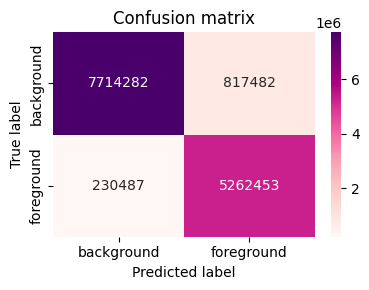

In [32]:
acc, rep, cm = model_segmentation_report(
    unet_att_3, test_loader_att_3, DEVICE, NUM_CLASES,
    do_confusion_matrix=True, show_dice_loss=True
)

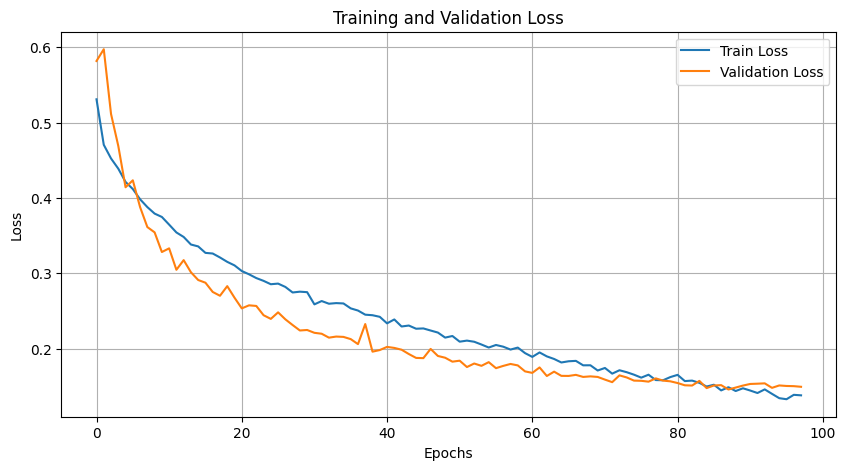

In [33]:
plot_training(epoch_train_errors_att_3, epoch_val_errors_att_3)

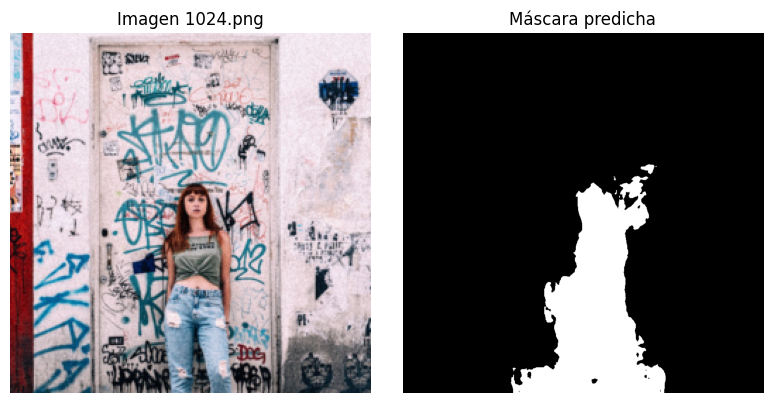

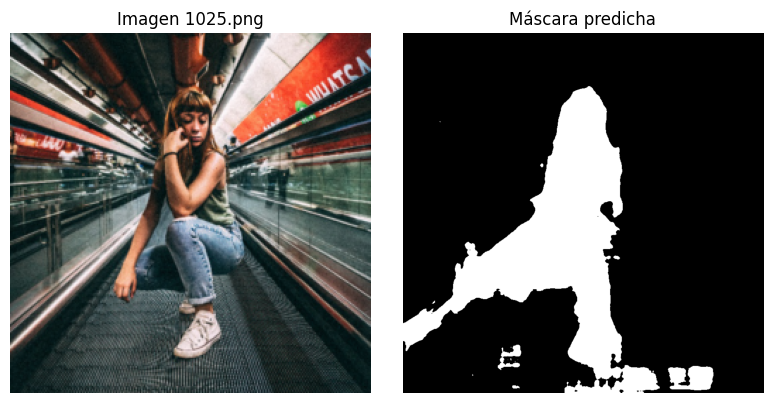

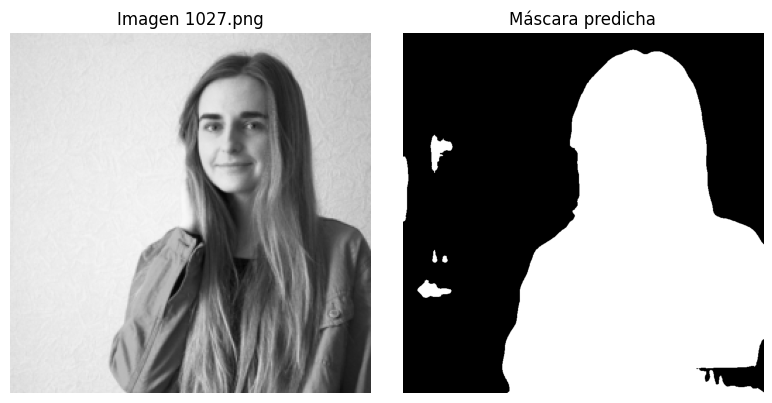

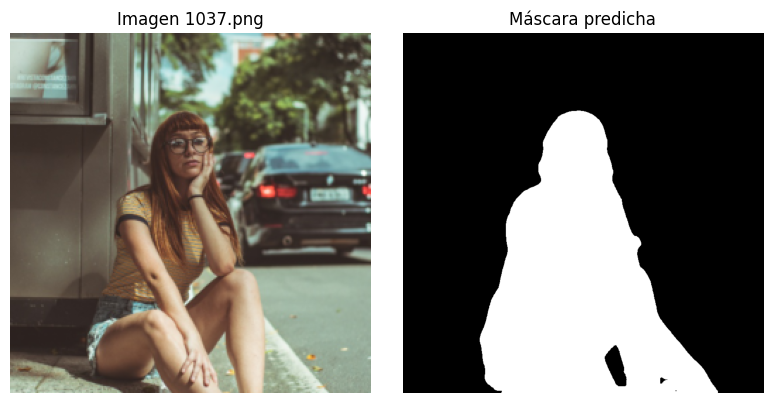

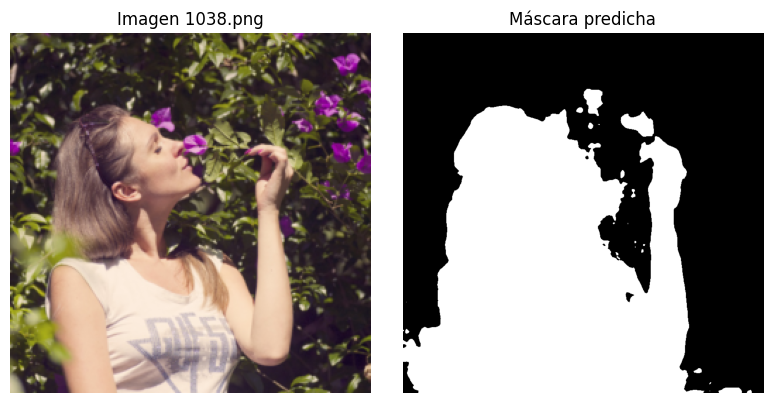

In [34]:
visualizar_test(unet_att_3, kaggle_loader_att_3, DEVICE)

In [37]:
unet_att_3_post = dice_on_val_with_postproc(unet_att_3, val_loader_att_3, DEVICE, threshold=0.6, min_size=50) # con clean mask v1
print("Dice val con postprocesado:", unet_att_3_post)

Dice val con postprocesado: 0.9096471025513557


In [96]:
unet_att_3_post = dice_on_val_with_postproc(unet_att_3, val_loader_att_3, DEVICE, threshold=0.6) # con clean mask v2
print("Dice val con postprocesado:", unet_att_3_post)

Dice val con postprocesado: 0.9137671381982669


In [97]:
_, _, _, kaggle_loader_att_3 = get_seg_dataloaders("data/train",
                                                            batch_size=1,
                                                            num_workers=NUM_WORKERS,
                                                            seed=SEED,
                                                            rgb=True,
                                                            train_transform_img=base_img_tf,
                                                            train_transform_mask=base_mask_tf,
                                                            val_transform_img=base_img_tf,
                                                            val_transform_mask=base_mask_tf)	

predict_and_build_submission(unet_att_3, DEVICE, kaggle_loader_att_3, out_csv="unet_rgb_att_3_ubmission", use_post_proc=True)

submission guardado como: submissions/unet_rgb_att_3_ubmission_19-11-2025_20:50.csv


(           id                                     encoded_pixels
 0    1024.png  193567 15 194367 17 195166 21 195967 24 196767...
 1    1025.png  647 57 1446 59 2246 59 3046 59 3846 59 4645 61...
 2    1027.png  177536 14 178330 25 179125 33 179920 40 180715...
 3    1037.png  137478 10 138274 18 139070 25 139868 32 140665...
 4    1038.png  685 46 1485 46 2286 45 3086 46 3886 46 4686 46...
 ..        ...                                                ...
 529   971.png  63953 3 64746 11 65544 13 66341 17 67136 22 67...
 530   975.png  584 66 1383 67 2183 67 2983 68 3783 68 4582 69...
 531   987.png  471 234 1271 234 2070 235 2870 235 3670 234 44...
 532   995.png  382 386 1181 387 1981 387 2781 388 3581 387 43...
 533   999.png  213492 8 214286 20 215083 26 215880 32 216677 ...
 
 [534 rows x 2 columns],
 'submissions/unet_rgb_att_3_ubmission_19-11-2025_20:50.csv')

In [ ]:
visualizar_test(unet_rgb_22, kaggle_loader_rgb_2, DEVICE)


In [63]:
predict_and_build_submission(unet_rgb_22, DEVICE, kaggle_loader_rgb_2, out_csv="unet_rgb_LR_submission")

mask shape: torch.Size([8, 1, 800, 800])
batch shape: 8 range: range(0, 8)
mask shape: torch.Size([8, 1, 800, 800])
batch shape: 8 range: range(0, 8)
mask shape: torch.Size([8, 1, 800, 800])
batch shape: 8 range: range(0, 8)
mask shape: torch.Size([8, 1, 800, 800])
batch shape: 8 range: range(0, 8)
mask shape: torch.Size([8, 1, 800, 800])
batch shape: 8 range: range(0, 8)
mask shape: torch.Size([8, 1, 800, 800])
batch shape: 8 range: range(0, 8)
mask shape: torch.Size([8, 1, 800, 800])
batch shape: 8 range: range(0, 8)
mask shape: torch.Size([8, 1, 800, 800])
batch shape: 8 range: range(0, 8)
mask shape: torch.Size([8, 1, 800, 800])
batch shape: 8 range: range(0, 8)
mask shape: torch.Size([8, 1, 800, 800])
batch shape: 8 range: range(0, 8)
mask shape: torch.Size([8, 1, 800, 800])
batch shape: 8 range: range(0, 8)
mask shape: torch.Size([8, 1, 800, 800])
batch shape: 8 range: range(0, 8)
mask shape: torch.Size([8, 1, 800, 800])
batch shape: 8 range: range(0, 8)
mask shape: torch.Size([8

(           id                                     encoded_pixels
 0    1024.png  182396 5 183195 6 183994 7 184793 8 185592 9 1...
 1    1025.png  657 25 1457 25 2255 28 3053 30 3852 31 4651 32...
 2    1027.png  172496 12 172509 6 173292 26 174070 12 174087 ...
 3    1037.png  138276 9 139072 16 139869 23 140666 46 141464 ...
 4    1038.png  15165 4 15964 11 16764 14 17564 14 18365 14 19...
 ..        ...                                                ...
 529   971.png  33598 3 34397 4 35196 5 35996 5 36795 6 37595 ...
 530   975.png  589 79 1389 79 2189 79 2988 81 3787 82 4586 82...
 531   987.png  470 268 1270 268 2070 268 2870 269 3670 269 44...
 532   995.png  379 3 387 354 791 10 1179 3 1187 354 1591 10 1...
 533   999.png  213489 13 214285 21 215082 26 215878 33 216676...
 
 [534 rows x 2 columns],
 'submissions/unet_rgb_LR_submission_20-11-2025_07:56.csv')

In [ ]:
dice_post = dice_on_val_with_postproc(unet_rgb_22, val_loader_rgb_2, DEVICE, threshold=0.6) # con clean mask v2
print("Dice val con postprocesado:", dice_post = dice_on_val_with_postproc(unet_rgb_22, val_loader_rgb_2, DEVICE, threshold=0.6) # con clean mask v2
)

Dice val con postprocesado: 0.9153304689024605


In [ ]:
predict_and_build_submission(unet_rgb_22, DEVICE, kaggle_loader_rgb_2, out_csv="unet_rgb_LR_post_submission", use_post_proc=True, debug=True)

## CROP

In [44]:
train_loader_crop, val_loader_crop, test_loader_crop, kaggle_loader_crop = get_seg_dataloaders(
    "data/train",
    batch_size=BATCH_SIZE, num_workers=NUM_WORKERS, seed=SEED, rgb=True,
    train_transform_img=base_img_tf,
    train_transform_mask=base_mask_tf,
    val_transform_img=base_img_tf,
    val_transform_mask=base_mask_tf,
    use_person_crop=True,
)

unet_crop = UNet(n_class=1, n_channels=3, padding=1, use_bn=True, dropout=0.3).to(DEVICE)
criterion_crop = combined_loss


optimizer = torch.optim.Adam(unet_crop.parameters(), lr=0.005, weight_decay=1e-5)
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer, mode="min", factor=0.5, patience=4
)


model, _, checkpoint = restaurar_modelo(unet_crop, None, "models/unet_rgb_2.pth", DEVICE)
 
epoch_train_errors_rgb_22, epoch_val_errors_rgb_22 = train(
    unet_crop, optimizer, criterion_crop, train_loader_crop, val_loader_crop, DEVICE, scheduler=scheduler,
    do_early_stopping=False, patience=10, epochs=100, log_every=1
)

Epoch: 001 | Train Loss: 0.55961 | Val Loss: 0.60382 | Current LR: 0.00500
Epoch: 002 | Train Loss: 0.54104 | Val Loss: 0.50810 | Current LR: 0.00500
Epoch: 003 | Train Loss: 0.52277 | Val Loss: 0.46955 | Current LR: 0.00500
Epoch: 004 | Train Loss: 0.48349 | Val Loss: 0.49545 | Current LR: 0.00500
Epoch: 005 | Train Loss: 0.48352 | Val Loss: 0.44668 | Current LR: 0.00500
Epoch: 006 | Train Loss: 0.47386 | Val Loss: 0.43308 | Current LR: 0.00500
Epoch: 007 | Train Loss: 0.46648 | Val Loss: 0.51468 | Current LR: 0.00500
Epoch: 008 | Train Loss: 0.46142 | Val Loss: 0.42600 | Current LR: 0.00500
Epoch: 009 | Train Loss: 0.45604 | Val Loss: 0.42311 | Current LR: 0.00500
Epoch: 010 | Train Loss: 0.45476 | Val Loss: 0.43210 | Current LR: 0.00500
Epoch: 011 | Train Loss: 0.45422 | Val Loss: 0.41131 | Current LR: 0.00500
Epoch: 012 | Train Loss: 0.44325 | Val Loss: 0.40425 | Current LR: 0.00500
Epoch: 013 | Train Loss: 0.44277 | Val Loss: 0.43243 | Current LR: 0.00500
Epoch: 014 | Train Loss: 

Accuracy: 0.9119
Dice: 0.8649


Reporte de clasificación:

              precision      recall      f1-score     support        dice    
no-persona       0.95         0.91         0.93       8531764.0              
persona          0.86         0.92         0.89       5492940.0              
accuracy                                   0.91                              
macro avg        0.91         0.91         0.91      14024704.0      0.86    
weighted avg     0.91         0.91         0.91      14024704.0      0.86    
1                                                                    0.86    



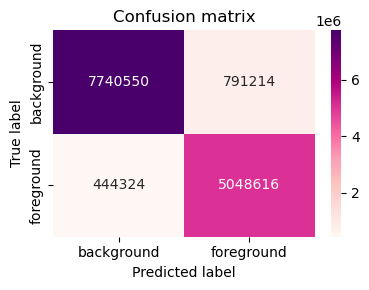

In [46]:
acc, rep, cm = model_segmentation_report(
    unet_crop, test_loader_crop, DEVICE, NUM_CLASES, do_confusion_matrix=True, show_dice_loss=True
)

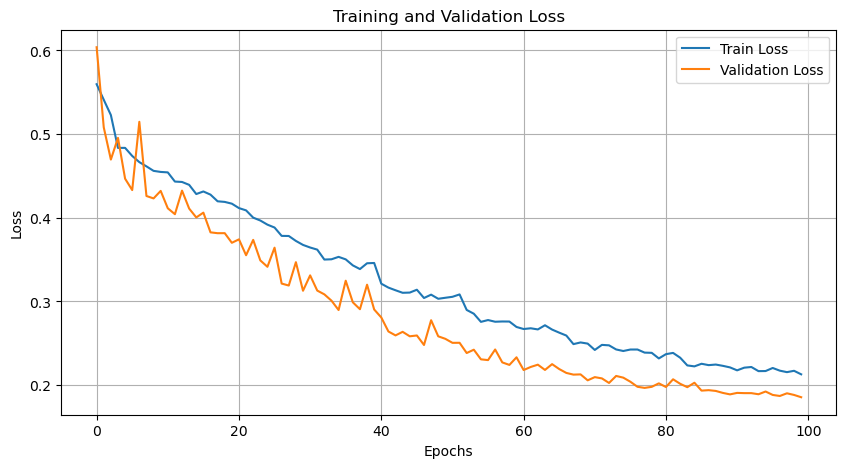

In [47]:
plot_training(epoch_train_errors_rgb_22, epoch_val_errors_rgb_22)

/var/folders/s2/p5yczv2s3gv32c5qs90gpnh00000gn/T/ipykernel_3484/3840026845.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.detach().clone() or sourceTensor.detach().clone().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mean = torch.tensor(mean).view(-1, 1, 1)
/var/folders/s2/p5yczv2s3gv32c5qs90gpnh00000gn/T/ipykernel_3484/3840026845.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.detach().clone() or sourceTensor.detach().clone().requires_grad_(True), rather than torch.tensor(sourceTensor).
  std  = torch.tensor(std).view(-1, 1, 1)


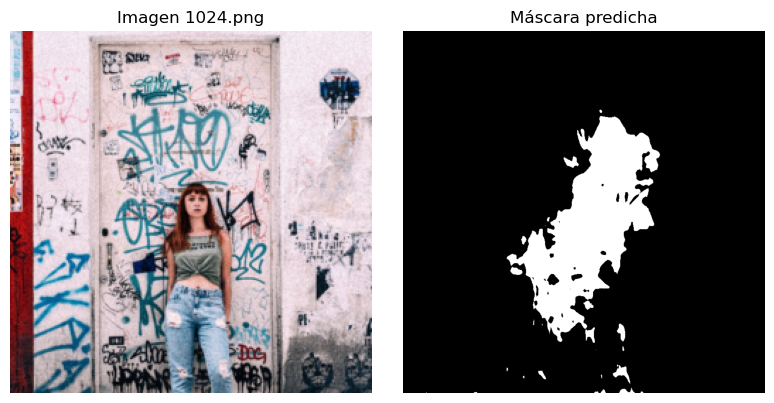

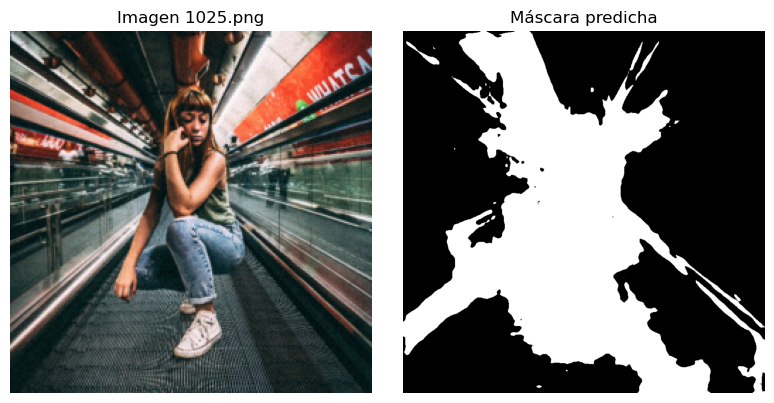

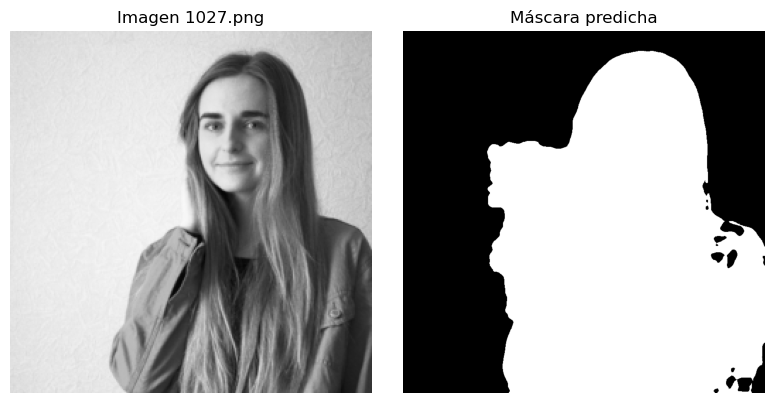

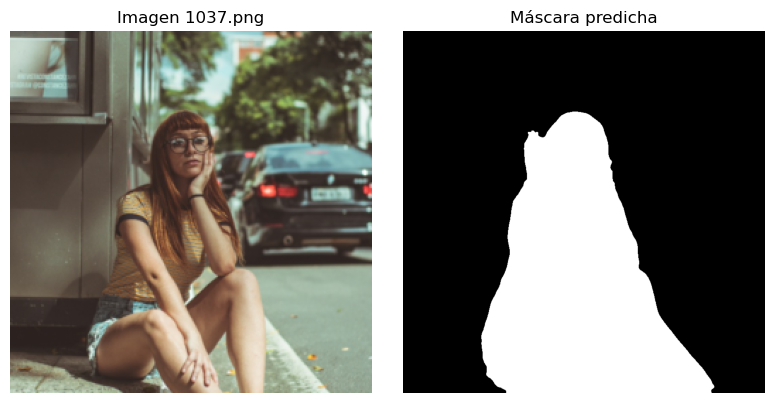

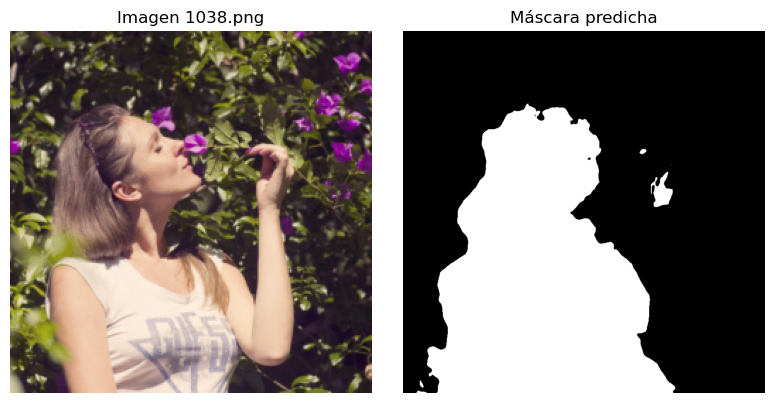

In [48]:
visualizar_test(unet_crop, kaggle_loader_crop, DEVICE)


In [51]:
train_loader_crop, val_loader_crop, test_loader_crop, kaggle_loader_crop = get_seg_dataloaders(
    "data/train",
    batch_size=BATCH_SIZE, num_workers=NUM_WORKERS, seed=SEED, rgb=True,
    train_transform_img=base_img_tf,
    train_transform_mask=base_mask_tf,
    val_transform_img=base_img_tf,
    val_transform_mask=base_mask_tf,
    use_person_crop=True,
    crop_p=0.3
)

unet_crop = UNet(n_class=1, n_channels=3, padding=1, use_bn=True, dropout=0.3).to(DEVICE)
criterion_crop = combined_loss


optimizer = torch.optim.Adam(unet_crop.parameters(), lr=0.004, weight_decay=1e-5)
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer, mode="min", factor=0.5, patience=2
)


model, _, checkpoint = restaurar_modelo(unet_crop, None, "models/unet_rgb_2.pth", DEVICE)
 
epoch_train_errors_rgb_22, epoch_val_errors_rgb_22 = train(
    unet_crop, optimizer, criterion_crop, train_loader_crop, val_loader_crop, DEVICE, scheduler=scheduler,
    do_early_stopping=False, patience=10, epochs=120, log_every=1
)

Epoch: 001 | Train Loss: 0.52853 | Val Loss: 0.47793 | Current LR: 0.00400
Epoch: 002 | Train Loss: 0.48506 | Val Loss: 0.43827 | Current LR: 0.00400
Epoch: 003 | Train Loss: 0.47543 | Val Loss: 0.44185 | Current LR: 0.00400
Epoch: 004 | Train Loss: 0.45999 | Val Loss: 0.42411 | Current LR: 0.00400
Epoch: 005 | Train Loss: 0.45392 | Val Loss: 0.41774 | Current LR: 0.00400
Epoch: 006 | Train Loss: 0.45245 | Val Loss: 0.42639 | Current LR: 0.00400
Epoch: 007 | Train Loss: 0.44668 | Val Loss: 0.40493 | Current LR: 0.00400
Epoch: 008 | Train Loss: 0.43375 | Val Loss: 0.40704 | Current LR: 0.00400
Epoch: 009 | Train Loss: 0.43909 | Val Loss: 0.41088 | Current LR: 0.00400
Epoch: 010 | Train Loss: 0.43056 | Val Loss: 0.39480 | Current LR: 0.00400
Epoch: 011 | Train Loss: 0.42331 | Val Loss: 0.39666 | Current LR: 0.00400
Epoch: 012 | Train Loss: 0.42202 | Val Loss: 0.39568 | Current LR: 0.00400
Epoch: 013 | Train Loss: 0.41750 | Val Loss: 0.41288 | Current LR: 0.00200
Epoch: 014 | Train Loss: 

Accuracy: 0.9209
Dice: 0.8772


Reporte de clasificación:

              precision      recall      f1-score     support        dice    
no-persona       0.96          0.9         0.93       8531764.0              
persona          0.86         0.95          0.9       5492940.0              
accuracy                                   0.92                              
macro avg        0.91         0.93         0.92      14024704.0      0.88    
weighted avg     0.92         0.92         0.92      14024704.0      0.88    
1                                                                    0.88    



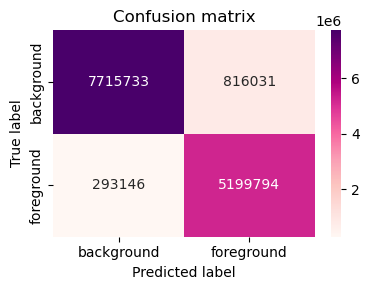

In [52]:
acc, rep, cm = model_segmentation_report(
    unet_crop, test_loader_crop, DEVICE, NUM_CLASES, do_confusion_matrix=True, show_dice_loss=True
)

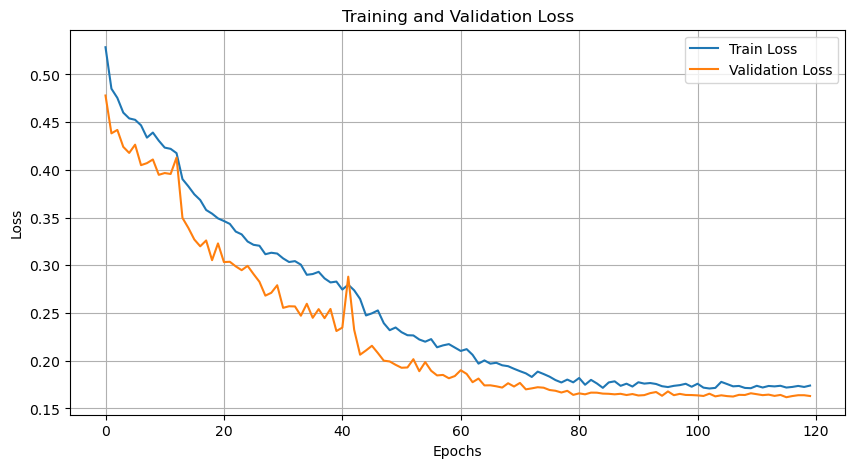

In [53]:
plot_training(epoch_train_errors_rgb_22, epoch_val_errors_rgb_22)

/var/folders/s2/p5yczv2s3gv32c5qs90gpnh00000gn/T/ipykernel_3484/3840026845.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.detach().clone() or sourceTensor.detach().clone().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mean = torch.tensor(mean).view(-1, 1, 1)
/var/folders/s2/p5yczv2s3gv32c5qs90gpnh00000gn/T/ipykernel_3484/3840026845.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.detach().clone() or sourceTensor.detach().clone().requires_grad_(True), rather than torch.tensor(sourceTensor).
  std  = torch.tensor(std).view(-1, 1, 1)


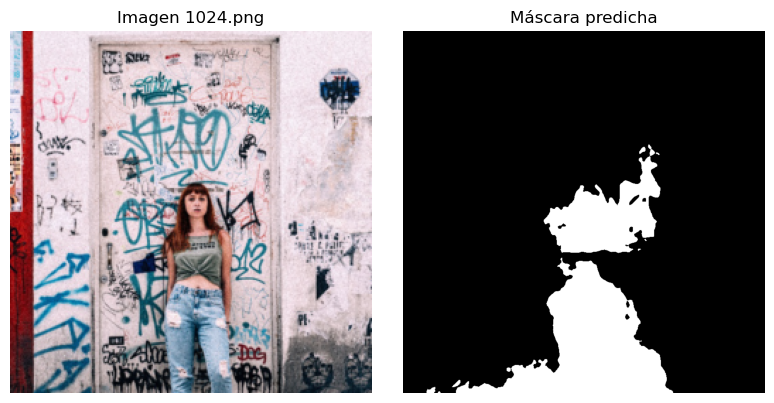

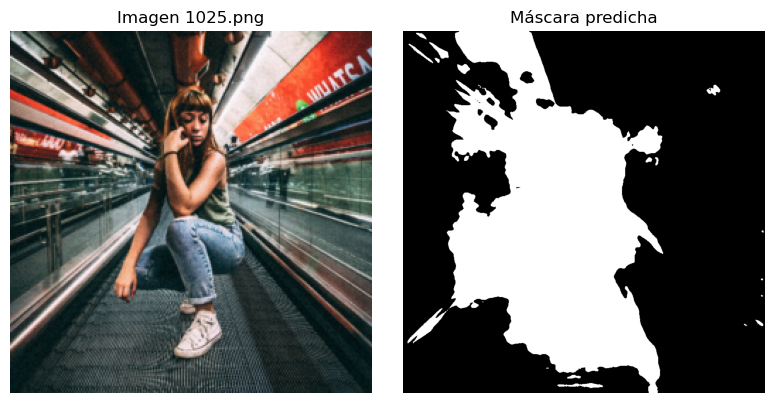

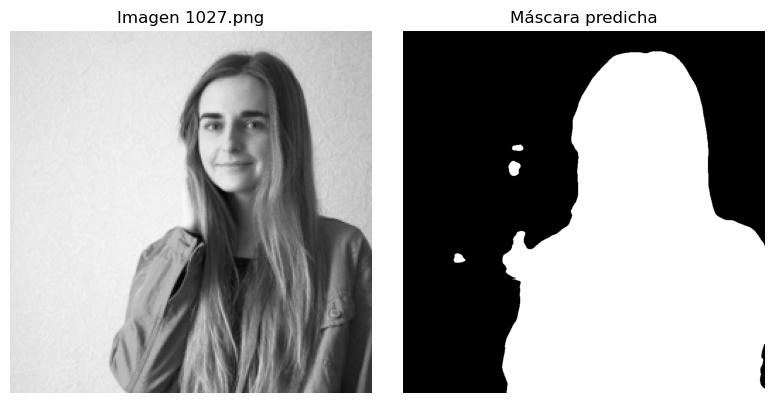

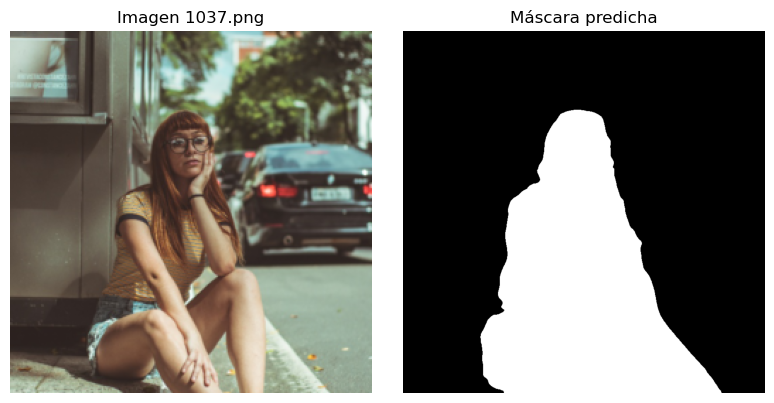

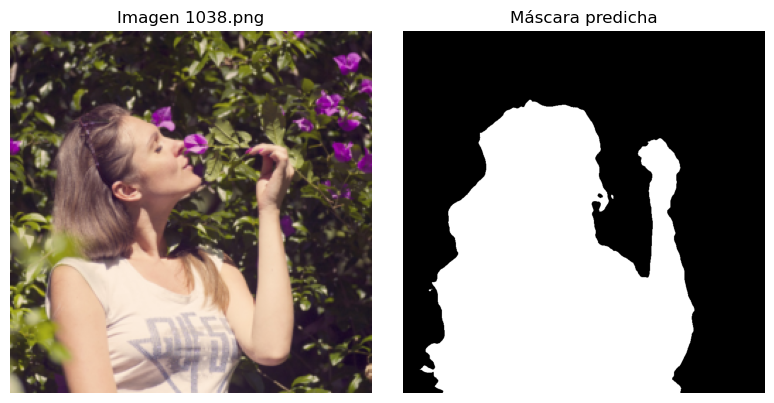

In [54]:
visualizar_test(unet_crop, kaggle_loader_crop, DEVICE)


In [56]:
predict_and_build_submission(unet_crop, DEVICE, kaggle_loader_crop, out_csv="unet_crop_submission")

mask shape: torch.Size([8, 1, 800, 800])
batch shape: 8 range: range(0, 8)
mask shape: torch.Size([8, 1, 800, 800])
batch shape: 8 range: range(0, 8)
mask shape: torch.Size([8, 1, 800, 800])
batch shape: 8 range: range(0, 8)
mask shape: torch.Size([8, 1, 800, 800])
batch shape: 8 range: range(0, 8)
mask shape: torch.Size([8, 1, 800, 800])
batch shape: 8 range: range(0, 8)
mask shape: torch.Size([8, 1, 800, 800])
batch shape: 8 range: range(0, 8)
mask shape: torch.Size([8, 1, 800, 800])
batch shape: 8 range: range(0, 8)
mask shape: torch.Size([8, 1, 800, 800])
batch shape: 8 range: range(0, 8)
mask shape: torch.Size([8, 1, 800, 800])
batch shape: 8 range: range(0, 8)
mask shape: torch.Size([8, 1, 800, 800])
batch shape: 8 range: range(0, 8)
mask shape: torch.Size([8, 1, 800, 800])
batch shape: 8 range: range(0, 8)
mask shape: torch.Size([8, 1, 800, 800])
batch shape: 8 range: range(0, 8)
mask shape: torch.Size([8, 1, 800, 800])
batch shape: 8 range: range(0, 8)
mask shape: torch.Size([8

(           id                                     encoded_pixels
 0    1024.png  42396 5 43194 7 43992 9 44793 8 45593 8 46394 ...
 1    1025.png  8686 5 9484 7 9630 1 10283 7 10429 3 11081 8 1...
 2    1027.png  90105 4 90902 9 91695 17 92494 19 93293 20 940...
 3    1037.png  137475 5 138270 20 139068 25 139866 34 140664 ...
 4    1038.png  30349 1 31149 1 31948 2 32746 4 33546 4 34345 ...
 ..        ...                                                ...
 529   971.png  119112 6 119896 26 120688 36 121486 40 122284 ...
 530   975.png  2216 5 3004 20 3801 25 4599 29 5396 38 6194 41...
 531   987.png  469 212 1269 212 2068 217 2866 221 3665 223 44...
 532   995.png  489 78 581 7 618 48 788 13 1289 78 1381 7 1418...
 533   999.png  32361 8 33158 12 33955 16 34753 18 35550 21 36...
 
 [534 rows x 2 columns],
 'submissions/unet_crop_submission_21-11-2025_20:33.csv')

## Bloque con convolucion doble

In [74]:
train_loader_dc, val_loader_dc, test_loader_dc, kaggle_loader_dc = get_seg_dataloaders(
    "data/train",
    batch_size=BATCH_SIZE, num_workers=NUM_WORKERS, seed=SEED, rgb=True,
    train_transform_img=base_img_tf,
    train_transform_mask=base_mask_tf,
    val_transform_img=base_img_tf,
    val_transform_mask=base_mask_tf,  
)

unet_dc = UNet(n_class=1, n_channels=3, padding=1, use_bn=True, dropout=0.3, double_conv=True).to(DEVICE)
criterion_dc = combined_loss


optimizer = torch.optim.Adam(unet_dc.parameters(), lr=1e-4, weight_decay=1e-5)
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer, mode="min", factor=0.5, patience=4
)


# model, _, checkpoint = restaurar_modelo(unet_dc, None, "models/unet_rgb_2.pth", DEVICE)
 
epoch_train_errors_rgb_22, epoch_val_errors_rgb_22 = train(
    unet_dc, optimizer, criterion_dc, train_loader_dc, val_loader_dc, DEVICE, scheduler=scheduler,
    do_early_stopping=False, patience=10, epochs=100, log_every=1,
    checkpoint_path="models/unet_dc.pth", 
    loss_ponderada=True
)

Epoch: 001 | Train Loss: 0.51231 | Val Loss: 0.49338 | Current LR: 0.0001000000
Epoch: 002 | Train Loss: 0.44785 | Val Loss: 0.41132 | Current LR: 0.0001000000
Epoch: 003 | Train Loss: 0.42270 | Val Loss: 0.41408 | Current LR: 0.0001000000
Epoch: 004 | Train Loss: 0.40040 | Val Loss: 0.41661 | Current LR: 0.0001000000
Epoch: 005 | Train Loss: 0.38305 | Val Loss: 0.36334 | Current LR: 0.0001000000
Epoch: 006 | Train Loss: 0.37119 | Val Loss: 0.38100 | Current LR: 0.0001000000
Epoch: 007 | Train Loss: 0.36060 | Val Loss: 0.32698 | Current LR: 0.0001000000
Epoch: 008 | Train Loss: 0.34438 | Val Loss: 0.32335 | Current LR: 0.0001000000
Epoch: 009 | Train Loss: 0.33525 | Val Loss: 0.30438 | Current LR: 0.0001000000
Epoch: 010 | Train Loss: 0.31802 | Val Loss: 0.27976 | Current LR: 0.0001000000
Epoch: 011 | Train Loss: 0.30969 | Val Loss: 0.29081 | Current LR: 0.0001000000
Epoch: 012 | Train Loss: 0.29827 | Val Loss: 0.25286 | Current LR: 0.0001000000
Epoch: 013 | Train Loss: 0.28682 | Val L

Accuracy: 0.9454
Dice: 0.9129


Reporte de clasificación:

              precision      recall      f1-score     support        dice    
no-persona       0.96         0.95         0.95       8531764.0              
persona          0.92         0.94         0.93       5492940.0              
accuracy                                   0.95                              
macro avg        0.94         0.95         0.94      14024704.0      0.91    
weighted avg     0.95         0.95         0.95      14024704.0      0.91    
1                                                                    0.91    



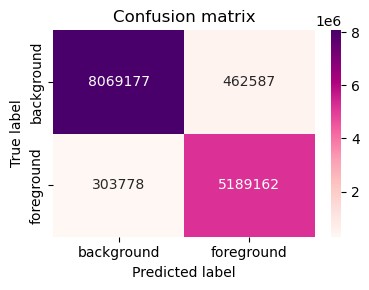

In [75]:
acc, rep, cm = model_segmentation_report(
    unet_dc, test_loader_dc, DEVICE, NUM_CLASES, do_confusion_matrix=True, show_dice_loss=True
)

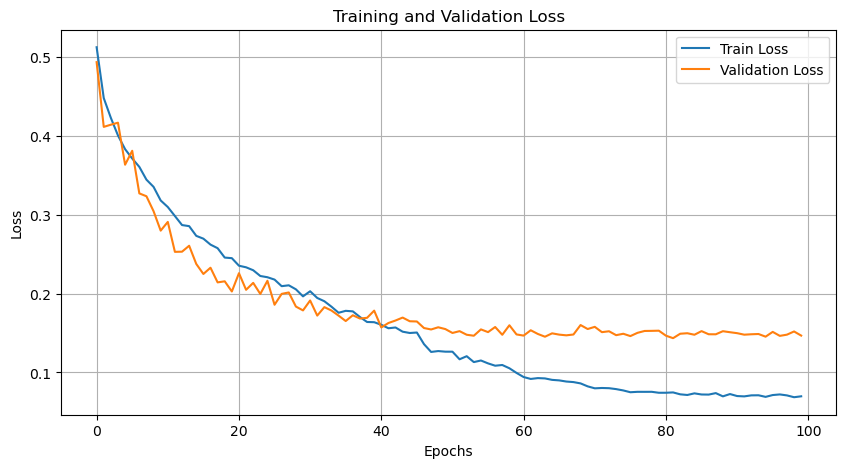

In [76]:
plot_training(epoch_train_errors_rgb_22, epoch_val_errors_rgb_22)

/var/folders/s2/p5yczv2s3gv32c5qs90gpnh00000gn/T/ipykernel_3484/3840026845.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.detach().clone() or sourceTensor.detach().clone().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mean = torch.tensor(mean).view(-1, 1, 1)
/var/folders/s2/p5yczv2s3gv32c5qs90gpnh00000gn/T/ipykernel_3484/3840026845.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.detach().clone() or sourceTensor.detach().clone().requires_grad_(True), rather than torch.tensor(sourceTensor).
  std  = torch.tensor(std).view(-1, 1, 1)


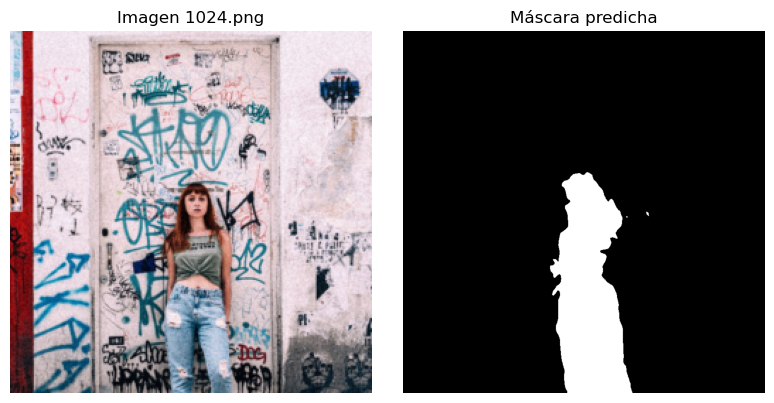

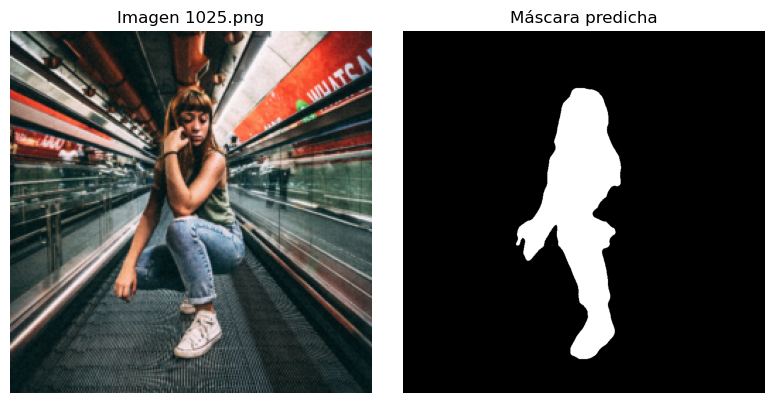

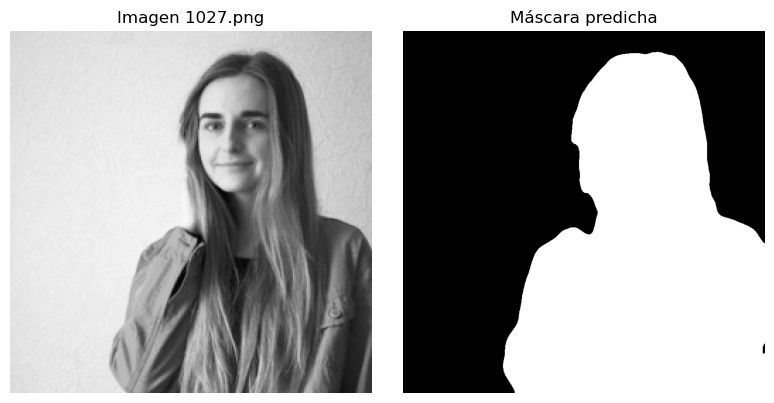

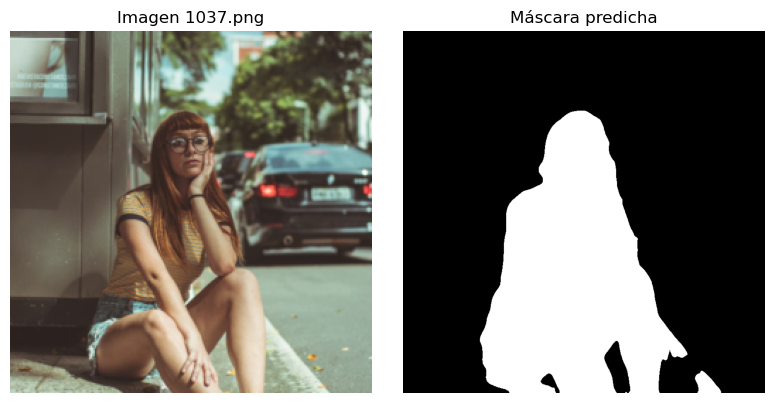

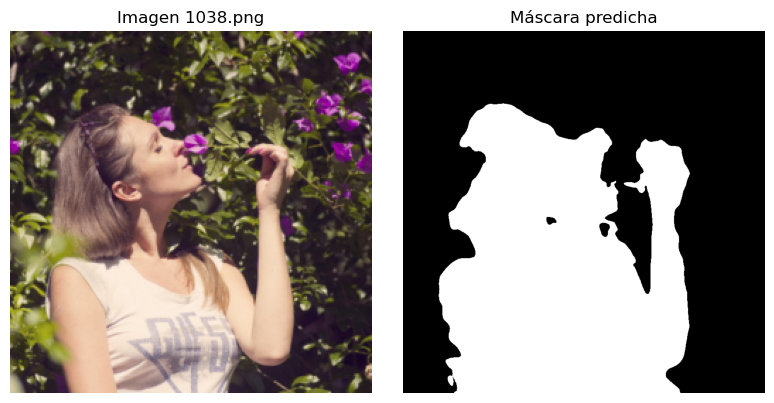

In [78]:
visualizar_test(unet_dc, kaggle_loader_dc, DEVICE)


In [77]:
predict_and_build_submission(unet_dc, DEVICE, kaggle_loader_dc, out_csv="unet_double_conv_submission", use_post_proc=True)

submission guardado como: submissions/unet_double_conv_submission_22-11-2025_09:33.csv


(           id                                     encoded_pixels
 0    1024.png  261321 7 262121 11 262920 13 263720 14 264519 ...
 1    1025.png  201269 4 202067 6 202847 6 202865 9 203642 14 ...
 2    1027.png  178335 11 179129 23 179924 31 180719 39 181504...
 3    1037.png  137479 9 138275 15 139073 20 139871 24 140669 ...
 4    1038.png  64557 5 64582 7 65349 47 66144 55 66942 59 677...
 ..        ...                                                ...
 529   971.png  69529 7 70329 7 71128 9 71927 10 72726 12 7352...
 530   975.png  589 62 1388 63 2188 63 2988 63 3788 62 4587 63...
 531   987.png  474 169 1273 170 2073 169 2873 170 3673 170 44...
 532   995.png  339 256 1138 257 1938 257 2738 257 3538 256 43...
 533   999.png  213492 7 214286 18 215084 22 215881 27 216679 ...
 
 [534 rows x 2 columns],
 'submissions/unet_double_conv_submission_22-11-2025_09:33.csv')

In [ ]:
train_loader_up, val_loader_up, test_loader_up, kaggle_loader_up = get_seg_dataloaders(
    "data/train",
    batch_size=BATCH_SIZE, num_workers=NUM_WORKERS, seed=SEED, rgb=True,
    train_transform_img=base_img_tf,
    train_transform_mask=base_mask_tf,
    val_transform_img=base_img_tf,
    val_transform_mask=base_mask_tf,  
)

unet_up = UNet(n_class=1, n_channels=3, padding=1, use_bn=True, dropout=0.3, double_conv=True, use_upsample=True).to(DEVICE)
criterion_up = combined_loss


optimizer = torch.optim.Adam(unet_up.parameters(), lr=1e-4, weight_decay=1e-5)
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer, mode="min", factor=0.5, patience=4
)


model, _, checkpoint = restaurar_modelo(unet_up, None, "models/unet_dc.pth", DEVICE)
 
epoch_train_errors_rgb_22, epoch_val_errors_rgb_22 = train(
    unet_up, optimizer, criterion_up, train_loader_up, val_loader_up, DEVICE, scheduler=scheduler,
    do_early_stopping=True, patience=10, epochs=200, log_every=5,
    checkpoint_path="models/unet_up.pth", 
    loss_ponderada=True
)

Epoch: 002 | Train Loss: 0.11176 | Val Loss: 0.14180 | Current LR: 0.0001000000
Epoch: 005 | Train Loss: 0.10696 | Val Loss: 0.16568 | Current LR: 0.0001000000
Epoch: 010 | Train Loss: 0.08677 | Val Loss: 0.14818 | Current LR: 0.0000500000
Epoch: 015 | Train Loss: 0.07226 | Val Loss: 0.15088 | Current LR: 0.0000250000
Epoch: 020 | Train Loss: 0.06197 | Val Loss: 0.15106 | Current LR: 0.0000125000


Accuracy: 0.9487
Dice: 0.9192


Reporte de clasificación:

              precision      recall      f1-score     support        dice    
no-persona       0.96         0.95         0.96       8531764.0              
persona          0.93         0.94         0.94       5492940.0              
accuracy                                   0.95                              
macro avg        0.95         0.95         0.95      14024704.0      0.92    
weighted avg     0.95         0.95         0.95      14024704.0      0.92    
1                                                                    0.92    



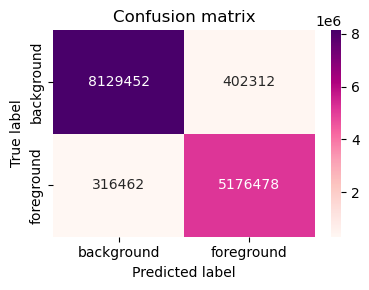

In [81]:
acc, rep, cm = model_segmentation_report(
    unet_up, test_loader_up, DEVICE, NUM_CLASES, do_confusion_matrix=True, show_dice_loss=True
)

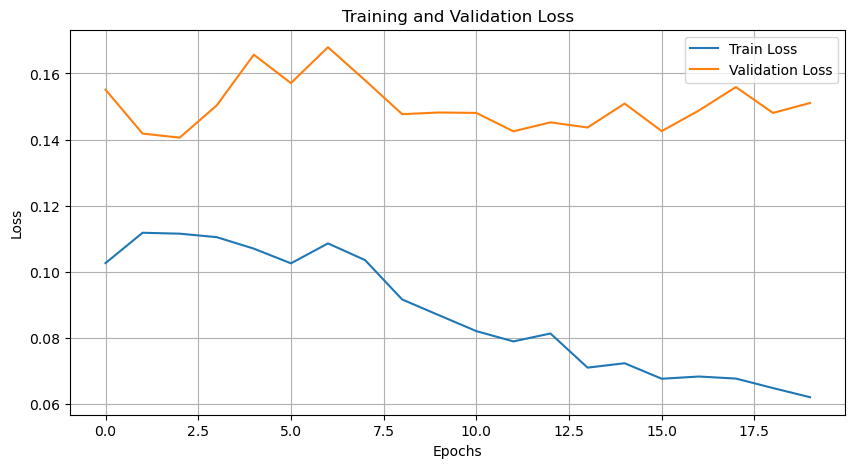

In [82]:
plot_training(epoch_train_errors_rgb_22, epoch_val_errors_rgb_22)

In [95]:
unet_up_post = dice_on_val_with_postproc(unet_up, val_loader_up, DEVICE, threshold=0.6) # con clean mask v2
print("Dice val con postprocesado:", unet_up_post)

Dice val con postprocesado: 0.9131129421010531


In [ ]:
predict_and_build_submission(unet_up, DEVICE, kaggle_loader_up, out_csv="unet_upsample_post_submission", use_post_proc=True)

submission guardado como: submissions/unet_upsample_post_submission_22-11-2025_11:57.csv


(           id                                     encoded_pixels
 0    1024.png  254967 7 255765 9 256563 12 257362 14 258161 1...
 1    1025.png  214886 4 215682 11 216476 19 217273 24 218070 ...
 2    1027.png  178332 14 179125 27 179920 34 180713 44 181499...
 3    1037.png  137482 5 138277 14 139074 19 139872 24 140670 ...
 4    1038.png  64584 7 65356 10 65374 21 66150 48 66947 52 67...
 ..        ...                                                ...
 529   971.png  26399 2 27197 4 27995 6 28786 15 29583 18 3038...
 530   975.png  590 54 1389 55 2189 55 2989 55 3789 56 4588 57...
 531   987.png  474 184 1273 184 2073 184 2873 183 3673 183 44...
 532   995.png  340 246 1139 247 1939 247 2739 247 3539 247 43...
 533   999.png  214288 15 215085 22 215882 27 216679 32 217477...
 
 [534 rows x 2 columns],
 'submissions/unet_upsample_post_submission_22-11-2025_11:57.csv')

## Focal Tversky Loss

In [86]:
train_loader_ft, val_loader_ft, test_loader_ft, kaggle_loader_ft = get_seg_dataloaders(
    "data/train",
    batch_size=BATCH_SIZE, num_workers=NUM_WORKERS, seed=SEED, rgb=True,
    train_transform_img=base_img_tf,
    train_transform_mask=base_mask_tf,
    val_transform_img=base_img_tf,
    val_transform_mask=base_mask_tf,  
)

In [89]:
# cargar modelo entrenado
unet_ft = UNet(n_class=1, n_channels=3, padding=1, use_bn=True, dropout=0.3).to(DEVICE)

unet_ft, _, _ = restaurar_modelo(unet_ft, optimizer=None, checkpoint_path="models/unet_rgb_2.pth", device=DEVICE)

optimizer_ft = torch.optim.Adam(unet_ft.parameters(), lr=1e-4, weight_decay=1e-5)
scheduler_ft = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer_ft, mode="min", factor=0.5, patience=4)

criterion_ft = FocalTverskyLoss(alpha=0.5, beta=0.7, gamma=0.75)
# criterion = FocalTverskyLoss(alpha=0.5, beta=0.6, gamma=0.75)

epoch_train_ft, epoch_val_ft = train(
    unet_ft,
    optimizer,
    criterion_ft,
    train_loader_ft,
    val_loader_ft,
    DEVICE,
    scheduler=scheduler,
    do_early_stopping=False,
    epochs=20,
    log_every=1,
)


Epoch: 001 | Train Loss: 0.24223 | Val Loss: 0.21892 | Current LR: 0.0000125000
Epoch: 002 | Train Loss: 0.24267 | Val Loss: 0.21362 | Current LR: 0.0000125000
Epoch: 003 | Train Loss: 0.24396 | Val Loss: 0.21003 | Current LR: 0.0000062500
Epoch: 004 | Train Loss: 0.24441 | Val Loss: 0.21339 | Current LR: 0.0000062500
Epoch: 005 | Train Loss: 0.24375 | Val Loss: 0.21442 | Current LR: 0.0000062500
Epoch: 006 | Train Loss: 0.24185 | Val Loss: 0.21008 | Current LR: 0.0000062500
Epoch: 007 | Train Loss: 0.24237 | Val Loss: 0.21500 | Current LR: 0.0000062500
Epoch: 008 | Train Loss: 0.24107 | Val Loss: 0.21234 | Current LR: 0.0000031250
Epoch: 009 | Train Loss: 0.24179 | Val Loss: 0.21728 | Current LR: 0.0000031250
Epoch: 010 | Train Loss: 0.24564 | Val Loss: 0.21445 | Current LR: 0.0000031250
Epoch: 011 | Train Loss: 0.24299 | Val Loss: 0.21070 | Current LR: 0.0000031250
Epoch: 012 | Train Loss: 0.24490 | Val Loss: 0.21637 | Current LR: 0.0000031250
Epoch: 013 | Train Loss: 0.24475 | Val L

Accuracy: 0.9318
Dice: 0.8934


Reporte de clasificación:

              precision      recall      f1-score     support        dice    
no-persona       0.95         0.93         0.94       8531764.0              
persona           0.9         0.93         0.91       5492940.0              
accuracy                                   0.93                              
macro avg        0.93         0.93         0.93      14024704.0      0.89    
weighted avg     0.93         0.93         0.93      14024704.0      0.89    
1                                                                    0.89    



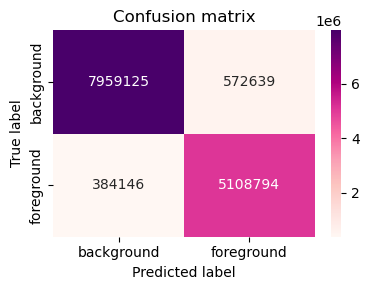

In [91]:
acc, rep, cm = model_segmentation_report(
    unet_ft, test_loader_ft, DEVICE, NUM_CLASES, do_confusion_matrix=True, show_dice_loss=True
)

In [90]:
# cargar modelo entrenado
unet_ft_2 = UNet(n_class=1, n_channels=3, padding=1, use_bn=True, dropout=0.3).to(DEVICE)

unet_ft_2, _, _ = restaurar_modelo(unet_ft_2, optimizer=None, checkpoint_path="models/unet_rgb_2.pth", device=DEVICE)

optimizer_ft_2 = torch.optim.Adam(unet_ft_2.parameters(), lr=1e-4, weight_decay=1e-5)
scheduler_ft_2 = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer_ft_2, mode="min", factor=0.5, patience=4)

# criterion_ft_2 = FocalTverskyLoss(alpha=0.5, beta=0.7, gamma=0.75)
criterion_ft_2 = FocalTverskyLoss(alpha=0.5, beta=0.6, gamma=0.75)

epoch_train_ft_2, epoch_val_ft_2 = train(
    unet_ft_2,
    optimizer,
    criterion_ft_2,
    train_loader_ft,
    val_loader_ft,
    DEVICE,
    scheduler=scheduler,
    do_early_stopping=False,
    epochs=20,
    log_every=1,
)

Epoch: 001 | Train Loss: 0.23001 | Val Loss: 0.20680 | Current LR: 0.0000007813
Epoch: 002 | Train Loss: 0.23090 | Val Loss: 0.20280 | Current LR: 0.0000007813
Epoch: 003 | Train Loss: 0.23240 | Val Loss: 0.20446 | Current LR: 0.0000003906
Epoch: 004 | Train Loss: 0.23369 | Val Loss: 0.20450 | Current LR: 0.0000003906
Epoch: 005 | Train Loss: 0.23101 | Val Loss: 0.21123 | Current LR: 0.0000003906
Epoch: 006 | Train Loss: 0.23002 | Val Loss: 0.20570 | Current LR: 0.0000003906
Epoch: 007 | Train Loss: 0.23098 | Val Loss: 0.20482 | Current LR: 0.0000003906
Epoch: 008 | Train Loss: 0.23308 | Val Loss: 0.20679 | Current LR: 0.0000001953
Epoch: 009 | Train Loss: 0.23086 | Val Loss: 0.20833 | Current LR: 0.0000001953
Epoch: 010 | Train Loss: 0.23485 | Val Loss: 0.20564 | Current LR: 0.0000001953
Epoch: 011 | Train Loss: 0.23350 | Val Loss: 0.20792 | Current LR: 0.0000001953
Epoch: 012 | Train Loss: 0.23302 | Val Loss: 0.20591 | Current LR: 0.0000001953
Epoch: 013 | Train Loss: 0.23389 | Val L

Accuracy: 0.9324
Dice: 0.8942


Reporte de clasificación:

              precision      recall      f1-score     support        dice    
no-persona       0.95         0.93         0.94       8531764.0              
persona           0.9         0.93         0.92       5492940.0              
accuracy                                   0.93                              
macro avg        0.93         0.93         0.93      14024704.0      0.89    
weighted avg     0.93         0.93         0.93      14024704.0      0.89    
1                                                                    0.89    



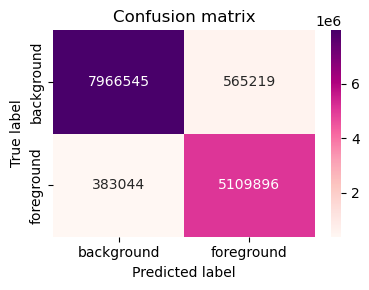

In [92]:
acc, rep, cm = model_segmentation_report(
    unet_ft_2, test_loader_ft, DEVICE, NUM_CLASES, do_confusion_matrix=True, show_dice_loss=True
)

In [93]:
# cargar modelo entrenado
unet_ft_3 = UNet(n_class=1, n_channels=3, padding=1, use_bn=True, dropout=0.3).to(DEVICE)

unet_ft_3, _, _ = restaurar_modelo(unet_ft_3, optimizer=None, checkpoint_path="models/unet_rgb_2.pth", device=DEVICE)

optimizer_ft_3 = torch.optim.Adam(unet_ft_3.parameters(), lr=1e-4, weight_decay=1e-5)
scheduler_ft_3 = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer_ft_3, mode="min", factor=0.5, patience=4)

# criterion_ft_3 = FocalTverskyLoss(alpha=0.5, beta=0.7, gamma=0.75)
criterion_ft_3 = FocalTverskyLoss(alpha=0.5, beta=0.55, gamma=1.25, eps=0)

epoch_train_ft_3, epoch_val_ft_3 = train(
    unet_ft_3,
    optimizer,
    criterion_ft_3,
    train_loader_ft,
    val_loader_ft,
    DEVICE,
    scheduler=scheduler,
    do_early_stopping=False,
    epochs=20,
    log_every=1,
)

Epoch: 001 | Train Loss: 0.10251 | Val Loss: 0.08772 | Current LR: 0.0000000488
Epoch: 002 | Train Loss: 0.10686 | Val Loss: 0.08708 | Current LR: 0.0000000488
Epoch: 003 | Train Loss: 0.10437 | Val Loss: 0.08789 | Current LR: 0.0000000488
Epoch: 004 | Train Loss: 0.10177 | Val Loss: 0.08635 | Current LR: 0.0000000488
Epoch: 005 | Train Loss: 0.10218 | Val Loss: 0.08849 | Current LR: 0.0000000488
Epoch: 006 | Train Loss: 0.10206 | Val Loss: 0.08770 | Current LR: 0.0000000488
Epoch: 007 | Train Loss: 0.10385 | Val Loss: 0.08675 | Current LR: 0.0000000488
Epoch: 008 | Train Loss: 0.10133 | Val Loss: 0.08784 | Current LR: 0.0000000488
Epoch: 009 | Train Loss: 0.10435 | Val Loss: 0.08787 | Current LR: 0.0000000244
Epoch: 010 | Train Loss: 0.10130 | Val Loss: 0.08756 | Current LR: 0.0000000244
Epoch: 011 | Train Loss: 0.10158 | Val Loss: 0.08745 | Current LR: 0.0000000244
Epoch: 012 | Train Loss: 0.10462 | Val Loss: 0.08984 | Current LR: 0.0000000244
Epoch: 013 | Train Loss: 0.10399 | Val L

Accuracy: 0.9329
Dice: 0.8949


Reporte de clasificación:

              precision      recall      f1-score     support        dice    
no-persona       0.95         0.94         0.94       8531764.0              
persona          0.91         0.92         0.92       5492940.0              
accuracy                                   0.93                              
macro avg        0.93         0.93         0.93      14024704.0      0.89    
weighted avg     0.93         0.93         0.93      14024704.0      0.89    
1                                                                    0.89    



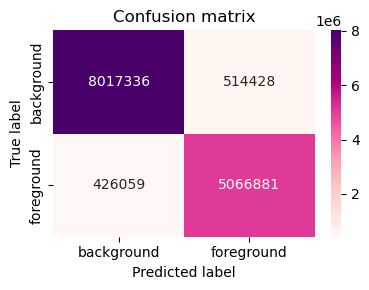

In [96]:
acc, rep, cm = model_segmentation_report(
    unet_ft_3, test_loader_ft, DEVICE, NUM_CLASES, do_confusion_matrix=True, show_dice_loss=True
)

In [99]:
# cargar modelo entrenado
unet_ft_4 = UNet(n_class=1, n_channels=3, padding=1, use_bn=True, dropout=0.3).to(DEVICE)

unet_ft_4, _, _ = restaurar_modelo(unet_ft_4, optimizer=None, checkpoint_path="models/unet_rgb_2.pth", device=DEVICE)

optimizer_ft_4 = torch.optim.Adam(unet_ft_4.parameters(), lr=5e-3, weight_decay=1e-5)
scheduler_ft_4 = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer_ft_4, mode="min", factor=0.5, patience=4)

# criterion_ft_4 = FocalTverskyLoss(alpha=0.5, beta=0.7, gamma=0.75)
criterion_ft_4 = FocalTverskyLoss(alpha=0.6, beta=0.4, gamma=1, eps=0)

epoch_train_ft_4, epoch_val_ft_4 = train(
    unet_ft_4,
    optimizer,
    criterion_ft_4,
    train_loader_ft,
    val_loader_ft,
    DEVICE,
    scheduler=scheduler,
    do_early_stopping=True,
    patience=12,
    epochs=50,
    log_every=1,
)

Epoch: 001 | Train Loss: 0.14859 | Val Loss: 0.12857 | Current LR: 0.0000000122
Epoch: 002 | Train Loss: 0.14667 | Val Loss: 0.12671 | Current LR: 0.0000000122
Epoch: 003 | Train Loss: 0.14718 | Val Loss: 0.12561 | Current LR: 0.0000000122
Epoch: 004 | Train Loss: 0.14397 | Val Loss: 0.12973 | Current LR: 0.0000000122
Epoch: 005 | Train Loss: 0.14721 | Val Loss: 0.12758 | Current LR: 0.0000000122
Epoch: 006 | Train Loss: 0.14571 | Val Loss: 0.12836 | Current LR: 0.0000000122
Epoch: 007 | Train Loss: 0.14528 | Val Loss: 0.12863 | Current LR: 0.0000000122
Epoch: 008 | Train Loss: 0.14519 | Val Loss: 0.12732 | Current LR: 0.0000000122
Epoch: 009 | Train Loss: 0.14556 | Val Loss: 0.12828 | Current LR: 0.0000000122
Epoch: 010 | Train Loss: 0.14715 | Val Loss: 0.12809 | Current LR: 0.0000000122
Epoch: 011 | Train Loss: 0.14719 | Val Loss: 0.12849 | Current LR: 0.0000000122
Epoch: 012 | Train Loss: 0.14676 | Val Loss: 0.12910 | Current LR: 0.0000000122
Epoch: 013 | Train Loss: 0.14803 | Val L

Accuracy: 0.9334
Dice: 0.8954


Reporte de clasificación:

              precision      recall      f1-score     support        dice    
no-persona       0.95         0.94         0.94       8531764.0              
persona          0.91         0.92         0.92       5492940.0              
accuracy                                   0.93                              
macro avg        0.93         0.93         0.93      14024704.0       0.9    
weighted avg     0.93         0.93         0.93      14024704.0       0.9    
1                                                                     0.9    



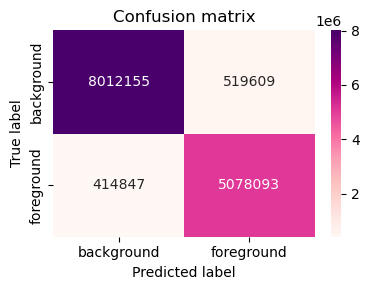

In [100]:
acc, rep, cm = model_segmentation_report(
    unet_ft_4, test_loader_ft, DEVICE, NUM_CLASES, do_confusion_matrix=True, show_dice_loss=True
)

/var/folders/s2/p5yczv2s3gv32c5qs90gpnh00000gn/T/ipykernel_3484/3840026845.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.detach().clone() or sourceTensor.detach().clone().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mean = torch.tensor(mean).view(-1, 1, 1)
/var/folders/s2/p5yczv2s3gv32c5qs90gpnh00000gn/T/ipykernel_3484/3840026845.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.detach().clone() or sourceTensor.detach().clone().requires_grad_(True), rather than torch.tensor(sourceTensor).
  std  = torch.tensor(std).view(-1, 1, 1)


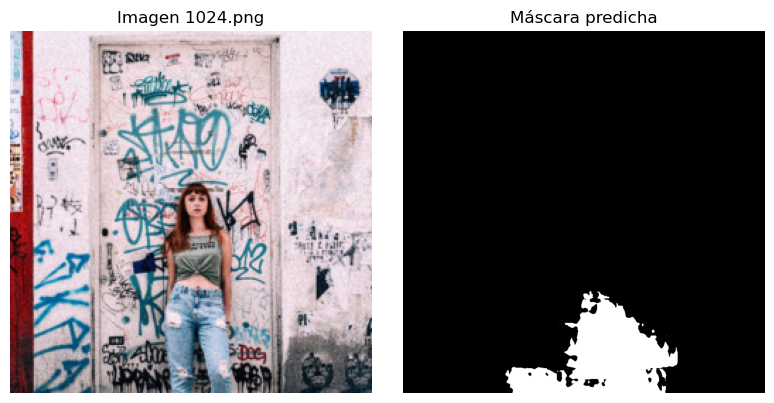

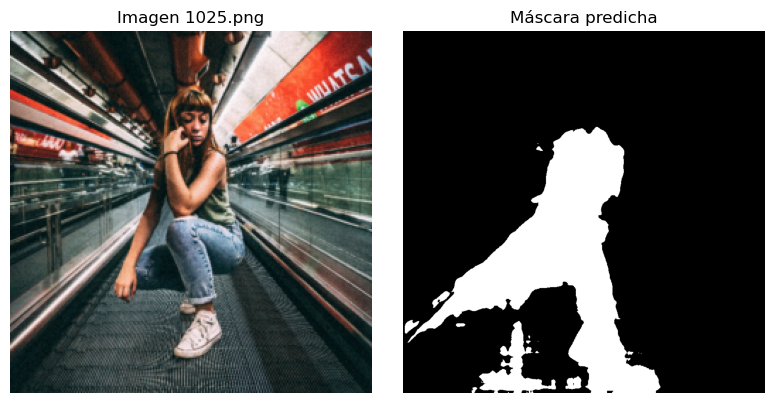

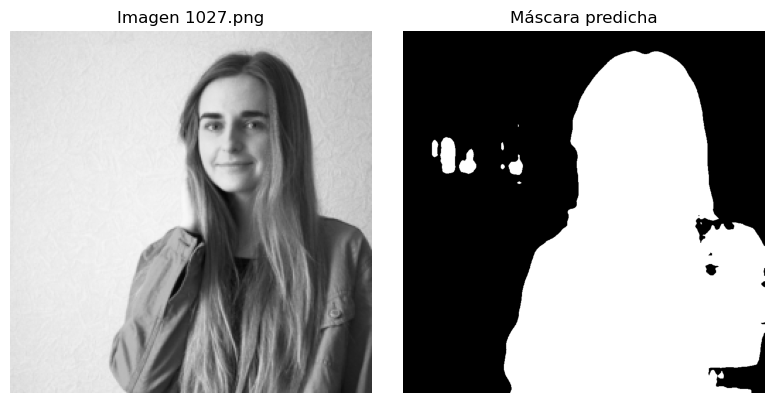

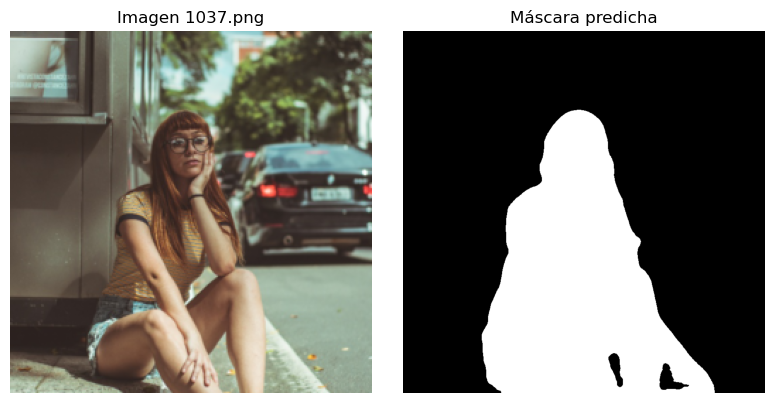

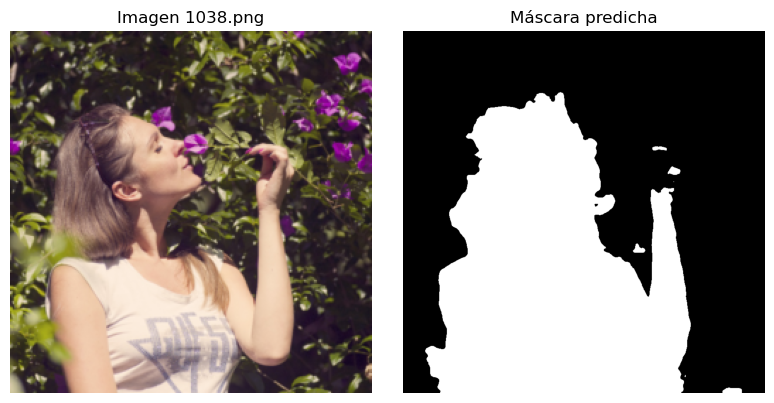

In [101]:
visualizar_test(unet_ft_4, kaggle_loader_ft, DEVICE)


In [104]:
train_loader_up, val_loader_up, test_loader_up, kaggle_loader_up = get_seg_dataloaders(
    "data/train",
    batch_size=BATCH_SIZE, num_workers=NUM_WORKERS, seed=SEED, rgb=True,
    train_transform_img=base_img_tf,
    train_transform_mask=base_mask_tf,
    val_transform_img=base_img_tf,
    val_transform_mask=base_mask_tf,  
)
unet_up = UNet(n_class=1, n_channels=3, padding=1, use_bn=True, dropout=0.3, use_upsample=True).to(DEVICE)

criterion_up = combined_loss


optimizer = torch.optim.Adam(unet_up.parameters(), lr=1e-4, weight_decay=1e-5)
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer, mode="min", factor=0.5, patience=4
)


# unet_up, _, checkpoint = restaurar_modelo(unet_up, None, "models/unet_up.pth", DEVICE)
 
epoch_train_errors_up, epoch_val_errors_up = train(
    unet_up, optimizer, criterion_up, train_loader_up, val_loader_up, DEVICE, scheduler=scheduler,
    do_early_stopping=True, patience=12, epochs=200, log_every=5,
    checkpoint_path="models/unet_up_2.pth", 
    loss_ponderada=True
)

Epoch: 002 | Train Loss: 0.47124 | Val Loss: 0.56834 | Current LR: 0.0001000000
Epoch: 005 | Train Loss: 0.42298 | Val Loss: 0.41350 | Current LR: 0.0001000000
Epoch: 010 | Train Loss: 0.36971 | Val Loss: 0.32621 | Current LR: 0.0001000000
Epoch: 015 | Train Loss: 0.33330 | Val Loss: 0.28828 | Current LR: 0.0001000000
Epoch: 020 | Train Loss: 0.30751 | Val Loss: 0.26352 | Current LR: 0.0001000000
Epoch: 025 | Train Loss: 0.28817 | Val Loss: 0.23555 | Current LR: 0.0001000000
Epoch: 030 | Train Loss: 0.26325 | Val Loss: 0.22897 | Current LR: 0.0001000000
Epoch: 035 | Train Loss: 0.25202 | Val Loss: 0.21466 | Current LR: 0.0001000000
Epoch: 040 | Train Loss: 0.23766 | Val Loss: 0.20628 | Current LR: 0.0001000000
Epoch: 045 | Train Loss: 0.22135 | Val Loss: 0.18933 | Current LR: 0.0001000000
Epoch: 050 | Train Loss: 0.21044 | Val Loss: 0.18105 | Current LR: 0.0001000000
Epoch: 055 | Train Loss: 0.20550 | Val Loss: 0.17352 | Current LR: 0.0001000000
Epoch: 060 | Train Loss: 0.18916 | Val L

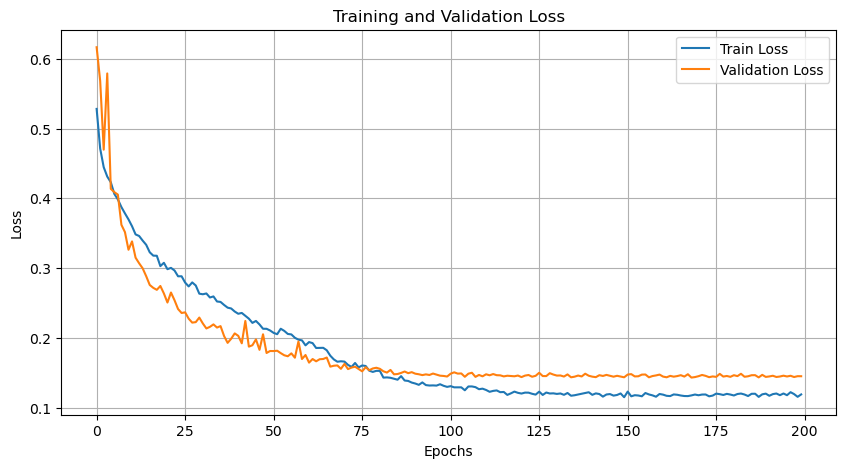

In [107]:
plot_training(epoch_train_errors_up, epoch_val_errors_up)

Accuracy: 0.9345
Dice: 0.8978


Reporte de clasificación:

              precision      recall      f1-score     support        dice    
no-persona       0.97         0.92         0.94       8531764.0              
persona          0.89         0.95         0.92       5492940.0              
accuracy                                   0.93                              
macro avg        0.93         0.94         0.93      14024704.0       0.9    
weighted avg     0.94         0.93         0.93      14024704.0       0.9    
1                                                                     0.9    



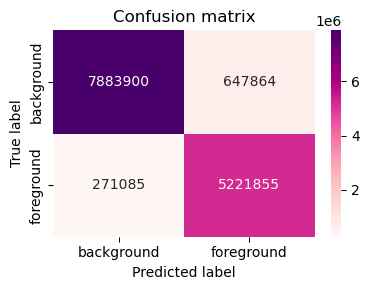

In [106]:
acc, rep, cm = model_segmentation_report(
    unet_up, test_loader_up, DEVICE, NUM_CLASES, do_confusion_matrix=True, show_dice_loss=True
)

In [105]:
train_loader_up_dc, val_loader_up_dc, test_loader_up_dc, kaggle_loader_up = get_seg_dataloaders(
    "data/train",
    batch_size=BATCH_SIZE, num_workers=NUM_WORKERS, seed=SEED, rgb=True,
    train_transform_img=base_img_tf,
    train_transform_mask=base_mask_tf,
    val_transform_img=base_img_tf,
    val_transform_mask=base_mask_tf,  
)

unet_up_dc = UNet(n_class=1, n_channels=3, padding=1, use_bn=True, dropout=0.3, double_conv=True, use_upsample=True).to(DEVICE)
criterion_up_dc = combined_loss


optimizer = torch.optim.Adam(unet_up_dc.parameters(), lr=1e-4, weight_decay=1e-5)
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer, mode="min", factor=0.5, patience=4
)


unet_up_dc, _, checkpoint = restaurar_modelo(unet_up_dc, None, "models/unet_dc.pth", DEVICE)
 
epoch_train_errors_rgb_22, epoch_val_errors_rgb_22 = train(
    unet_up_dc, optimizer, criterion_up_dc, train_loader_up_dc, val_loader_up_dc, DEVICE, scheduler=scheduler,
    do_early_stopping=True, patience=8, epochs=200, log_every=5,
    checkpoint_path="models/unet_up.pth", 
    loss_ponderada=True
)

KeyboardInterrupt: 

In [ ]:
train_loader_unet_plus_plus, val_loader_unet_plus_plus, test_loader_unet_plus_plus, kaggle_loader_unet_plus_plus = get_seg_dataloaders(
    "data/train",
    batch_size=BATCH_SIZE, num_workers=NUM_WORKERS, seed=SEED, rgb=True,
    train_transform_img=base_img_tf,
    train_transform_mask=base_mask_tf,
    val_transform_img=base_img_tf,
    val_transform_mask=base_mask_tf,  
)

unet_plus_plus = UNetPlusPlus(
    n_channels=3,
    n_classes=1,
    deep_supervision=False,   # o True si querés experimentar
    use_bn=True,
    base_ch=64,
).to(DEVICE)

criterion = combined_loss  # por ejemplo BCE + Dice o Focal Tversky
optimizer_unet_plus_plus = torch.optim.Adam(unet_plus_plus.parameters(), lr=1e-3, weight_decay=1e-5)
scheduler_unet_plus_plus = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer_unet_plus_plus, mode="min", factor=0.5, patience=4)

epoch_train_errors_unet_plus_plus, epoch_val_errors_unet_plus_plus = train(
    unet_plus_plus, optimizer_unet_plus_plus, criterion, train_loader_unet_plus_plus, val_loader_unet_plus_plus, DEVICE, scheduler=scheduler_unet_plus_plus,
    do_early_stopping=True, patience=8, epochs=80, log_every=5,
    checkpoint_path="models/unet_plus_plus.pth", 
    loss_ponderada=True
)


In [49]:
train_loader_unet_plus_drop, val_loader_unet_plus_drop, test_loader_unet_plus_drop, kaggle_loader_unet_plus_drop = get_seg_dataloaders(
    "data/train",
    batch_size=BATCH_SIZE, num_workers=NUM_WORKERS, seed=SEED, rgb=True,
    train_transform_img=base_img_tf,
    train_transform_mask=base_mask_tf,
    val_transform_img=base_img_tf,
    val_transform_mask=base_mask_tf,  
)

unet_plus_drop = UNetPlusPlus(
    n_channels=3,
    n_classes=1,
    deep_supervision=False,   # o True si querés experimentar
    use_bn=True,
    base_ch=64,
    dropout=0.3
).to(DEVICE)

criterion = combined_loss  # por ejemplo BCE + Dice o Focal Tversky
optimizer_unet_plus_drop = torch.optim.Adam(unet_plus_drop.parameters(), lr=1e-4, weight_decay=1e-5)
scheduler_unet_plus_drop = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer_unet_plus_drop, mode="min", factor=0.5, patience=4)

# unet_plus_drop, _, checkpoint = restaurar_modelo(unet_plus_drop, None, "models/unet_plus_plus_2.pth", DEVICE)


epoch_train_errors_unet_plus_drop, epoch_val_errors_unet_plus_drop = train(
    unet_plus_drop, optimizer_unet_plus_drop, criterion, train_loader_unet_plus_drop, val_loader_unet_plus_drop, DEVICE, scheduler=scheduler_unet_plus_drop,
    do_early_stopping=True, patience=15, epochs=80, log_every=5,
    checkpoint_path="models/unet_plus_drop_3.pth", 
    loss_ponderada=True
)

root: data/train
batch_size: 8
batch_size: 8
Epoch: 002 | Train Loss: 0.46926 | Val Loss: 0.86258 | Current LR: 0.00010
Epoch: 005 | Train Loss: 0.43146 | Val Loss: 0.46730 | Current LR: 0.00010
Epoch: 010 | Train Loss: 0.37584 | Val Loss: 0.34878 | Current LR: 0.00010
Epoch: 015 | Train Loss: 0.34719 | Val Loss: 0.29878 | Current LR: 0.00010
Epoch: 020 | Train Loss: 0.31535 | Val Loss: 0.27152 | Current LR: 0.00010
Epoch: 025 | Train Loss: 0.29133 | Val Loss: 0.23502 | Current LR: 0.00010
Epoch: 030 | Train Loss: 0.27003 | Val Loss: 0.22525 | Current LR: 0.00010
Epoch: 035 | Train Loss: 0.26032 | Val Loss: 0.22381 | Current LR: 0.00010
Epoch: 040 | Train Loss: 0.24288 | Val Loss: 0.19872 | Current LR: 0.00010
Epoch: 045 | Train Loss: 0.22892 | Val Loss: 0.19251 | Current LR: 0.00010
Epoch: 050 | Train Loss: 0.20905 | Val Loss: 0.17685 | Current LR: 0.00005
Epoch: 055 | Train Loss: 0.19527 | Val Loss: 0.17442 | Current LR: 0.00005
Epoch: 060 | Train Loss: 0.18695 | Val Loss: 0.16969 | 

Accuracy: 0.9292
Dice: 0.8900


Reporte de clasificación:

              precision      recall      f1-score     support        dice    
no-persona       0.96         0.92         0.94       8531764.0              
persona          0.88         0.95         0.91       5492940.0              
accuracy                                   0.93                              
macro avg        0.92         0.93         0.93      14024704.0      0.89    
weighted avg     0.93         0.93         0.93      14024704.0      0.89    
1                                                                    0.89    



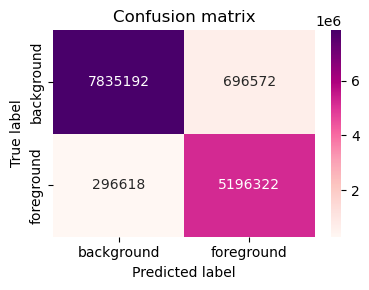

In [50]:
acc, rep, cm = model_segmentation_report(
    unet_plus_drop, test_loader_unet_plus_drop, DEVICE, NUM_CLASES, do_confusion_matrix=True, show_dice_loss=True
)

In [55]:
train_loader_unet_plus_drop, val_loader_unet_plus_drop, test_loader_unet_plus_drop, kaggle_loader_unet_plus_drop = get_seg_dataloaders(
    "data/train",
    batch_size=BATCH_SIZE, num_workers=NUM_WORKERS, seed=SEED, rgb=True,
    train_transform_img=base_img_tf,
    train_transform_mask=base_mask_tf,
    val_transform_img=base_img_tf,
    val_transform_mask=base_mask_tf,  
)

unet_plus_drop = UNetPlusPlus(
    n_channels=3,
    n_classes=1,
    deep_supervision=False,   # o True si querés experimentar
    use_bn=True,
    base_ch=64,
    dropout=0.3
).to(DEVICE)

criterion = combined_loss  # por ejemplo BCE + Dice o Focal Tversky
optimizer_unet_plus_drop = torch.optim.Adam(unet_plus_drop.parameters(), lr=5e-5, weight_decay=1e-5)
scheduler_unet_plus_drop = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer_unet_plus_drop, mode="min", factor=0.5, patience=4)

unet_plus_drop, _, checkpoint = restaurar_modelo(unet_plus_drop, None, "models/unet_plus_drop_3.pth", DEVICE)


epoch_train_errors_unet_plus_drop, epoch_val_errors_unet_plus_drop = train(
    unet_plus_drop, optimizer_unet_plus_drop, criterion, train_loader_unet_plus_drop, val_loader_unet_plus_drop, DEVICE, scheduler=scheduler_unet_plus_drop,
    do_early_stopping=True, patience=15, epochs=40, log_every=5,
    checkpoint_path="models/unet_plus_drop_4.pth", 
    loss_ponderada=True
)

root: data/train
batch_size: 8
batch_size: 8
Epoch: 002 | Train Loss: 0.16329 | Val Loss: 0.15774 | Current LR: 0.0000500000
Epoch: 005 | Train Loss: 0.15998 | Val Loss: 0.15544 | Current LR: 0.0000500000
Epoch: 010 | Train Loss: 0.15342 | Val Loss: 0.14800 | Current LR: 0.0000500000
Epoch: 015 | Train Loss: 0.14157 | Val Loss: 0.14875 | Current LR: 0.0000250000
Epoch: 020 | Train Loss: 0.13992 | Val Loss: 0.14320 | Current LR: 0.0000250000
Epoch: 025 | Train Loss: 0.13159 | Val Loss: 0.14545 | Current LR: 0.0000125000
Epoch: 030 | Train Loss: 0.13060 | Val Loss: 0.14166 | Current LR: 0.0000125000
Epoch: 035 | Train Loss: 0.12484 | Val Loss: 0.13953 | Current LR: 0.0000125000
Epoch: 040 | Train Loss: 0.11987 | Val Loss: 0.14125 | Current LR: 0.0000125000


Accuracy: 0.9399
Dice: 0.9051


Reporte de clasificación:

              precision      recall      f1-score     support        dice    
no-persona       0.96         0.94         0.95       8531764.0              
persona          0.91         0.94         0.92       5492940.0              
accuracy                                   0.94                              
macro avg        0.94         0.94         0.94      14024704.0      0.91    
weighted avg     0.94         0.94         0.94      14024704.0      0.91    
1                                                                    0.91    



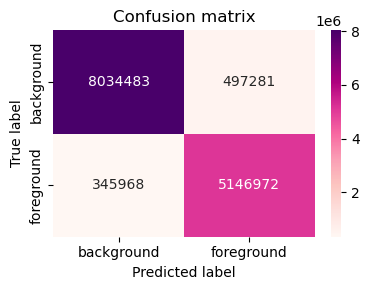

In [56]:
acc, rep, cm = model_segmentation_report(
    unet_plus_drop, test_loader_unet_plus_drop, DEVICE, NUM_CLASES, do_confusion_matrix=True, show_dice_loss=True
)

In [57]:
unet_plus_drop_post = dice_on_val_with_postproc(unet_plus_drop, val_loader_unet_plus_drop, DEVICE, threshold=0.6) # con clean mask v2
print("Dice val con postprocesado:", unet_plus_drop_post)

Dice val con postprocesado: 0.9150019888603705


In [58]:
predict_and_build_submission(unet_plus_drop, DEVICE, kaggle_loader_unet_plus_drop, out_csv="unet_plus_drop_submission", use_post_proc=True)

mask shape: torch.Size([8, 1, 800, 800])
batch shape: 8 range: range(0, 8)
mask shape: torch.Size([8, 1, 800, 800])
batch shape: 8 range: range(0, 8)
mask shape: torch.Size([8, 1, 800, 800])
batch shape: 8 range: range(0, 8)
mask shape: torch.Size([8, 1, 800, 800])
batch shape: 8 range: range(0, 8)
mask shape: torch.Size([8, 1, 800, 800])
batch shape: 8 range: range(0, 8)
mask shape: torch.Size([8, 1, 800, 800])
batch shape: 8 range: range(0, 8)
mask shape: torch.Size([8, 1, 800, 800])
batch shape: 8 range: range(0, 8)
mask shape: torch.Size([8, 1, 800, 800])
batch shape: 8 range: range(0, 8)
mask shape: torch.Size([8, 1, 800, 800])
batch shape: 8 range: range(0, 8)
mask shape: torch.Size([8, 1, 800, 800])
batch shape: 8 range: range(0, 8)
mask shape: torch.Size([8, 1, 800, 800])
batch shape: 8 range: range(0, 8)
mask shape: torch.Size([8, 1, 800, 800])
batch shape: 8 range: range(0, 8)
mask shape: torch.Size([8, 1, 800, 800])
batch shape: 8 range: range(0, 8)
mask shape: torch.Size([8

(           id                                     encoded_pixels
 0    1024.png  182377 4 183175 7 183974 9 184773 10 185573 11...
 1    1025.png  111982 4 112781 5 113581 6 114380 7 115180 8 1...
 2    1027.png  178333 15 179126 27 179922 34 180717 41 181509...
 3    1037.png  137476 8 138273 14 139071 19 139869 24 140667 ...
 4    1038.png  47906 9 48704 24 49503 31 50302 34 51102 37 51...
 ..        ...                                                ...
 529   971.png  107999 2 108798 3 109597 4 110396 5 111194 7 1...
 530   975.png  590 45 1389 47 2189 47 2989 47 3789 47 4588 49...
 531   987.png  472 217 1272 217 2071 218 2871 218 3671 218 44...
 532   995.png  402 160 1202 161 2002 161 2801 162 3601 162 44...
 533   999.png  214291 8 215086 17 215882 24 216678 30 217476 ...
 
 [534 rows x 2 columns],
 'submissions/unet_plus_drop_submission_24-11-2025_12:22.csv')

In [61]:
train_loader_unet_plus_deep, val_loader_unet_plus_deep, test_loader_unet_plus_deep, kaggle_loader_unet_plus_deep = get_seg_dataloaders(
    "data/train",
    batch_size=BATCH_SIZE, num_workers=NUM_WORKERS, seed=SEED, rgb=True,
    train_transform_img=base_img_tf,
    train_transform_mask=base_mask_tf,
    val_transform_img=base_img_tf,
    val_transform_mask=base_mask_tf,  
)

unet_plus_deep = UNetPlusPlus(
    n_channels=3,
    n_classes=1,
    deep_supervision=True,   # o True si querés experimentar
    use_bn=True,
    base_ch=64,
    dropout=0.3
).to(DEVICE)

criterion = combined_loss  # por ejemplo BCE + Dice o Focal Tversky
optimizer_unet_plus_deep = torch.optim.Adam(unet_plus_deep.parameters(), lr=1e-4, weight_decay=1e-5)
scheduler_unet_plus_deep = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer_unet_plus_deep, mode="min", factor=0.5, patience=4)

# unet_plus_deep, _, checkpoint = restaurar_modelo(unet_plus_deep, None, "models/unet_plus_drop_4.pth", DEVICE)


epoch_train_errors_unet_plus_deep, epoch_val_errors_unet_plus_deep = train(
    unet_plus_deep, optimizer_unet_plus_deep, criterion, train_loader_unet_plus_deep, val_loader_unet_plus_deep, DEVICE, scheduler=scheduler_unet_plus_deep,
    do_early_stopping=True, patience=10, epochs=120, log_every=5,
    checkpoint_path="models/unet_plus_deep_4.pth", 
    loss_ponderada=True
)

root: data/train
batch_size: 8
batch_size: 8
Epoch: 002 | Train Loss: 0.47238 | Val Loss: 0.51638 | Current LR: 0.0001000000
Epoch: 005 | Train Loss: 0.42965 | Val Loss: 0.43375 | Current LR: 0.0001000000
Epoch: 010 | Train Loss: 0.36961 | Val Loss: 0.34416 | Current LR: 0.0001000000
Epoch: 015 | Train Loss: 0.33057 | Val Loss: 0.28460 | Current LR: 0.0001000000
Epoch: 020 | Train Loss: 0.30679 | Val Loss: 0.25419 | Current LR: 0.0001000000
Epoch: 025 | Train Loss: 0.27634 | Val Loss: 0.23556 | Current LR: 0.0001000000
Epoch: 030 | Train Loss: 0.25969 | Val Loss: 0.21009 | Current LR: 0.0001000000
Epoch: 035 | Train Loss: 0.24381 | Val Loss: 0.20550 | Current LR: 0.0001000000
Epoch: 040 | Train Loss: 0.23062 | Val Loss: 0.19205 | Current LR: 0.0001000000
Epoch: 045 | Train Loss: 0.21479 | Val Loss: 0.18301 | Current LR: 0.0001000000
Epoch: 050 | Train Loss: 0.20638 | Val Loss: 0.17386 | Current LR: 0.0001000000
Epoch: 055 | Train Loss: 0.19795 | Val Loss: 0.16911 | Current LR: 0.000100

Accuracy: 0.9449
Dice: 0.9103


Reporte de clasificación:

              precision      recall      f1-score     support        dice    
no-persona       0.96         0.95         0.95       8531764.0              
persona          0.92         0.94         0.93       5492940.0              
accuracy                                   0.94                              
macro avg        0.94         0.94         0.94      14024704.0      0.91    
weighted avg     0.95         0.94         0.95      14024704.0      0.91    
1                                                                    0.91    



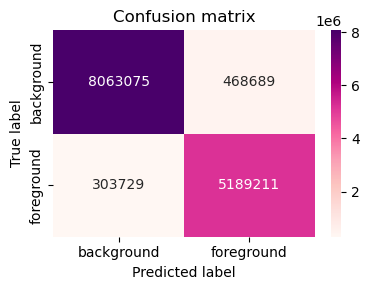

In [64]:
acc, rep, cm = model_segmentation_report(
    unet_plus_deep, test_loader_unet_plus_deep, DEVICE, NUM_CLASES, do_confusion_matrix=True, show_dice_loss=True
)

In [76]:
predict_and_build_submission_tta(
   model=unet_plus_deep,
   device=DEVICE,
   data_loader=kaggle_loader_unet_plus_deep,
   out_csv="unet_plus_deep_tta",
   threshold=0.4,
   use_post_proc=True,
   min_size=5000,
)

submission TTA guardado como: submissions/unet_plus_deep_tta_25-11-2025_08:54.csv


(           id                                     encoded_pixels
 0    1024.png  199995 3 200780 21 201580 21 202379 22 203179 ...
 1    1025.png  131184 3 131984 3 132783 5 133583 6 134383 7 1...
 2    1027.png  176737 12 177530 23 178325 32 179120 39 179915...
 3    1037.png  137475 8 138271 16 139069 23 139867 41 140665 ...
 4    1038.png  41505 5 42302 11 43101 14 43899 18 43927 11 44...
 ..        ...                                                ...
 529   971.png  19191 10 19989 12 20788 13 21587 14 22386 15 2...
 530   975.png  587 54 1386 55 2186 55 2986 55 3786 56 4585 56...
 531   987.png  471 209 1270 210 2070 210 2870 211 3670 211 44...
 532   995.png  353 3 376 382 1152 5 1176 382 1952 5 1976 382 ...
 533   999.png  212688 15 213484 22 214281 27 215079 30 215876...
 
 [534 rows x 2 columns],
 'submissions/unet_plus_deep_tta_25-11-2025_08:54.csv')

In [62]:
train_loader_unet_plus_deep_2, val_loader_unet_plus_deep_2, test_loader_unet_plus_deep_2, kaggle_loader_unet_plus_deep_2 = get_seg_dataloaders(
    "data/train",
    batch_size=BATCH_SIZE, num_workers=NUM_WORKERS, seed=SEED, rgb=True,
    train_transform_img=base_img_tf,
    train_transform_mask=base_mask_tf,
    val_transform_img=base_img_tf,
    val_transform_mask=base_mask_tf,  
)

unet_plus_deep_2 = UNetPlusPlus(
    n_channels=3,
    n_classes=1,
    deep_supervision=True,   # o True si querés experimentar
    use_bn=True,
    base_ch=64,
    dropout=0.3
).to(DEVICE)

criterion = combined_loss  # por ejemplo BCE + Dice o Focal Tversky
optimizer_unet_plus_deep_2 = torch.optim.Adam(unet_plus_deep_2.parameters(), lr=0.0000200000)
scheduler_unet_plus_deep_2 = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer_unet_plus_deep_2, mode="min", factor=0.5, patience=4)

unet_plus_deep_2, _, checkpoint = restaurar_modelo(unet_plus_deep_2, None, "models/unet_plus_deep_4.pth", DEVICE)


epoch_train_errors_unet_plus_deep_2, epoch_val_errors_unet_plus_deep_2 = train(
    unet_plus_deep_2, optimizer_unet_plus_deep_2, criterion, train_loader_unet_plus_deep_2, val_loader_unet_plus_deep_2, DEVICE, scheduler=scheduler_unet_plus_deep_2,
    do_early_stopping=True, patience=10, epochs=40, log_every=5,
    checkpoint_path="models/unet_plus_deep_2_4.pth", 
    loss_ponderada=True
)

root: data/train
batch_size: 8


batch_size: 8
Epoch: 002 | Train Loss: 0.11214 | Val Loss: 0.13483 | Current LR: 0.0000200000
Epoch: 005 | Train Loss: 0.11464 | Val Loss: 0.13250 | Current LR: 0.0000200000
Epoch: 010 | Train Loss: 0.10523 | Val Loss: 0.12929 | Current LR: 0.0000100000
Epoch: 015 | Train Loss: 0.10443 | Val Loss: 0.12929 | Current LR: 0.0000050000
Epoch: 020 | Train Loss: 0.10323 | Val Loss: 0.12943 | Current LR: 0.0000050000
Epoch: 025 | Train Loss: 0.10276 | Val Loss: 0.12855 | Current LR: 0.0000025000
Epoch: 030 | Train Loss: 0.10085 | Val Loss: 0.13134 | Current LR: 0.0000025000
Epoch: 035 | Train Loss: 0.10234 | Val Loss: 0.12929 | Current LR: 0.0000012500
Epoch: 040 | Train Loss: 0.10239 | Val Loss: 0.13099 | Current LR: 0.0000006250


Accuracy: 0.9420
Dice: 0.9065


Reporte de clasificación:

              precision      recall      f1-score     support        dice    
no-persona       0.97         0.93         0.95       8531764.0              
persona           0.9         0.96         0.93       5492940.0              
accuracy                                   0.94                              
macro avg        0.94         0.94         0.94      14024704.0      0.91    
weighted avg     0.94         0.94         0.94      14024704.0      0.91    
1                                                                    0.91    



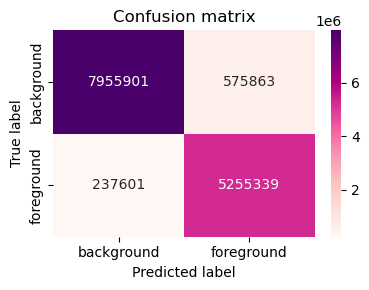

In [63]:
acc, rep, cm = model_segmentation_report(
    unet_plus_deep_2, test_loader_unet_plus_deep_2, DEVICE, NUM_CLASES, do_confusion_matrix=True, show_dice_loss=True
)

In [ ]:
predict_and_build_submission(unet_plus_drop, DEVICE, kaggle_loader_unet_plus_drop, out_csv="unet_plus_drop_submission", use_post_proc=True)

In [80]:
train_loader_unet_deep, val_loader_unet_deep, test_loader_unet_deep, kaggle_loader_unet_deep = get_seg_dataloaders(
    "data/train",
    batch_size=BATCH_SIZE, num_workers=NUM_WORKERS, seed=SEED, rgb=True,
    train_transform_img=base_img_tf,
    train_transform_mask=base_mask_tf,
    val_transform_img=base_img_tf,
    val_transform_mask=base_mask_tf,  
)

unet_deep = DeepUNet(n_class=1, n_channels=3, padding=1, use_bn=True, dropout=0.3).to(DEVICE)

criterion = combined_loss  # por ejemplo BCE + Dice o Focal Tversky
optimizer_unet_deep = torch.optim.Adam(unet_deep.parameters(), lr=1e-4, weight_decay=1e-5)
scheduler_unet_deep = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer_unet_deep, mode="min", factor=0.5, patience=4)



epoch_train_errors_unet_deep, epoch_val_errors_unet_deep = train(
    unet_deep, optimizer_unet_deep, criterion, train_loader_unet_deep, val_loader_unet_deep, DEVICE, scheduler=scheduler_unet_deep,
    do_early_stopping=True, patience=10, epochs=40, log_every=5,
    checkpoint_path="models/unet_deep_4.pth", 
    loss_ponderada=True
)

root: data/train
batch_size: 8
batch_size: 8
Epoch: 002 | Train Loss: 0.43981 | Val Loss: 0.44406 | Current LR: 0.0001000000
Epoch: 005 | Train Loss: 0.39258 | Val Loss: 0.39451 | Current LR: 0.0001000000


KeyboardInterrupt: 